In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import sunpy
import sunpy.map
from sunpy.coordinates import (get_earth, get_horizons_coord,
                                Helioprojective, propagate_with_solar_surface,
                                HeliocentricEarthEcliptic, get_body_heliographic_stonyhurst)
import sunkit_image
import sunkit_image.coalignment as coalignment
import astropy
from astropy.coordinates import SkyCoord
from astropy.wcs import WCS
import astropy.units as u
import astropy.constants as const
from astropy.io import fits
from astropy.time import Time
import eispac
import irispy.io
import pyvista as pv
import h5py
from scipy.interpolate import LinearNDInterpolator
from scipy.io import readsav

import cmcrameri.cm as cmcm
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.ticker import (AutoLocator, AutoMinorLocator, 
    FixedLocator, FixedFormatter, LogLocator, StrMethodFormatter)
from ipywidgets import interactive, widgets
from IPython.display import display, clear_output
from astropy.visualization import (AsinhStretch, LinearStretch,
        LogStretch, ImageNormalize,PowerStretch)
import os
from sun_blinker import SunBlinker
from copy import deepcopy   


/tmp/ipykernel_173072/2196458997.py:21: UserWarning: could not determine irispy package version; this indicates a broken installation
  import irispy.io


This notebook describes the coalignment of SDO/AIA, SDO/HMI, SolO/EUI HRI&FSI, SolO/PHI, and Hinode/EIS in the following way:


(All times are in local UTC)

### Alert
It would be also good to mention that in Sunpy, AIA maps have a rsun_ref = 696 Mm which is slightly different 
from the default values of 695.7 Mm used in other maps, e.g., EUI maps. Usually this would cause a tiny difference in the reprojection.
However, in some cases, the reprojection might completely fail due to the mismatch of rsun_ref. Therefore, in this notebook and 
repository, we unify the rsun_ref to the AIA value of 696.0 Mm.  

<img src="../../figs/mindmaps/SolO_SDO_Hinode_DKIST_1024.png" width="1200">

In [2]:
def plot_colorbar(im, ax, width="3%", height="100%",loc="lower left",fontsize=14,
                  bbox_to_anchor=(1.02, 0., 1, 1),orientation="vertical"):
    clb_ax = inset_axes(ax,width=width,height=height,loc=loc,
                bbox_to_anchor=bbox_to_anchor,
                 bbox_transform=ax.transAxes,
                 borderpad=0)
    clb = plt.colorbar(im,pad = 0.05,orientation=orientation,ax=ax,cax=clb_ax)
    clb_ax.yaxis.set_minor_locator(AutoMinorLocator(5))
    clb_ax.yaxis.get_offset_text().set_fontsize(fontsize)
    clb_ax.tick_params(labelsize=fontsize)
    return clb, clb_ax

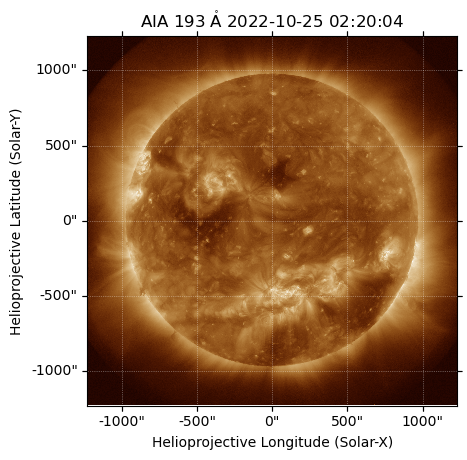

In [3]:
aia_193_map_eis = sunpy.map.Map("../../src/AIA/20221025/193/lvl15/aia.lev1_euv_12s.2022-10-25T022003Z.193.image.fits")
aia_193_map_eis.plot()

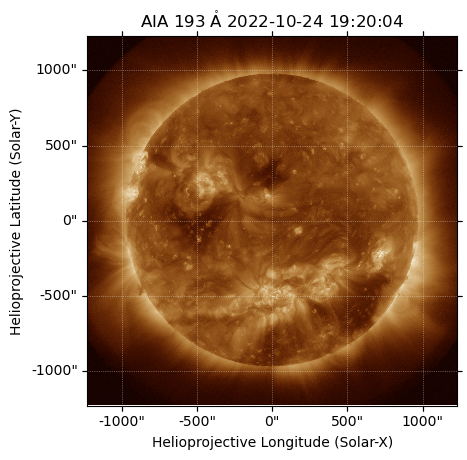

In [4]:
aia_193_map = sunpy.map.Map("../../src/AIA/20221024/193/lvl15/aia.lev1_euv_12s.2022-10-24T192003Z.193.image.fits")
aia_193_map.plot()

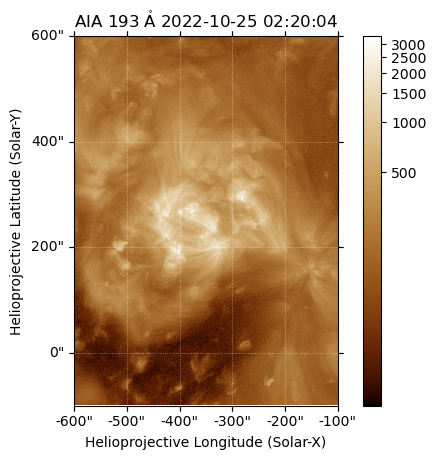

In [5]:
aia_193_map_eis_crop = aia_193_map_eis.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_193_map_eis.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_193_map_eis.coordinate_frame))
aia_193_map_eis_crop.plot()
plt.colorbar()

In [6]:
aia_193_map_eis_hh = sunpy.map.Map("../../src/AIA/20221024/193/lvl15/aia.lev1_euv_12s.2022-10-24T193851Z.193.image.fits")
aia_193_map_eis_hh_crop = aia_193_map_eis_hh.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_193_map_eis_hh.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_193_map_eis_hh.coordinate_frame))

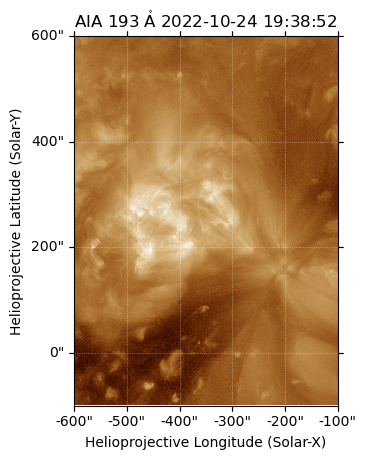

In [7]:
aia_193_map_eis_hh_crop.plot()

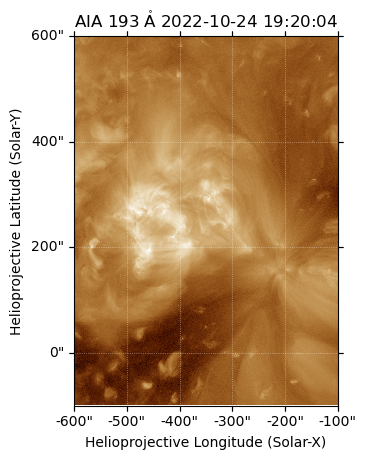

In [8]:
aia_193_map_crop = aia_193_map.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_193_map.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_193_map.coordinate_frame))
aia_193_map_crop.plot()

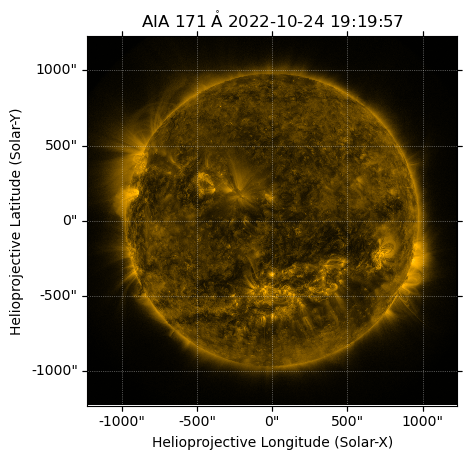

In [9]:
aia_171_map = sunpy.map.Map("../../src/AIA/20221024/171/lvl15/aia.lev1_euv_12s.2022-10-24T192003Z.171.image.fits")
aia_171_map.plot()

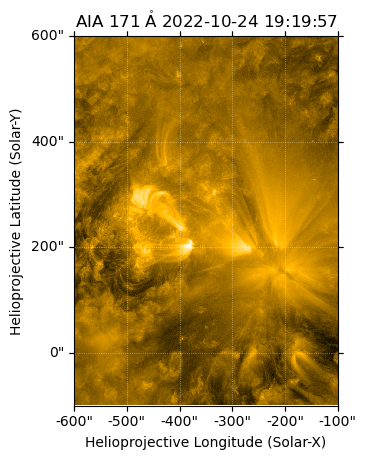

In [10]:
aia_171_map_crop = aia_171_map.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_171_map.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_171_map.coordinate_frame))
aia_171_map_crop.plot()

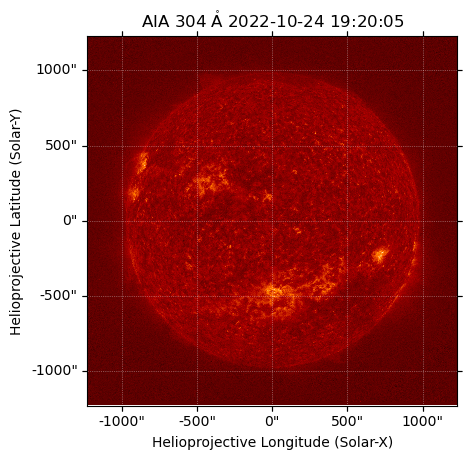

In [11]:
aia_304_map = sunpy.map.Map("../../src/AIA/20221024/304/lvl15/aia.lev1_euv_12s.2022-10-24T192003Z.304.image.fits")
aia_304_map.plot()

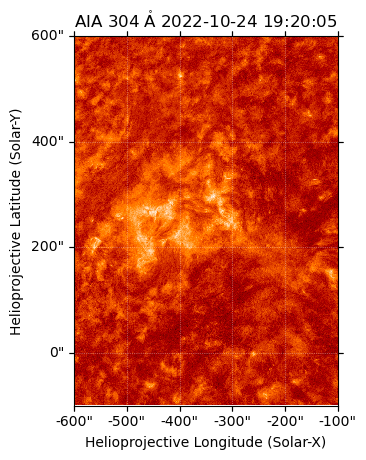

In [12]:
aia_304_map_crop = aia_304_map.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_304_map.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_304_map.coordinate_frame))
aia_304_map_crop.plot()

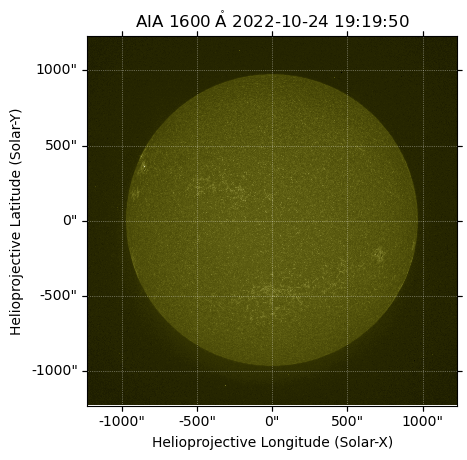

In [13]:
aia_1600_map = sunpy.map.Map("../../src/AIA/20221024/1600/lvl15/aia.lev1_uv_24s.2022-10-24T191951Z.1600.image.fits")
aia_1600_map.plot()

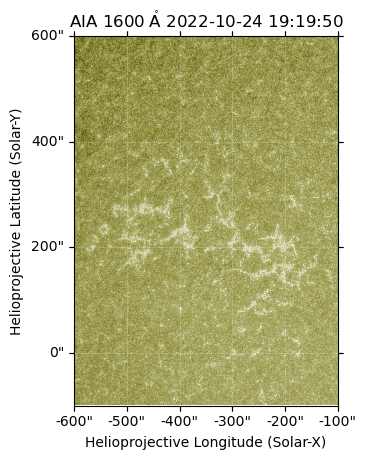

In [14]:
aia_1600_map_crop = aia_1600_map.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_1600_map.coordinate_frame), 
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_1600_map.coordinate_frame))
aia_1600_map_crop.plot()

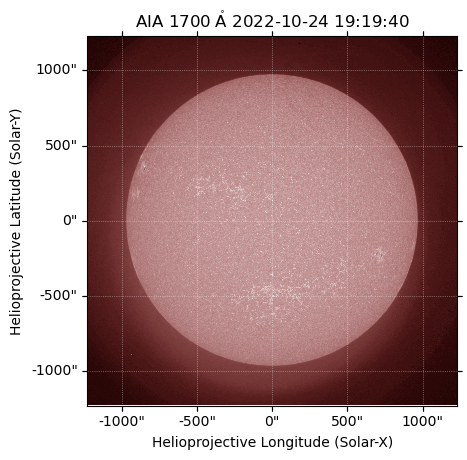

In [15]:
aia_1700_map = sunpy.map.Map("../../src/AIA/20221024/1700/lvl15/aia.lev1_uv_24s.2022-10-24T191951Z.1700.image.fits")
aia_1700_map.plot()

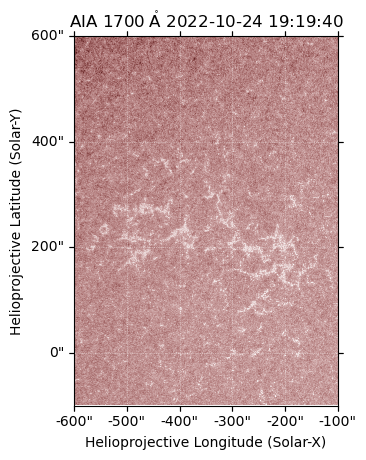

In [16]:
aia_1700_map_crop = aia_1700_map.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_1700_map.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_1700_map.coordinate_frame))
aia_1700_map_crop.plot()

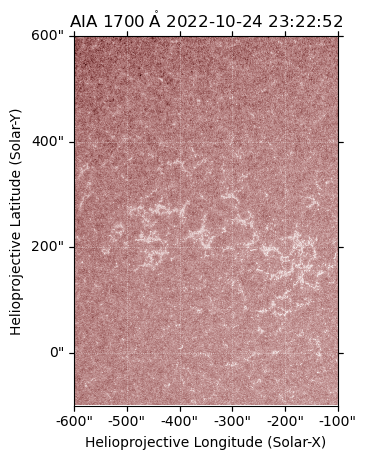

In [17]:
aia_1700_map_2322 = sunpy.map.Map("../../src/AIA/20221024/1700/lvl15/aia.lev1_uv_24s.2022-10-24T232303Z.1700.image.fits")
aia_1700_map_2322_crop = aia_1700_map_2322.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_1700_map_2322.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_1700_map_2322.coordinate_frame))
aia_1700_map_2322_crop.plot()

In [18]:
SunBlinker(aia_193_map_crop,aia_171_map_crop)

In [19]:
iris_1400_sji_cube = irispy.io.read_files("../../src/IRIS/20221024/1949/iris_l2_20221024_194939_3600109162_SJI_1400_t000.fits",memmap=True)

For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs
 [sunpy.map.mapbase]


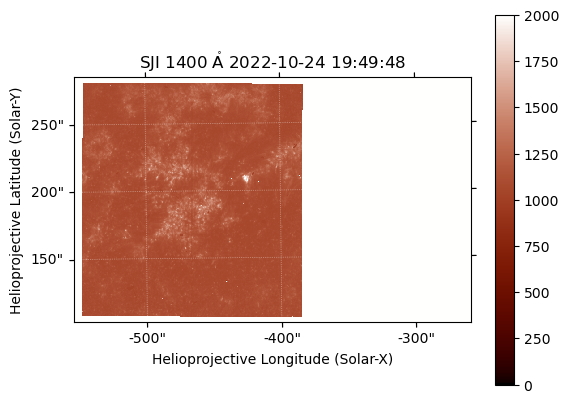

In [20]:
iris_1400_sji_cut = iris_1400_sji_cube[0]
iris_1400_sji_map = sunpy.map.Map(iris_1400_sji_cut.data+3.3e4,iris_1400_sji_cut.meta)
iris_1400_sji_map.meta["rsun_ref"] = aia_1700_map.meta["rsun_ref"]
iris_1400_sji_map.plot_settings['norm'] = ImageNormalize(vmin=0,vmax=2e3)
iris_1400_sji_map.plot()
plt.colorbar()

In [21]:
iris_1400_sji_2322_cube = irispy.io.read_files("../../src/IRIS/20221024/2322/iris_l2_20221024_232249_3600609177_SJI_1400_t000.fits",memmap=True)

For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs
 [sunpy.map.mapbase]


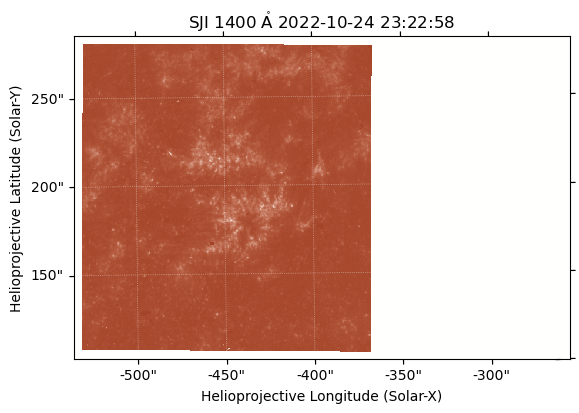

In [22]:
iris_1400_sji_2322_cut = iris_1400_sji_2322_cube[0]
iris_1400_sji_2322_map = sunpy.map.Map(iris_1400_sji_2322_cut.data+3.3e4,iris_1400_sji_2322_cut.meta)
iris_1400_sji_2322_map.meta["rsun_ref"] = aia_1700_map.meta["rsun_ref"]
iris_1400_sji_2322_map.plot_settings['norm'] = ImageNormalize(vmin=0,vmax=2e3)
iris_1400_sji_2322_map.plot()

In [23]:
def coalign_shift(big_map, small_map):
    yshift, xshift = coalignment._calculate_shift(big_map.data, small_map.data)
    reference_coord = big_map.pixel_to_world(xshift, yshift)
    Txshift = reference_coord.Tx - small_map.bottom_left_coord.Tx
    Tyshift = reference_coord.Ty - small_map.bottom_left_coord.Ty

    return Txshift, Tyshift
    

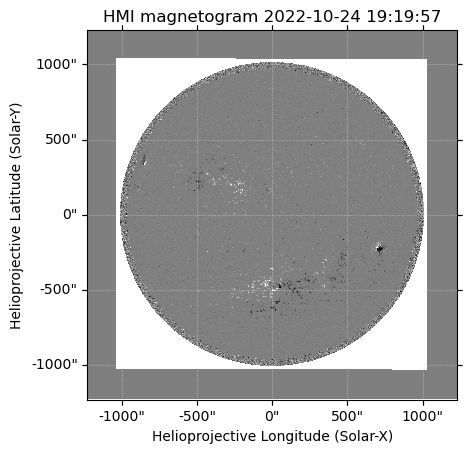

In [24]:
hmi_los_map = sunpy.map.Map("../../src/HMI/20221024/lvl15/hmi.M_45s.20221024_192100_TAI.2.magnetogram.fits")
hmi_los_map.plot_settings['norm'] = plt.Normalize(-500, 500)
hmi_los_map.plot()

In [25]:
hmi_los_map_to_aia = hmi_los_map.reproject_to(aia_193_map.wcs)

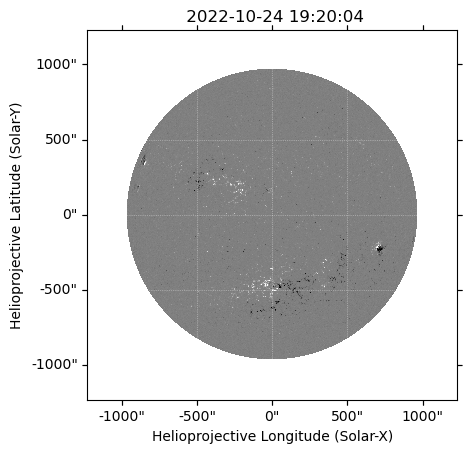

In [26]:
hmi_los_map_to_aia.plot()

In [27]:
hmi_los_map_to_aia_crop = hmi_los_map_to_aia.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=hmi_los_map_to_aia.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=hmi_los_map_to_aia.coordinate_frame))

In [28]:
SunBlinker(aia_1600_map_crop,hmi_los_map_to_aia_crop)

In [29]:
with fits.open("../../src/SOTSP/20221024/lvl2/20221024_184138.fits") as hdul:
    sotsp_header = deepcopy(hdul[0].header)
    # for keys in hdul[1].header.keys():
    #     sotsp_header[keys] = hdul[1].header[keys]
    sotsp_header['CUNIT1'] = 'arcsec'
    sotsp_header['CUNIT2'] = 'arcsec'
    sotsp_header['CTYPE1'] = 'HPLN-TAN'
    sotsp_header['CTYPE2'] = 'HPLT-TAN'
    sotsp_header['CRVAL1'] = sotsp_header['XCEN']
    sotsp_header['CRVAL2'] = sotsp_header['YCEN']
    sotsp_header['CDELT1'] = 0.297 #from Fouhey et al. 2022
    sotsp_header['CDELT2'] = 0.320
    sotsp_header['NAXIS'] = 2
    # sotsp_header['RSUN_REF'] = sotsp_header['SOLAR_RA']
    # sotsp_header['DATE-OBS'] = sotsp_header['TSTART']
    # sotsp_header["DATE-END"] = sotsp_header['TEND']
    sotsp_header["DATE-AVG"] = (Time(sotsp_header["TSTART"]) + \
                                (Time(sotsp_header["TEND"]) - Time(sotsp_header["TSTART"]))/2).strftime("%Y-%m-%dT%H:%M:%S")
    
# with fits.open("../../src/SOTSP/20221024/lvl2/sotsp_l2_20221024_190447_3643101203_20221024_184138_magfield_index.fits") as hdul:
#     lsmal_header = deepcopy(hdul[0].header)
#     sotsp_header["PC1_1"] = lsmal_header["PC1_1"]
#     sotsp_header["PC1_2"] = lsmal_header["PC1_2"]
#     sotsp_header["PC2_1"] = lsmal_header["PC2_1"]
#     sotsp_header["PC2_2"] = lsmal_header["PC2_2"]

sotsp_corr_file = readsav("../../src/SOTSP/20221024/lvl2/sotsp_lvl2_missing_col_corrected.sav")
sotsp_btot = deepcopy(sotsp_corr_file['data_new'][0,:,:])
sotsp_btot[~np.isfinite(sotsp_btot)] = 0


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs,dsun_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs,dsun_obs
 [sunpy.map.mapbase]
For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs,dsun_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs,dsun_obs
 [sunpy.map.mapbase]


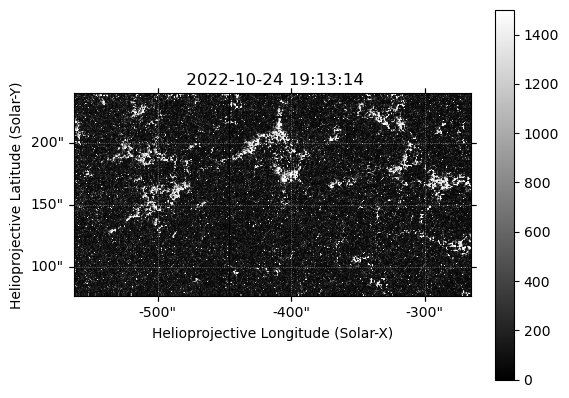

In [30]:
sotsp_btot_map = sunpy.map.Map(sotsp_btot,sotsp_header).rotate()
sotsp_btot_map.meta["rsun_ref"] = aia_1600_map.meta["rsun_ref"]
sotsp_btot_map.plot_settings['cmap'] = "gray"
sotsp_btot_map.plot_settings['norm'] = plt.Normalize(0, 1500)
sotsp_btot_map.plot()
plt.colorbar()

In [31]:
sotsp_resample_nx = (sotsp_btot_map.scale.axis1 * sotsp_btot_map.dimensions.x) / hmi_los_map_to_aia_crop.scale.axis1.to(u.arcsec/u.pix)
sotsp_resample_ny = (sotsp_btot_map.scale.axis2 * sotsp_btot_map.dimensions.y) / hmi_los_map_to_aia_crop.scale.axis2.to(u.arcsec/u.pix)
sotsp_btot_map_resample = sotsp_btot_map.resample(u.Quantity([sotsp_resample_nx, sotsp_resample_ny])).submap([10,20]*u.pix,
                                                top_right=[480,272]*u.pix)
sotsp_btot_map_resample_data = sotsp_btot_map_resample.data.copy()
sotsp_btot_map_resample_data[~np.isfinite(sotsp_btot_map_resample_data)] = 0
sotsp_btot_map_resample = sunpy.map.Map(sotsp_btot_map_resample_data,sotsp_btot_map_resample.meta)
hmi_los_map_to_aia_crop_abs = sunpy.map.Map(np.abs(hmi_los_map_to_aia_crop.data),hmi_los_map_to_aia_crop.meta)

In [32]:
Txshift_sotsp_hmi, Tyshift_sotsp_hmi = coalign_shift(hmi_los_map_to_aia_crop_abs, sotsp_btot_map_resample)
print(Txshift_sotsp_hmi, Tyshift_sotsp_hmi)

18.7189 arcsec 26.8655 arcsec


For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs,dsun_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs,dsun_obs
 [sunpy.map.mapbase]


In [33]:
sotsp_btot_map_shift = sotsp_btot_map.shift_reference_coord(Txshift_sotsp_hmi,Tyshift_sotsp_hmi)

For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs,dsun_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs,dsun_obs
 [sunpy.map.mapbase]


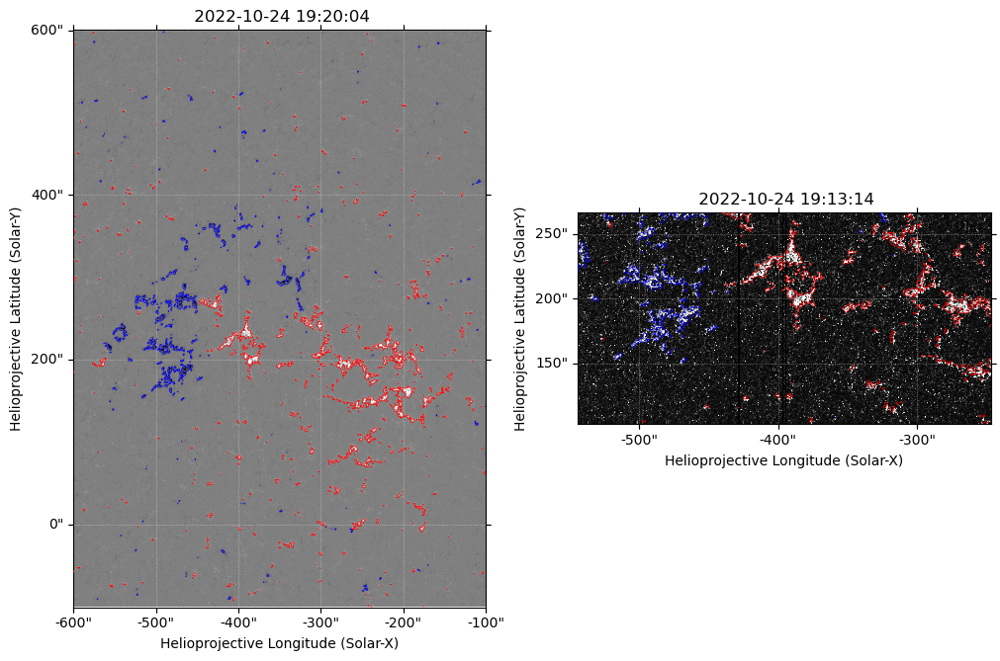

In [34]:
fig = plt.figure(figsize=(10,10),constrained_layout=True)
ax1 = fig.add_subplot(121,projection=hmi_los_map_to_aia_crop)
hmi_los_map_to_aia_crop.plot(axes=ax1)

ax2 = fig.add_subplot(122,projection=sotsp_btot_map_shift)
sotsp_btot_map_shift.plot(axes=ax2)

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_to_aia_crop.draw_contours(levels=[-100,100],axes=ax_,colors=["b","r"],linewidths=0.5)
    ax_.axis(bounds)

plt.savefig("../../figs/test_figs/sotsp_hmi_coalign.png",dpi=300)

In [35]:
with sunpy.coordinates.Helioprojective.assume_spherical_screen(sotsp_btot_map_shift.observer_coordinate):
    hmi_los_map_to_aia_crop_repro_tosp = hmi_los_map_to_aia_crop.reproject_to(sotsp_btot_map_shift.wcs)

In [36]:
SunBlinker(sotsp_btot_map_shift,hmi_los_map_to_aia_crop_repro_tosp)

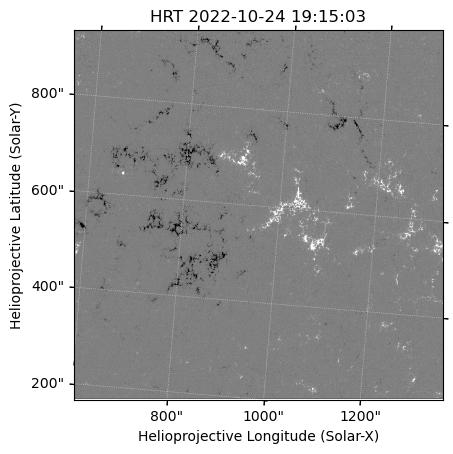

In [37]:
phi_los_map = sunpy.map.Map("../../src/PHI/20221024/solo_L2_phi-hrt-blos_20221024T191503_V01.fits")
phi_los_map.meta["rsun_ref"] = aia_1600_map.meta["rsun_ref"]
phi_los_map.plot_settings['norm'] = plt.Normalize(-500, 500)
phi_los_map.plot()

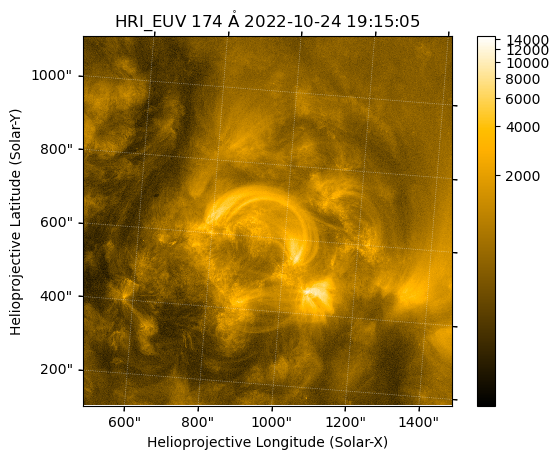

In [38]:
hri_174_map = sunpy.map.Map("../../src/EUI/HRI/euv174/20221024/solo_L2_eui-hrieuv174-image_20221024T191505172_V01.fits")
hri_174_map.meta["rsun_ref"] = aia_1600_map.meta["rsun_ref"]
hri_174_map.plot()
plt.colorbar()

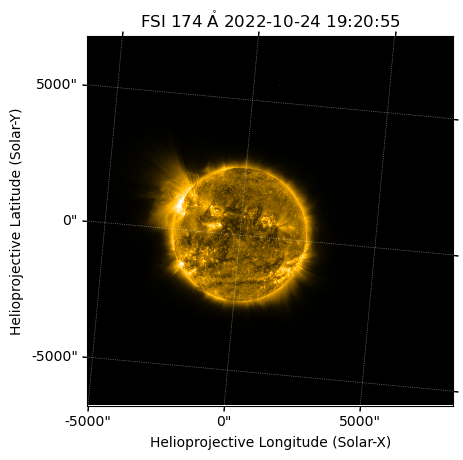

In [39]:
fsi_174_map = sunpy.map.Map("../../src/EUI/FSI/euv174/20221024/solo_L2_eui-fsi174-image_20221024T192050179_V01.fits")
fsi_174_map.meta["rsun_ref"] = aia_1600_map.meta["rsun_ref"]
fsi_174_map.plot()

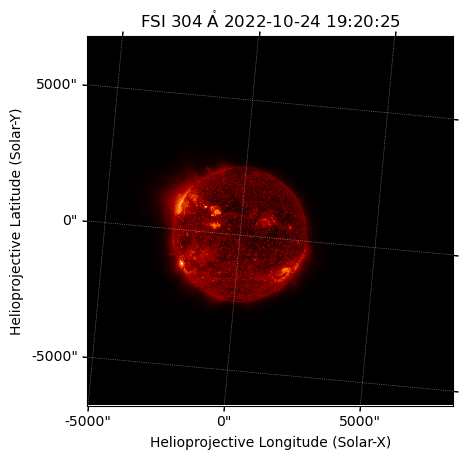

In [40]:
fsi_304_map = sunpy.map.Map("../../src/EUI/FSI/euv304/20221024/solo_L2_eui-fsi304-image_20221024T192020179_V01.fits")
fsi_304_map.meta["rsun_ref"] = aia_1600_map.meta["rsun_ref"]
fsi_304_map.plot()

Reading fit result from, 
   ../../src/EIS/DHB_007_v2/20221025T0023/eis_20221025_014811.fe_12_195_119.1c-0.fit.h5
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]


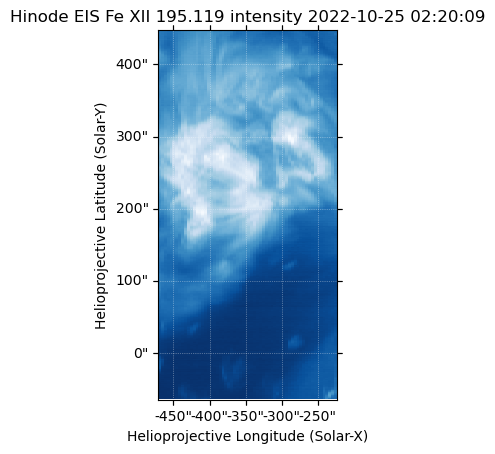

In [41]:
eis_195_fitres = eispac.read_fit("../../src/EIS/DHB_007_v2/20221025T0023/eis_20221025_014811.fe_12_195_119.1c-0.fit.h5")
eis_195_intmap = eis_195_fitres.get_map(component=0,measurement="intensity")
eis_195_intmap.meta["rsun_ref"] = aia_1600_map.meta["rsun_ref"]
eis_195_intmap.plot()

In [42]:
aia_resample_nx = (aia_193_map_eis_crop.scale.axis1 * aia_193_map_eis_crop.dimensions.x) / eis_195_intmap.scale.axis1
aia_resample_ny = (aia_193_map_eis_crop.scale.axis2 * aia_193_map_eis_crop.dimensions.y) / eis_195_intmap.scale.axis2
aia_193_map_resample = aia_193_map_eis_crop.resample(u.Quantity([aia_resample_nx, aia_resample_ny]))

In [43]:
eis_to_aia_Txshift, eis_to_aia_Tyshift = coalign_shift(aia_193_map_resample,eis_195_intmap)
print(eis_to_aia_Txshift)
print(eis_to_aia_Tyshift)
eis_195_intmap_shift = eis_195_intmap.shift_reference_coord(eis_to_aia_Txshift,eis_to_aia_Tyshift)

3.90053 arcsec
-3.19133 arcsec


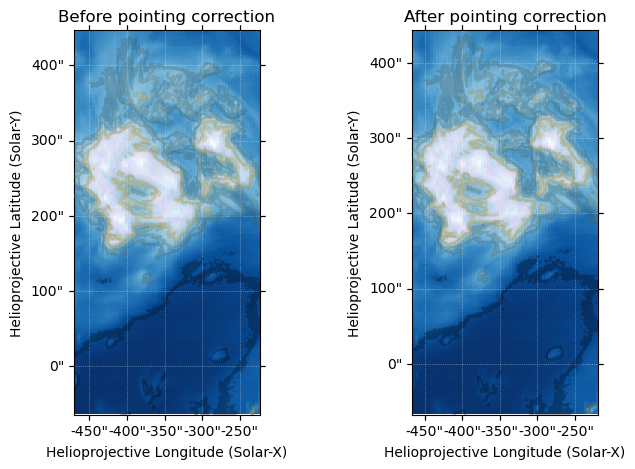

In [44]:
fig = plt.figure(figsize=(8,5))
ax1 = fig.add_subplot(121,projection=eis_195_intmap)
eis_195_intmap.plot(axes=ax1, title='Before pointing correction')

ax2 = fig.add_subplot(122,projection=eis_195_intmap_shift)
eis_195_intmap_shift.plot(axes=ax2, title='After pointing correction')

aia_levels = [100, 400, 500, 700, 800, 1200] * aia_193_map_eis_crop.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_193_map_eis_crop.draw_contours(aia_levels, axes=ax_, cmap=cmcm.batlowK, alpha=0.3)
    ax_.axis(bounds)

Reading fit result from, 
   ../../src/EIS/HH_Flare/20221024T1808/fitres/eis_20221024_193612.fe_12_195_119.1c-0.fit.h5
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]


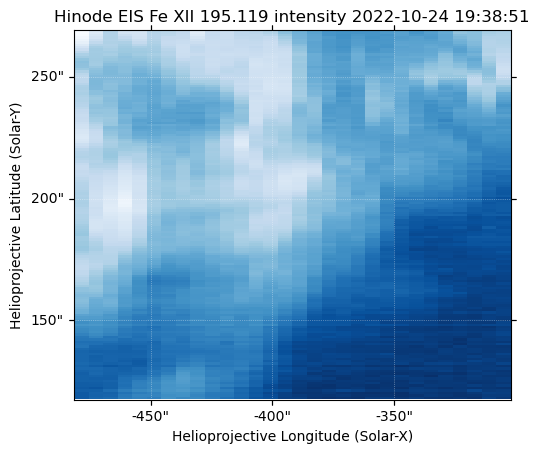

In [45]:
eis_hhflare_195_fitres = eispac.read_fit("../../src/EIS/HH_Flare/20221024T1808/fitres/eis_20221024_193612.fe_12_195_119.1c-0.fit.h5")
eis_hhflare_195_intmap = eis_hhflare_195_fitres.get_map(component=0,measurement="intensity")
eis_hhflare_195_intmap.meta["rsun_ref"] = aia_1600_map.meta["rsun_ref"]
eis_hhflare_195_velmap = eis_hhflare_195_fitres.get_map(component=0,measurement="velocity")
eis_hhflare_195_velmap.meta["rsun_ref"] = aia_1600_map.meta["rsun_ref"]
eis_hhflare_195_intmap.plot()

In [46]:
aia_resampe_hhflare_nx = (aia_193_map_eis_hh_crop.scale.axis1 * aia_193_map_eis_hh_crop.dimensions.x) / eis_hhflare_195_intmap.scale.axis1
aia_resampe_hhflare_ny = (aia_193_map_eis_hh_crop.scale.axis2 * aia_193_map_eis_hh_crop.dimensions.y) / eis_hhflare_195_intmap.scale.axis2
aia_193_map_eis_hh_resample = aia_193_map_eis_hh_crop.resample(u.Quantity([aia_resampe_hhflare_nx, aia_resampe_hhflare_ny]))
hh_eis_to_aia_Txshift, hh_eis_to_aia_Tyshift = coalign_shift(aia_193_map_eis_hh_resample,eis_hhflare_195_intmap)
hh_eis_to_aia_Txshift, hh_eis_to_aia_Tyshift

(<Angle 2.82237415 arcsec>, <Angle -4.95564851 arcsec>)

In [47]:
eis_hhflare_195_intmap_shift = eis_hhflare_195_intmap.shift_reference_coord(hh_eis_to_aia_Txshift,hh_eis_to_aia_Tyshift)
eis_hhflare_195_velmap_shift = eis_hhflare_195_velmap.shift_reference_coord(hh_eis_to_aia_Txshift,hh_eis_to_aia_Tyshift)    

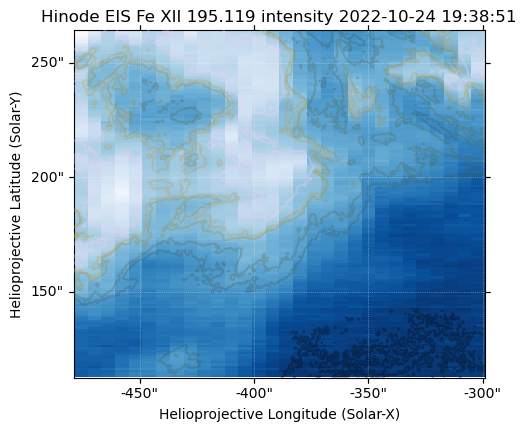

In [48]:
fig = plt.figure(figsize=(5,5),constrained_layout=True)

ax1 = fig.add_subplot(111,projection=eis_hhflare_195_intmap_shift)
eis_hhflare_195_intmap_shift.plot(axes=ax1)

aia_levels = [100, 400, 500, 700, 800, 1200] * aia_193_map_eis_crop.unit

bounds = ax1.axis() 
aia_193_map_eis_hh_crop.draw_contours(aia_levels, axes=ax1, cmap=cmcm.batlowK, alpha=0.3)
bounds = ax1.axis(bounds)

In [49]:
with propagate_with_solar_surface():
    aia_193_map_eis_derot = aia_193_map_eis.reproject_to(aia_193_map.wcs)

In [50]:
aia_193_map_eis_compare = aia_193_map_eis_derot.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_193_map_eis_derot.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_193_map_eis_derot.coordinate_frame))

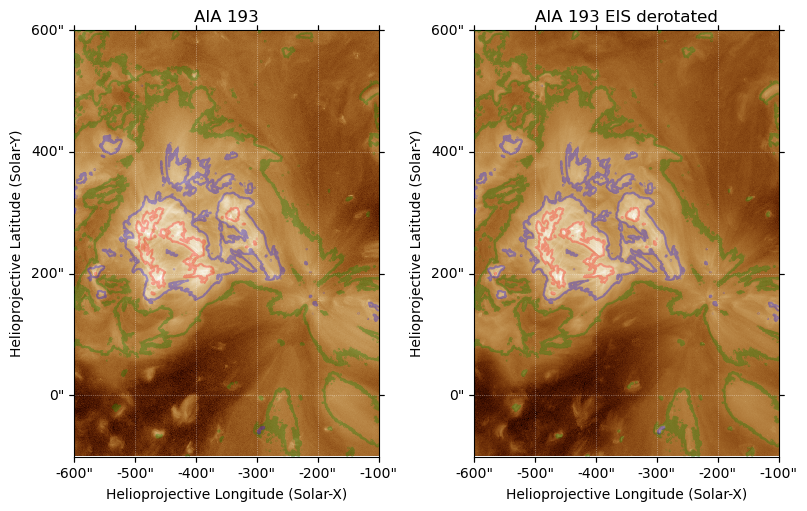

In [51]:
fig = plt.figure(figsize=(8,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_map_crop)
aia_193_map_crop.plot(axes=ax1, title='AIA 193')

ax2 = fig.add_subplot(122,projection=aia_193_map_eis_compare)
aia_193_map_eis_compare.plot(axes=ax2, title='AIA 193 EIS derotated')

aia_levels = [200, 500, 1200] 

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_193_map_eis_compare.draw_contours(aia_levels, axes=ax_, colors=["g","b","r"], alpha=0.3)
    ax_.axis(bounds)

In [52]:
SunBlinker(aia_193_map_crop,aia_193_map_eis_compare)

In [53]:
def derotate_fsi(fsi_map, hri_map,algorithm="adaptive"):
    out_frame = hri_map.coordinate_frame
    out_center = SkyCoord(0*u.arcsec, 0*u.arcsec, frame=out_frame)
    header = sunpy.map.make_fitswcs_header(fsi_map.data.shape,
                                        out_center,
                                        scale=u.Quantity(fsi_map.scale),
                                        rotation_matrix=hri_map.rotation_matrix) 
    # correct the tiny rotation matrix difference between FSI and HRI, which simply the coalignment
    out_wcs = WCS(header)

    with propagate_with_solar_surface():
        fsi_map_derot = fsi_map.reproject_to(out_wcs,algorithm=algorithm)

    return fsi_map_derot


In [54]:
fsi_174_map_hri_time = derotate_fsi(fsi_174_map,hri_174_map)

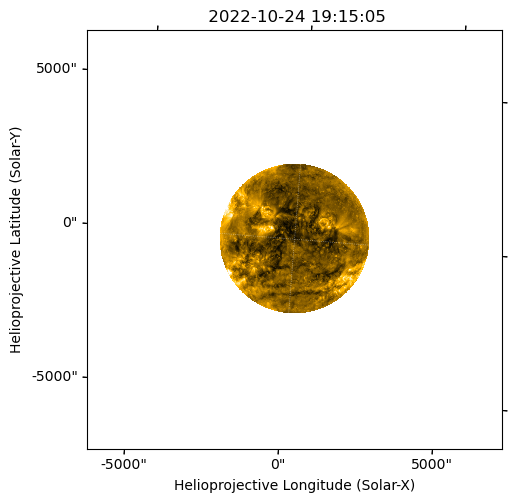

In [55]:
fig = plt.figure(figsize=(5,5),constrained_layout=True)

ax1 = fig.add_subplot(111,projection=fsi_174_map_hri_time)
fsi_174_map_hri_time.plot()

In [56]:
fsi_174_crop = fsi_174_map_hri_time.submap(SkyCoord(500*u.arcsec,0*u.arcsec,frame=fsi_174_map_hri_time.coordinate_frame),
                                    top_right=SkyCoord(2000*u.arcsec,1250*u.arcsec,frame=fsi_174_map_hri_time.coordinate_frame))

In [57]:
hri_174_map_repro = hri_174_map.reproject_to(fsi_174_crop.wcs)

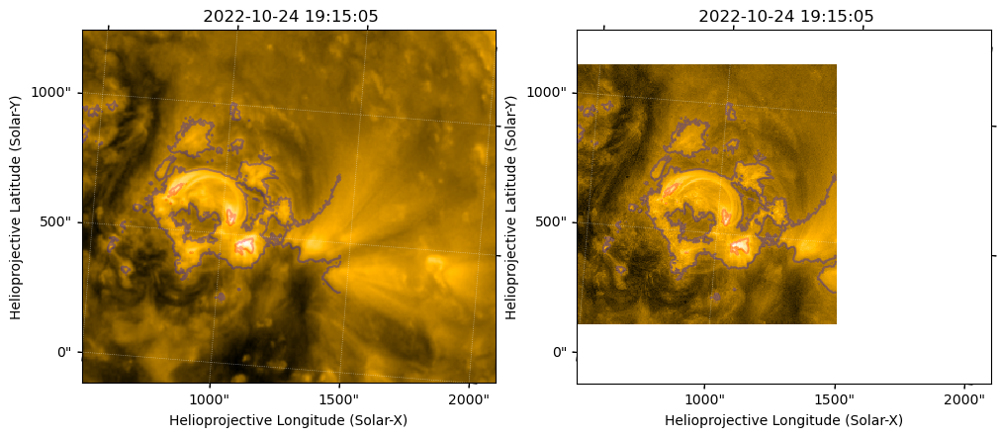

In [58]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=fsi_174_crop)
im1 = fsi_174_crop.plot()

ax2 = fig.add_subplot(122,projection=hri_174_map_repro)
im2 = hri_174_map_repro.plot()

hri_levels = [1000,5000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hri_174_map_repro.draw_contours(hri_levels,colors=["b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


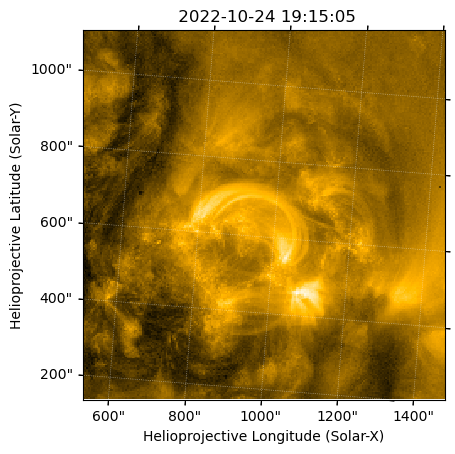

In [59]:
hri_174_map_repro_cut = hri_174_map_repro.submap([10,57]*u.pix,
                                                 top_right=[224,275]*u.pix)
hri_174_map_repro_cut.plot()

In [60]:
Txshift_hri, Tyshift_hri = coalign_shift(fsi_174_crop,hri_174_map_repro_cut)
print(Txshift_hri, Tyshift_hri)

1.66986 arcsec 7.60204 arcsec


In [61]:
hri_174_map_repro_shift = hri_174_map_repro.shift_reference_coord(Txshift_hri,Tyshift_hri)
hri_174_map_repro_cut_shift = hri_174_map_repro_cut.shift_reference_coord(Txshift_hri,Tyshift_hri)
hri_174_map_shifted = hri_174_map.shift_reference_coord(Txshift_hri,Tyshift_hri)
# hri_174_map_shifted = hri_174_map_shifted.submap([10,10]*u.pix,
#                                                     top_right=[2038,2038]*u.pix)
fsi_174_hri_fov = fsi_174_map_hri_time.reproject_to(hri_174_map_shifted.wcs)

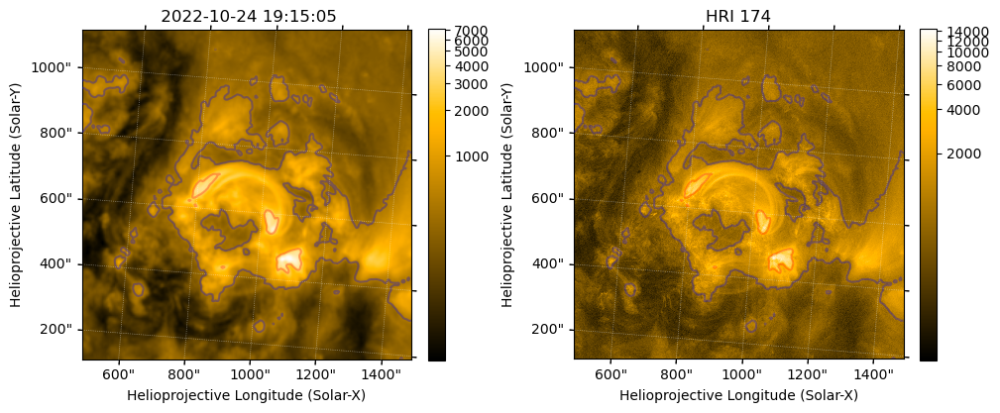

In [62]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=fsi_174_hri_fov)
im1 = fsi_174_hri_fov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
ax2.set_title("HRI 174")
plt.colorbar(ax=ax2,shrink=0.75)

fsi_174_levels = [500,3000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_174_hri_fov.draw_contours(fsi_174_levels,colors=["b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

In [63]:
SunBlinker(fsi_174_hri_fov, hri_174_map_shifted,figsize=(6,6))

In [64]:
fsi_304_map_hri_time = derotate_fsi(fsi_304_map,hri_174_map)

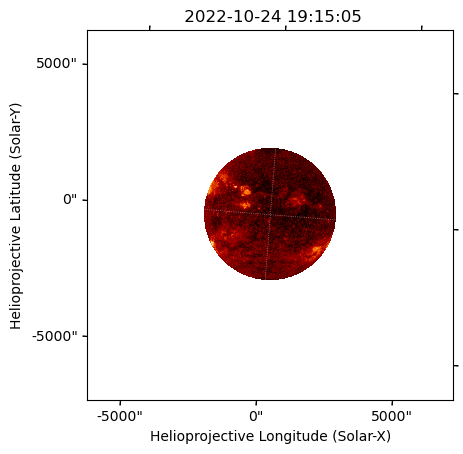

In [65]:
fsi_304_map_hri_time.plot()

In [66]:
fsi_304_crop = fsi_304_map_hri_time.submap(SkyCoord(500*u.arcsec,0*u.arcsec,frame=fsi_304_map_hri_time.coordinate_frame),
                                    top_right=SkyCoord(2000*u.arcsec,1250*u.arcsec,frame=fsi_304_map_hri_time.coordinate_frame))

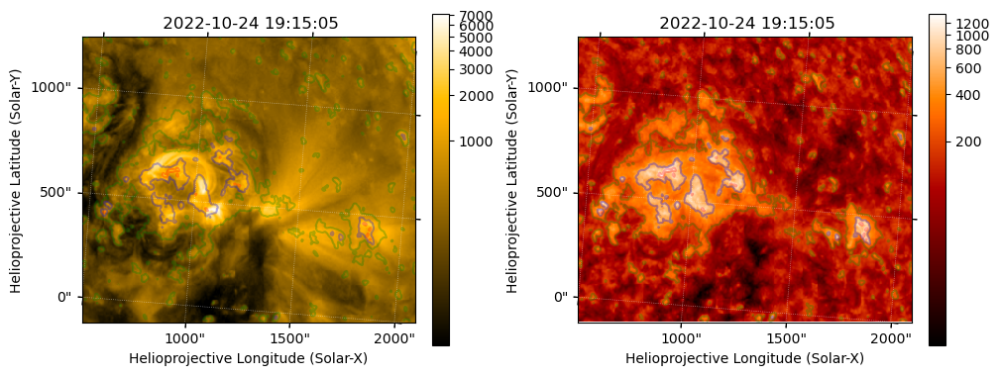

In [67]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=fsi_174_crop)
im1 = fsi_174_crop.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=fsi_304_crop)
im2 = fsi_304_crop.plot()
plt.colorbar(ax=ax2,shrink=0.75)

fsi_304_levels = [200,500,1000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_304_crop.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


In [68]:
SunBlinker(fsi_174_crop, fsi_304_crop)

In [69]:
aia_304_map_repro = aia_304_map.reproject_to(fsi_304_crop.wcs)

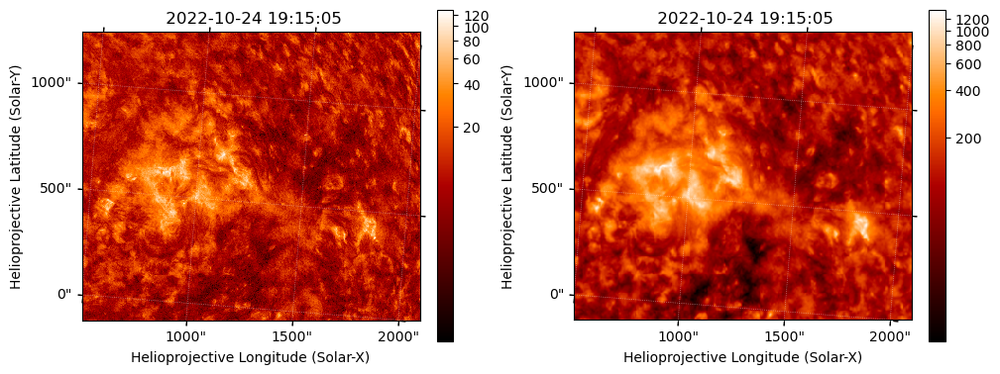

In [70]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_304_map_repro)
im1 = aia_304_map_repro.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=fsi_304_crop)
im2 = fsi_304_crop.plot()
plt.colorbar(ax=ax2,shrink=0.75)

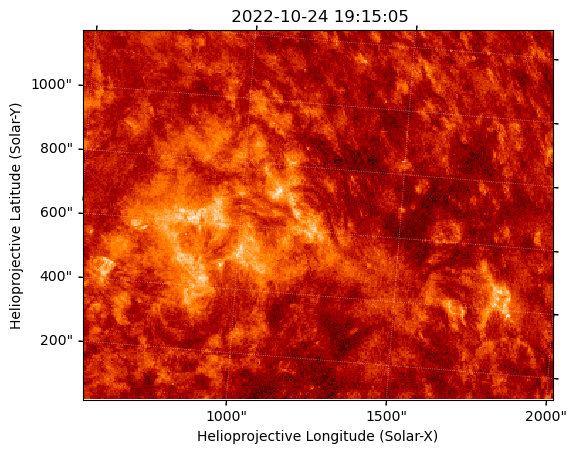

In [71]:
aia_304_map_repro_cut = aia_304_map_repro.submap([12,30]*u.pix,
                                                    top_right=[343,290]*u.pix)
aia_304_map_repro_cut.plot()

In [72]:
Txshift_aia_fsi, Tyshift_aia_fsi = coalign_shift(fsi_304_crop,aia_304_map_repro_cut)
print(Txshift_aia_fsi, Tyshift_aia_fsi)

-2.49223 arcsec 2.76366 arcsec


In [73]:
fsi_304_crop_shift = fsi_304_crop.shift_reference_coord(-Txshift_aia_fsi,-Tyshift_aia_fsi)
fsi_174_crop_shift = fsi_174_crop.shift_reference_coord(-Txshift_aia_fsi,-Tyshift_aia_fsi)
hri_174_map_shifted_toaia = hri_174_map_shifted.shift_reference_coord(-Txshift_aia_fsi,-Tyshift_aia_fsi)
fsi_304_map_hri_time_shift = fsi_304_map_hri_time.shift_reference_coord(-Txshift_aia_fsi,-Tyshift_aia_fsi)
fsi_174_map_hri_time_shift = fsi_174_map_hri_time.shift_reference_coord(-Txshift_aia_fsi,-Tyshift_aia_fsi)

In [74]:
fsi_174_map_hri_time_shift.meta["obsrvtry"] = fsi_174_map.meta["obsrvtry"]
fsi_174_map_hri_time_shift.meta["telescop"] = fsi_174_map.meta["telescop"]
fsi_174_map_hri_time_shift.meta["instrume"] = fsi_174_map.meta["instrume"]
fsi_174_map_hri_time_shift.meta["detector"] = fsi_174_map.meta["detector"]
fsi_174_map_hri_time_shift.meta["wavelnth"] = fsi_174_map.meta["wavelnth"]
fsi_174_map_hri_time_shift.meta["waveunit"] = fsi_174_map.meta["waveunit"]

In [75]:
fsi_174_map_hri_time_shift.save("../../src/coalign_map/20221024/fsi_174_map_hri_time_shift.fits",overwrite=True)

In [76]:
hri_174_map_shifted_toaia.save("../../src/coalign_map/20221024/hri_174_map_shifted_toaia.fits",overwrite=True)
fsi_304_map_hri_time_shift.save("../../src/coalign_map/20221024/fsi_304_map_hri_time_shift.fits",overwrite=True)

In [77]:
coalign_shift(fsi_304_crop_shift,aia_304_map.reproject_to(fsi_304_crop_shift.wcs).submap([20,20]*u.pix,
                                                                                         top_right=[280,280]*u.pix))

(<Angle -0.73386026 arcsec>, <Angle -0.41066501 arcsec>)

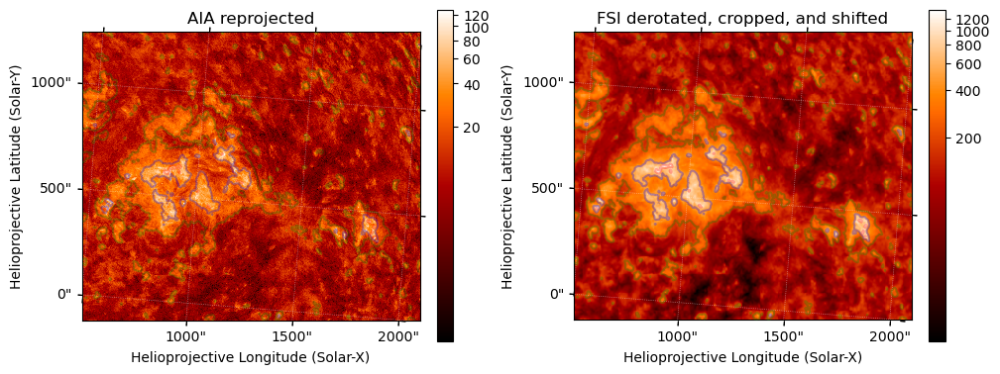

In [78]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_304_map_repro)
im1 = aia_304_map_repro.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA reprojected")

ax2 = fig.add_subplot(122,projection=fsi_304_crop_shift)
im2 = fsi_304_crop_shift.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("FSI derotated, cropped, and shifted")

fsi_304_levels = [200,500,1000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_304_crop_shift.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


/home/yjzhu/.local/lib/python3.11/site-packages/astropy/visualization/wcsaxes/core.py:257: UserWarning: The following kwargs were not used by contour: 'lw'
  cset = super().contour(*args, **kwargs)


(100.0, 200.0)

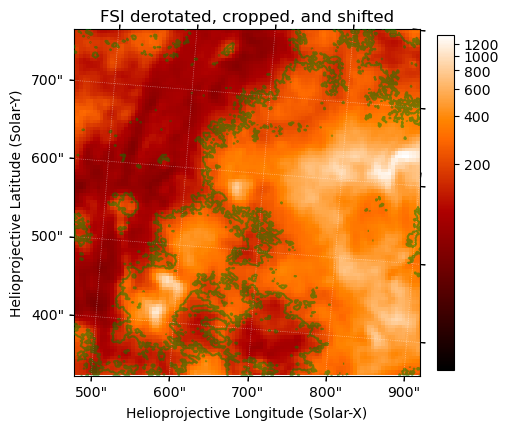

In [79]:
fig = plt.figure(figsize=(5,5),constrained_layout=True)

ax1 = fig.add_subplot(111,projection=fsi_304_crop_shift)
im1 = fsi_304_crop_shift.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("FSI derotated, cropped, and shifted")

aia_304_map_crop.draw_contours([15]*aia_304_map_crop.unit, axes=ax1, colors=["g"], alpha=0.5,lw=0.5)
ax1.set_xlim(0,100)
ax1.set_ylim(100,200)

In [80]:
SunBlinker(aia_304_map_repro, fsi_304_map_hri_time_shift, reproject=True)

In [81]:
aia_1600_map_repro = aia_1600_map.reproject_to(fsi_304_crop_shift.wcs)

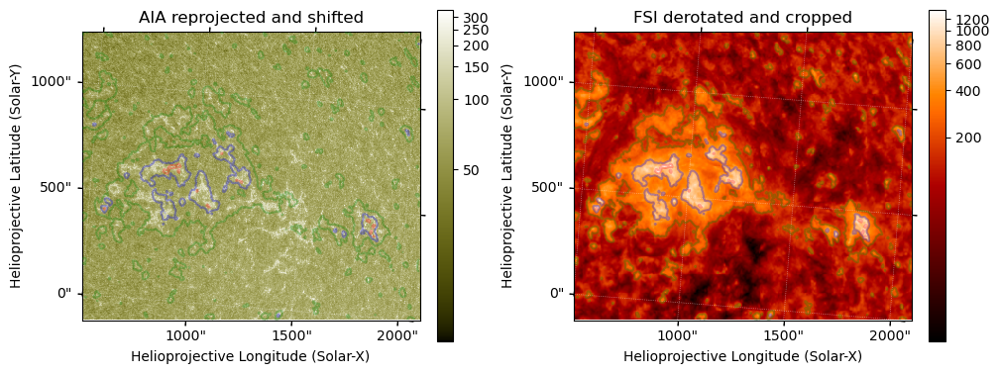

In [82]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_1600_map_repro)
im1 = aia_1600_map_repro.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA reprojected and shifted")

ax2 = fig.add_subplot(122,projection=fsi_304_crop_shift)
im2 = fsi_304_crop_shift.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("FSI derotated and cropped")

fsi_304_levels = [200,500,1000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_304_crop_shift.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


In [83]:
SunBlinker(aia_1600_map_repro, fsi_304_crop_shift)

In [84]:
aia_171_repro = aia_171_map.reproject_to(fsi_304_crop_shift.wcs)

In [85]:
aia_171_repro_hrifov = aia_171_repro.reproject_to(hri_174_map_shifted_toaia.wcs)

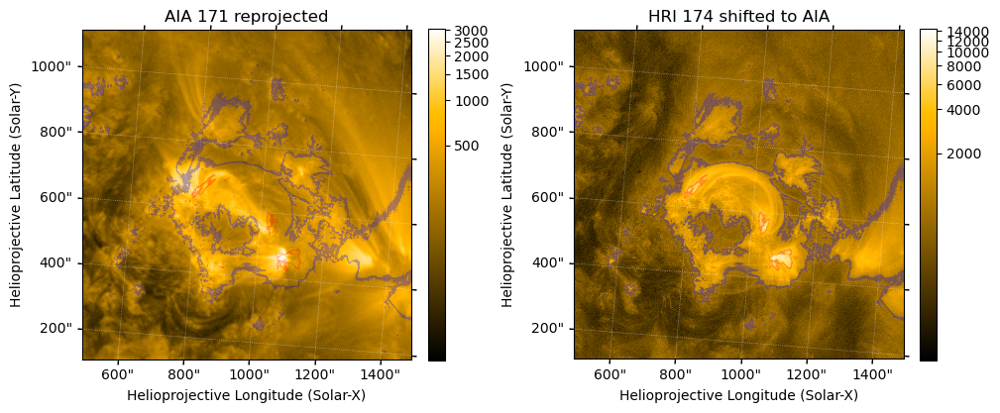

In [86]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_171_repro_hrifov)
im1 = aia_171_repro_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA 171 reprojected")

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = hri_174_map_shifted_toaia.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("HRI 174 shifted to AIA")

hri_levels = [1000,5000]*hri_174_map_shifted_toaia.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hri_174_map_shifted_toaia.draw_contours(hri_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

In [87]:
SunBlinker(aia_171_repro_hrifov, hri_174_map_shifted_toaia)

In [88]:
aia_193_repro = aia_193_map.reproject_to(fsi_304_crop_shift.wcs)
aia_193_repro_hrifov = aia_193_repro.reproject_to(hri_174_map_shifted_toaia.wcs)

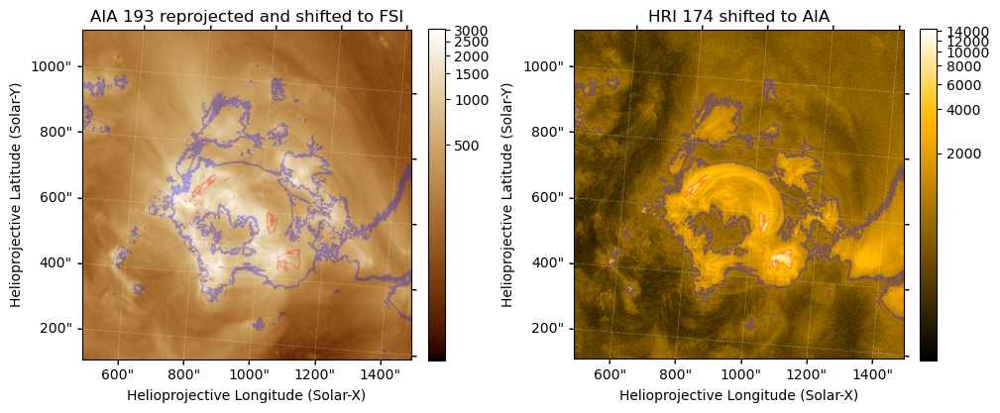

In [89]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_repro_hrifov)
im1 = aia_193_repro_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA 193 reprojected and shifted to FSI")

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = hri_174_map_shifted_toaia.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("HRI 174 shifted to AIA")

hri_levels = [1000,5000]*hri_174_map_shifted_toaia.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hri_174_map_shifted_toaia.draw_contours(hri_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

In [90]:
SunBlinker(aia_193_repro_hrifov, hri_174_map_shifted_toaia)

In [91]:
hmi_los_map_repro = hmi_los_map_to_aia.reproject_to(fsi_304_crop_shift.wcs)
hmi_los_map_repro_hrifov = hmi_los_map_repro.reproject_to(hri_174_map_shifted_toaia.wcs)

In [92]:
fsi_304_crop_hrifov_toaia = fsi_304_crop_shift.reproject_to(hri_174_map_shifted_toaia.wcs)

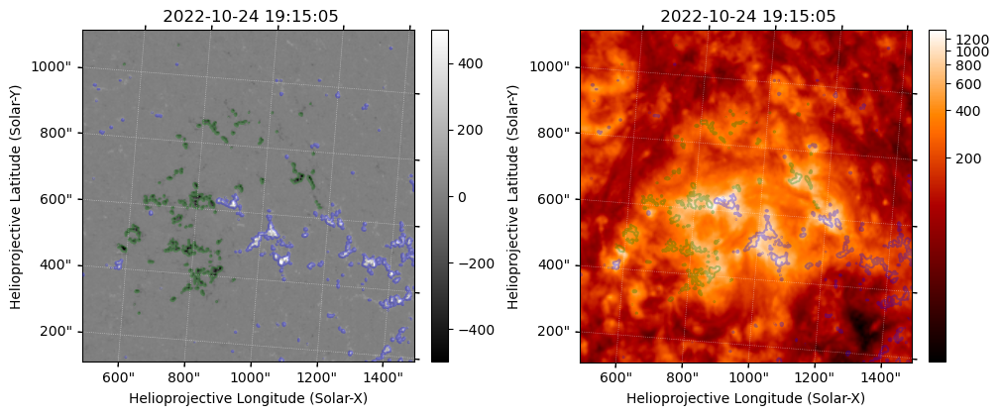

In [93]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hmi_los_map_repro_hrifov)
im1 = hmi_los_map_repro_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=fsi_304_crop_hrifov_toaia)
im2 = fsi_304_crop_hrifov_toaia.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels = [-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro_hrifov.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)
    

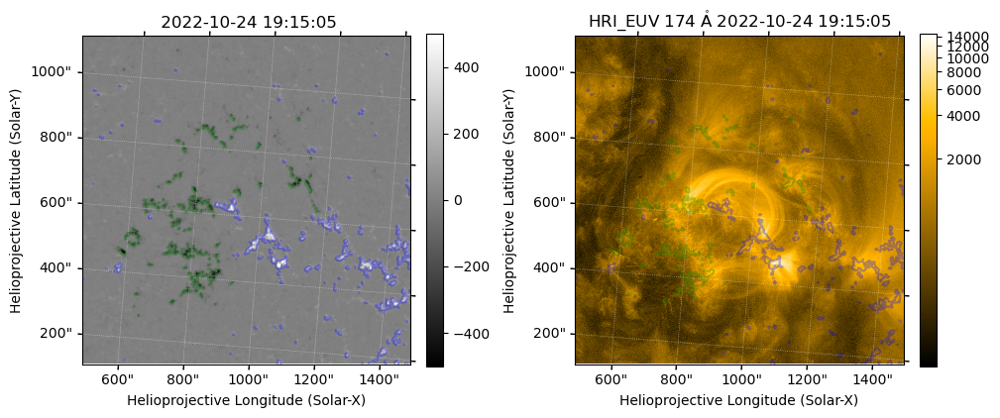

In [94]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hmi_los_map_repro_hrifov)
im1 = hmi_los_map_repro_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = hri_174_map_shifted_toaia.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels = [-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro_hrifov.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

In [95]:
SunBlinker(hmi_los_map_repro_hrifov, hri_174_map_shifted_toaia)

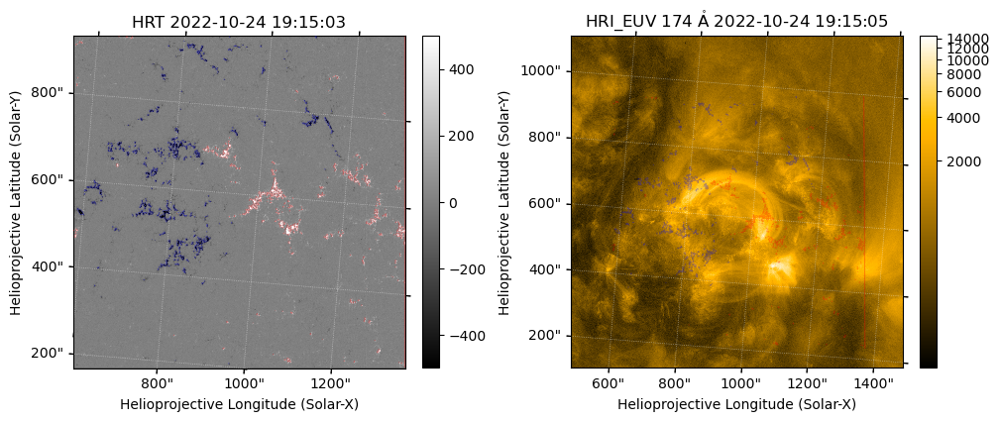

In [96]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map)
im1 = phi_los_map.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map)
im2 = hri_174_map.plot()
plt.colorbar(ax=ax2,shrink=0.75)

phi_levels = [-200,200]*phi_los_map.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    phi_los_map.draw_contours(phi_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

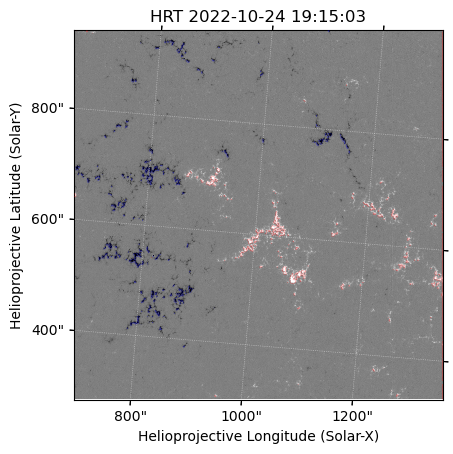

In [97]:
phi_los_map_crop = phi_los_map.submap([200,200]*u.pix,
                                      top_right=[1847,1847]*u.pix)

phi_los_map_crop.plot()
phi_los_map_crop.draw_contours([-300,300]*phi_los_map_crop.unit,colors=["b","r"], alpha=0.3,linewidths=0.5)

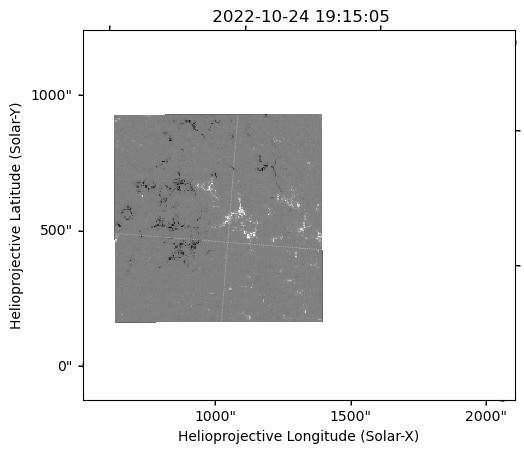

In [98]:
phi_los_map_resample = phi_los_map.reproject_to(fsi_304_crop_shift.wcs)
phi_los_map_resample.plot()

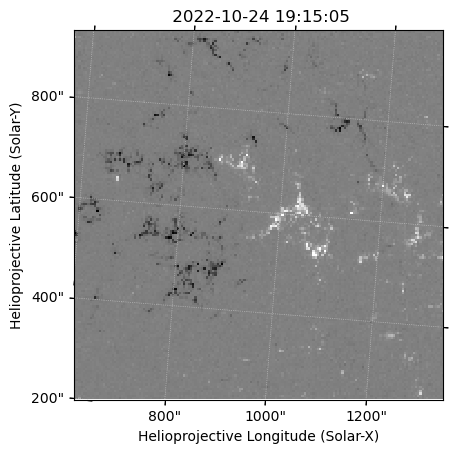

In [99]:
phi_los_map_resample_crop = phi_los_map_resample.submap([30,70]*u.pix,
                                                        top_right=[195,235]*u.pix)
phi_los_map_resample_crop.plot()

In [100]:
Txshift_phi_hmi, Tyshift_phi_hmi = coalign_shift(hmi_los_map_repro,phi_los_map_resample_crop)
print(Txshift_phi_hmi, Tyshift_phi_hmi)

-7.56808 arcsec -67.6155 arcsec


In [101]:
phi_los_map_shifted = phi_los_map.shift_reference_coord(Txshift_phi_hmi,Tyshift_phi_hmi)
phi_los_map_shifted_hrifov = phi_los_map_shifted.reproject_to(hri_174_map_shifted_toaia.wcs)
phi_los_map_resample_crop_shifted = phi_los_map_resample_crop.shift_reference_coord(Txshift_phi_hmi,Tyshift_phi_hmi)

In [102]:
phi_los_map_shifted.save("../../src/coalign_map/20221024/phi_los_map_shifted.fits",overwrite=True)

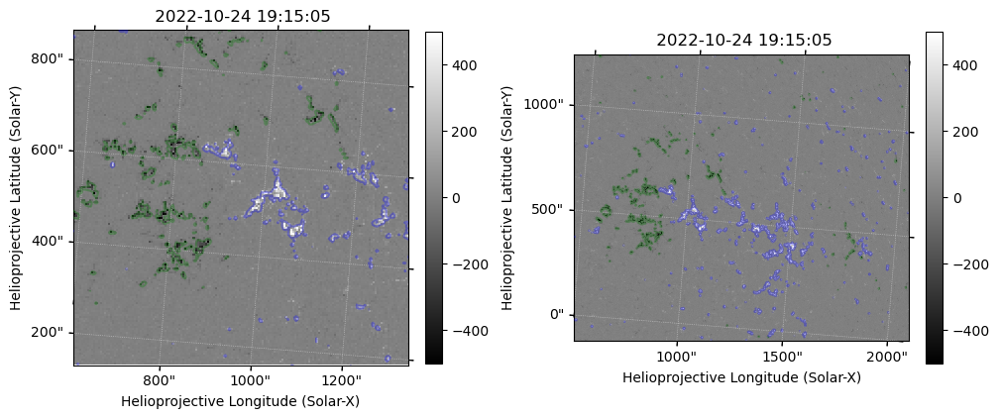

In [103]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map_resample_crop_shifted)
im1 = phi_los_map_resample_crop_shifted.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hmi_los_map_repro)
im2 = hmi_los_map_repro.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels=[-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

plt.savefig("../../figs/test_figs/phi_hmi_coalign_1024.png",dpi=300,bbox_inches="tight")

In [104]:
phi_los_map_resample_crop_shifted.save("../../src/coalign_map/20221024/test_phi_los_map_resample_crop_shifted.fits",overwrite=True)
hmi_los_map_repro.save("../../src/coalign_map/20221024/test_hmi_los_map_repro.fits",overwrite=True)

 [astropy.io.fits.verify]


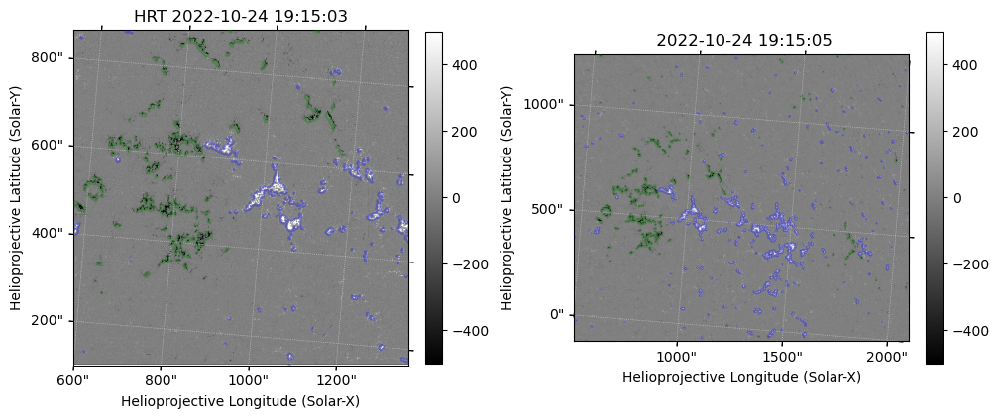

In [105]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map_shifted)
im1 = phi_los_map_shifted.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hmi_los_map_repro)
im2 = hmi_los_map_repro.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels=[-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

plt.savefig("../../figs/test_figs/phi_hmi_coalign_1024_highres.png",dpi=300,bbox_inches="tight")

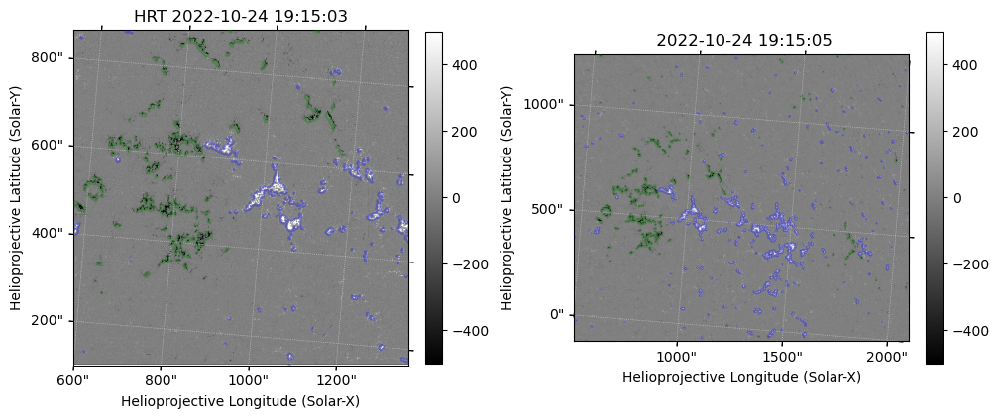

In [106]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map_shifted)
im1 = phi_los_map_shifted.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hmi_los_map_repro)
im2 = hmi_los_map_repro.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels=[-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

In [107]:
sotsp_btot_map_shift_phi_fov = sotsp_btot_map_shift.reproject_to(phi_los_map_shifted.wcs)

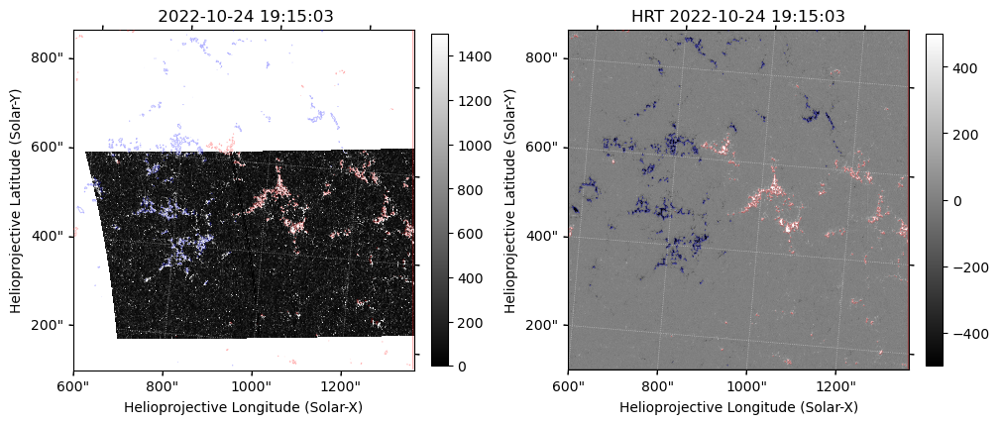

In [108]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=sotsp_btot_map_shift_phi_fov)
im1 = sotsp_btot_map_shift_phi_fov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=phi_los_map_shifted)
im2 = phi_los_map_shifted.plot()
plt.colorbar(ax=ax2,shrink=0.75)

phi_levels = [-200,200]*phi_los_map_shifted.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    phi_los_map_shifted.draw_contours(phi_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

plt.savefig("../../figs/test_figs/sotsp_phi_coalign_1024.png",dpi=300,bbox_inches="tight")

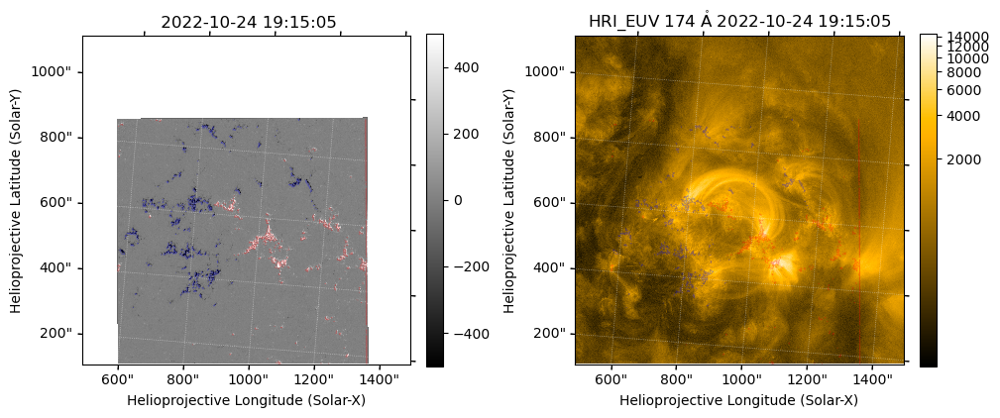

In [109]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map_shifted_hrifov)
im1 = phi_los_map_shifted_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = hri_174_map_shifted_toaia.plot()
plt.colorbar(ax=ax2,shrink=0.75)

phi_levels = [-200,200]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    phi_los_map_shifted_hrifov.draw_contours(phi_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

In [110]:
SunBlinker(phi_los_map_shifted_hrifov.submap([217,10]*u.pix,top_right=[1700,1500]*u.pix), 
           hmi_los_map_repro_hrifov.submap([217,10]*u.pix,top_right=[1700,1500]*u.pix),
           figsize=(6,6))

In [111]:
eis_195_velmap = eis_195_fitres.get_map(component=0,measurement="vel")
eis_195_velmap.meta["rsun_ref"] = aia_1600_map.meta["rsun_ref"]
eis_195_velmap.plot_settings['norm'] = ImageNormalize(vmin=-15,vmax=15)
eis_195_velmap_shift = eis_195_velmap.shift_reference_coord(eis_to_aia_Txshift, eis_to_aia_Tyshift)

with propagate_with_solar_surface(rotation_model="rigid"):
    eis_195_intmap_derot = eis_195_intmap_shift.reproject_to(aia_193_map_crop.wcs)
    eis_195_velmap_derot = eis_195_velmap_shift.reproject_to(aia_193_map_crop.wcs)

INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]


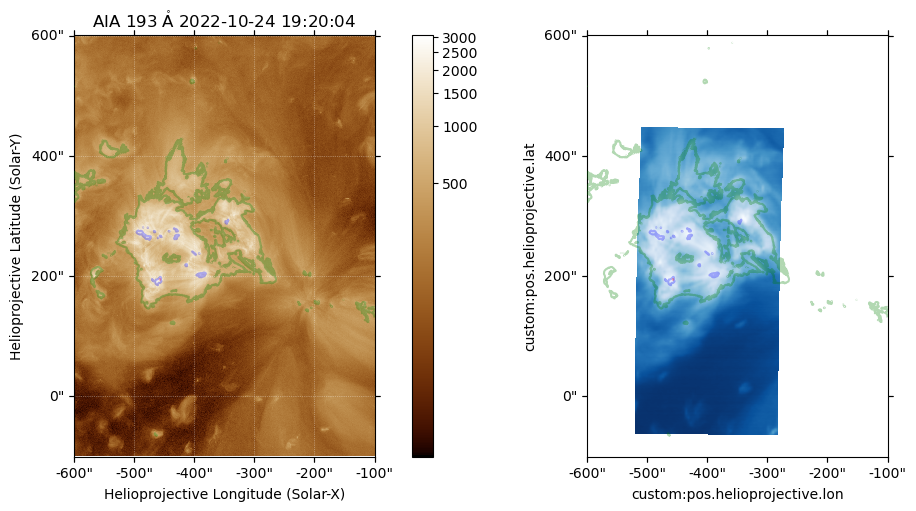

In [112]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_map_crop)
im1 = aia_193_map_crop.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_193_map_crop)
ax2.imshow(eis_195_intmap_derot.data,origin="lower",cmap=eis_195_intmap_derot.plot_settings['cmap'],norm=eis_195_intmap_derot.plot_settings['norm'])

aia_193_levels = [500,2000,3000]*aia_193_map_crop.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_193_map_crop.draw_contours(aia_193_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)



In [113]:
SunBlinker(aia_193_map_crop, eis_195_intmap_derot)

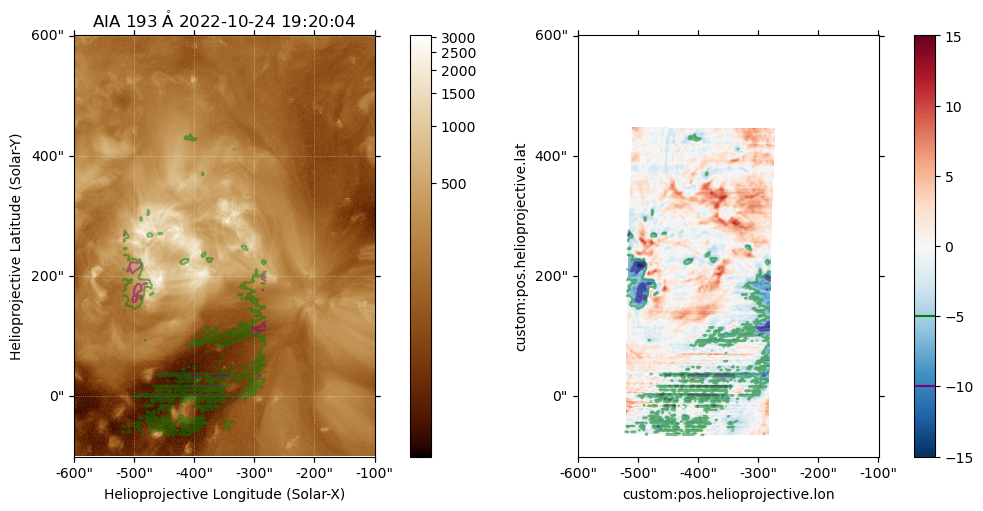

In [114]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_map_crop)
im1 = aia_193_map_crop.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_193_map_crop)
im2 = ax2.imshow(eis_195_velmap_derot.data,origin="lower",cmap=eis_195_velmap_derot.plot_settings['cmap'],norm=eis_195_velmap_derot.plot_settings['norm'])
clb2 = plt.colorbar(im2,ax=ax2)
clb2.ax.axhline(-5,color="green")
clb2.ax.axhline(-10,color="purple")

eis_vel_levels = [-10,-5]
for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    eis_195_velmap_derot.draw_contours(eis_vel_levels,colors=["purple","green"], axes=ax_, alpha=0.5)
    ax_.axis(bounds)

In [115]:
SunBlinker(aia_193_map_crop, eis_195_velmap_derot)

In [261]:
eis_195_velmap_derot.save("../../src/EIS/DHB_007_v2/20221025T0023/sunpymaps/eis_195_velmap_derot.fits",overwrite=True)
eis_195_intmap_derot.save("../../src/EIS/DHB_007_v2/20221025T0023/sunpymaps/eis_195_intmap_derot.fits",overwrite=True)
eis_195_intmap_shift.save("../../src/EIS/DHB_007_v2/20221025T0023/sunpymaps/eis_195_intmap_shift.fits",overwrite=True)
eis_195_velmap_shift.save("../../src/EIS/DHB_007_v2/20221025T0023/sunpymaps/eis_195_velmap_shift.fits",overwrite=True)

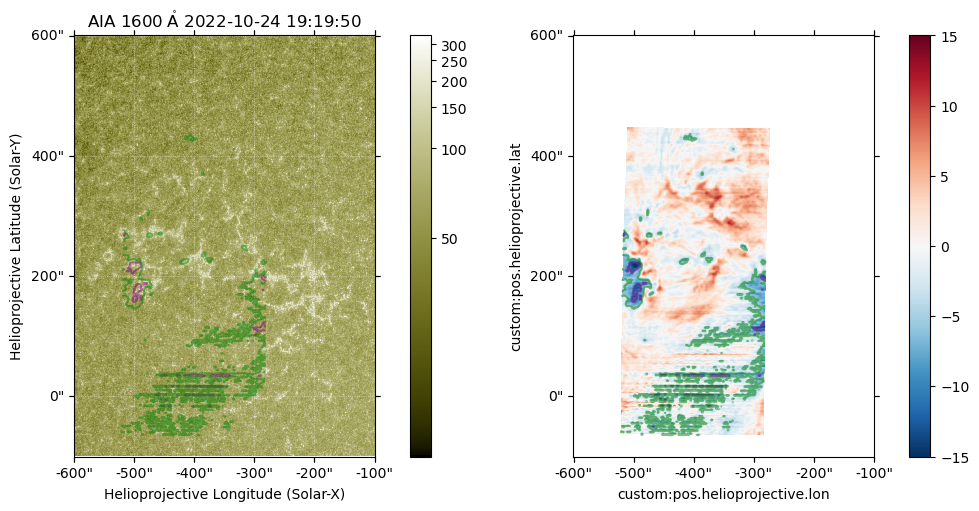

In [117]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_1600_map_crop)
im1 = aia_1600_map_crop.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_1600_map_crop)
im2 = ax2.imshow(eis_195_velmap_derot.data,origin="lower",cmap=eis_195_velmap_derot.plot_settings['cmap'],norm=eis_195_velmap_derot.plot_settings['norm'])
plt.colorbar(im2,ax=ax2)

eis_vel_levels = [-10,-5]
for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    eis_195_velmap_derot.draw_contours(eis_vel_levels,colors=["purple","green"], axes=ax_, alpha=0.5)
    ax_.axis(bounds)

In [118]:
eis_195_intmap_derot_repro = eis_195_intmap_derot.reproject_to(fsi_304_crop_shift.wcs)
eis_195_velmap_derot_repro = eis_195_velmap_derot.reproject_to(fsi_304_crop_shift.wcs)

In [119]:
eis_195_intmap_derot_repro_hrifov = eis_195_intmap_derot.reproject_to(hri_174_map_shifted_toaia.wcs)
eis_195_velmap_derot_repro_hrifov = eis_195_velmap_derot.reproject_to(hri_174_map_shifted_toaia.wcs)

In [120]:
SunBlinker(hri_174_map_shifted, eis_195_intmap_derot_repro_hrifov)

In [121]:
SunBlinker(hri_174_map_shifted_toaia, eis_195_velmap_derot_repro_hrifov)

In [122]:
SunBlinker(aia_171_map_crop.submap([100,100]*u.pix,top_right=[550,900]*u.pix),
           eis_195_velmap_derot.submap([100,100]*u.pix,top_right=[550,900]*u.pix),)

/home/yjzhu/.local/lib/python3.11/site-packages/astropy/visualization/wcsaxes/patches.py:196: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  super().__init__(vertices, **kwargs)


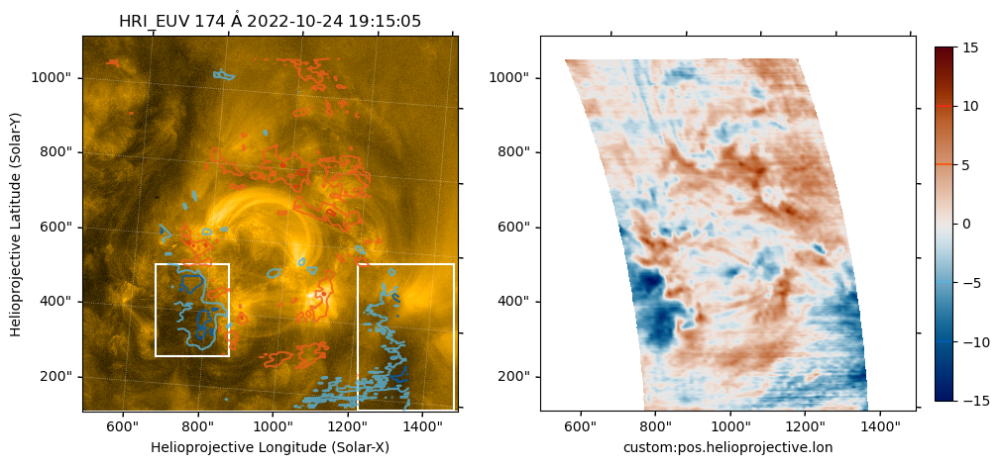

In [123]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hri_174_map_shifted_toaia)
im1 = hri_174_map_shifted_toaia.plot()

eis_195_velmap_derot_repro_hrifov.draw_contours(levels=[-10,-5,5,10],colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],axes=ax1,alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = ax2.imshow(eis_195_velmap_derot_repro_hrifov.data,vmin=-15,vmax=15,cmap=cmcm.vik,origin="lower")
clb = plt.colorbar(im2,ax=ax2,shrink=0.8)
for level_, color_ in zip([-10,-5,5,10],["#005CAF","#58B2DC","#F05E1C","#E83015"]):
    clb.ax.axhline(level_,color=color_)

bounds = ax1.axis()
hri_174_map_shifted_toaia.draw_quadrangle([400,300]*u.pix,top_right=[800,800]*u.pix, 
                                    axes=ax1, color="w", lw=1.5)
hri_174_map_shifted_toaia.draw_quadrangle([1500,0]*u.pix,top_right=[2029,800]*u.pix, 
                                    axes=ax1, color="w", lw=1.5)
ax1.axis(bounds)
ax2.set_ylabel(" ")

In [124]:
eis_195_velmap_derot_repro_hrifov.save("../../src/EIS/DHB_007_v2/20221025T0023/sunpymaps/eis_195_velmap_derot_repro_hrifov.fits",overwrite=True)

In [125]:
eis_195_width_map = eis_195_fitres.get_map(component=0,measurement="width")
eis_195_width_map.meta["rsun_ref"] = aia_1600_map.meta["rsun_ref"]
eis_195_true_width = np.sqrt( (eis_195_width_map.data * np.sqrt(8*np.log(2)))**2 - (eis_195_fitres.meta["slit_width"][:,np.newaxis])**2)
eis_195_v1oe = eis_195_true_width*u.angstrom/np.sqrt(4*np.log(2))*const.c/(195.119*u.angstrom)
vth2 = 2*const.k_B*(10**6.2)*u.K/const.u/55.85
vnth = np.sqrt(eis_195_v1oe**2 - vth2).to(u.km/u.s)

INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]


/tmp/ipykernel_173072/895987438.py:3: RuntimeWarning: invalid value encountered in sqrt
  eis_195_true_width = np.sqrt( (eis_195_width_map.data * np.sqrt(8*np.log(2)))**2 - (eis_195_fitres.meta["slit_width"][:,np.newaxis])**2)
/home/yjzhu/.local/lib/python3.11/site-packages/astropy/units/quantity.py:666: RuntimeWarning: invalid value encountered in sqrt
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)


In [126]:
eis_195_vnth_map = sunpy.map.Map(vnth, eis_195_width_map.meta)
eis_195_vnth_map_shift = eis_195_vnth_map.shift_reference_coord(eis_to_aia_Txshift, eis_to_aia_Tyshift)

with propagate_with_solar_surface(rotation_model="rigid"):
    eis_195_vnth_map_shift_derot = eis_195_vnth_map_shift.reproject_to(aia_193_map_crop.wcs)

eis_195_vnth_map_shift_derot_repro = eis_195_vnth_map_shift_derot.reproject_to(fsi_304_crop_shift.wcs)
eis_195_vnth_map_shift_derot_repro_hrifov = eis_195_vnth_map_shift_derot.reproject_to(hri_174_map_shifted_toaia.wcs)

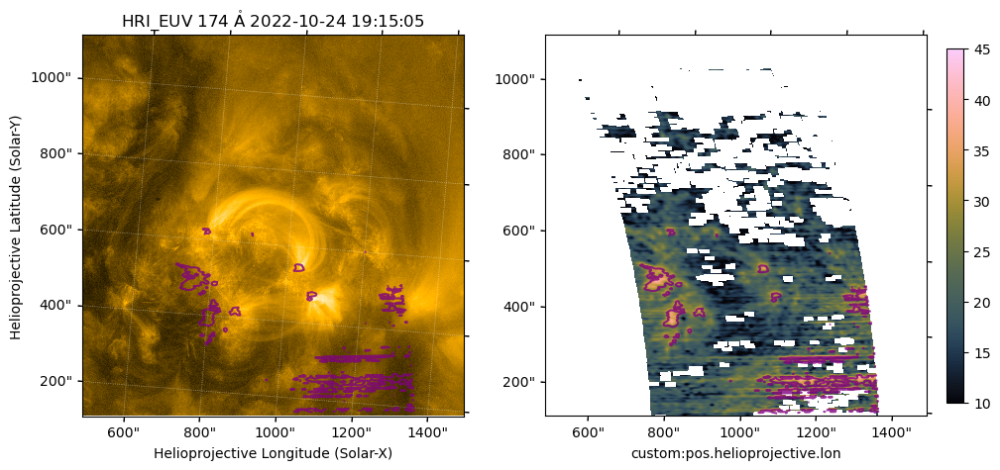

In [127]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hri_174_map_shifted_toaia)
im1 = hri_174_map_shifted_toaia.plot()
# ax1.contour(eis_195_velmap_derot_repro_shifted_hrifov.data,levels=[-10,-5,5,10]*u.km/u.s,colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = ax2.imshow(eis_195_vnth_map_shift_derot_repro_hrifov.data,vmin=10,vmax=45,cmap=cmcm.batlowK,origin="lower")
plt.colorbar(im2,ax=ax2,shrink=0.8)

eis_195_vnth_levels = [30]
for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    eis_195_vnth_map_shift_derot_repro_hrifov.draw_contours(eis_195_vnth_levels,colors=["purple"],axes=ax_,alpha=0.8)
    ax_.axis(bounds)

ax2.set_ylabel(" ")

In [128]:
SunBlinker(phi_los_map_shifted_hrifov, eis_195_velmap_derot_repro_hrifov)

In [129]:
with propagate_with_solar_surface():
    eis_hhflare_195_intmap_derot = eis_hhflare_195_intmap_shift.reproject_to(aia_193_map_crop.wcs)
    eis_hhflare_195_velmap_derot = eis_hhflare_195_velmap_shift.reproject_to(aia_193_map_crop.wcs)

eis_hhflare_195_intmap_derot_repro = eis_hhflare_195_intmap_derot.reproject_to(fsi_304_crop_shift.wcs)
eis_hhflare_195_velmap_derot_repro = eis_hhflare_195_velmap_derot.reproject_to(fsi_304_crop_shift.wcs)

eis_hhflare_195_intmap_derot_repro_hrifov = eis_hhflare_195_intmap_derot.reproject_to(hri_174_map_shifted_toaia.wcs)
eis_hhflare_195_velmap_derot_repro_hrifov = eis_hhflare_195_velmap_derot.reproject_to(hri_174_map_shifted_toaia.wcs)

In [262]:
eis_hhflare_195_intmap_shift.save("../../src/coalign_map/20221024/eis_hhflare_195_intmap_shift.fits",overwrite=True)
eis_hhflare_195_velmap_shift.save("../../src/coalign_map/20221024/eis_hhflare_195_velmap_shift.fits",overwrite=True)
eis_hhflare_195_velmap_derot.save("../../src/coalign_map/20221024/eis_hhflare_195_velmap_derot.fits",overwrite=True)
eis_hhflare_195_velmap_derot_repro_hrifov.save("../../src/coalign_map/20221024/eis_hhflare_195_velmap_derot_repro_hrifov.fits",overwrite=True)

In [131]:
SunBlinker(eis_hhflare_195_intmap_shift,eis_hhflare_195_velmap_shift)

In [132]:
SunBlinker(aia_193_map_crop,eis_hhflare_195_intmap_derot)

In [133]:
SunBlinker(aia_193_map_crop.submap([150,350]*u.pix, top_right=[520,700]*u.pix),
           eis_hhflare_195_intmap_derot.submap([150,350]*u.pix, top_right=[520,700]*u.pix))

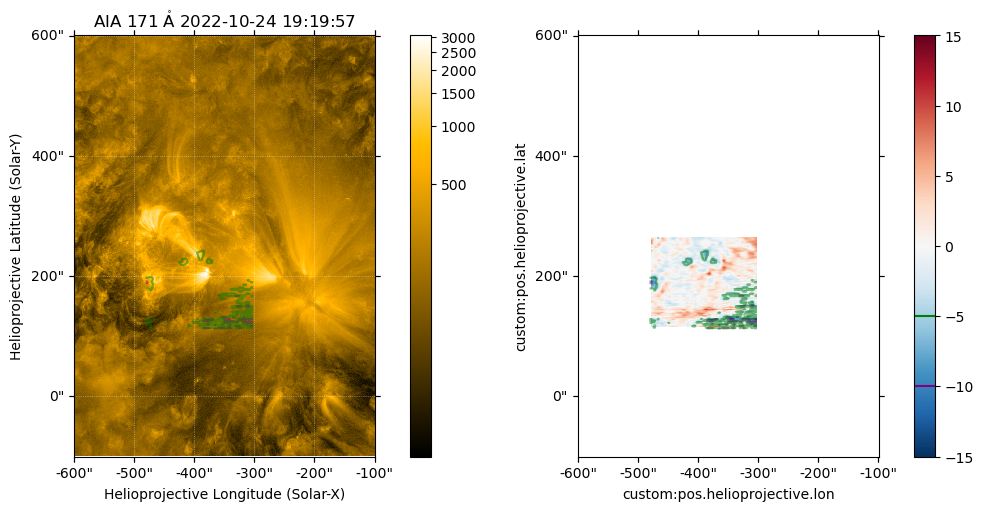

In [134]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_171_map_crop)
im1 = aia_171_map_crop.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=eis_hhflare_195_velmap_derot)
im2 = ax2.imshow(eis_hhflare_195_velmap_derot.data,origin="lower",cmap=eis_195_velmap_derot.plot_settings['cmap'],norm=eis_195_velmap_derot.plot_settings['norm'])
clb2 = plt.colorbar(im2,ax=ax2)
clb2.ax.axhline(-5,color="green")
clb2.ax.axhline(-10,color="purple")

eis_vel_levels = [-10,-5]
for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    eis_hhflare_195_velmap_derot.draw_contours(eis_vel_levels,colors=["purple","green"], axes=ax_, alpha=0.5)
    ax_.axis(bounds)

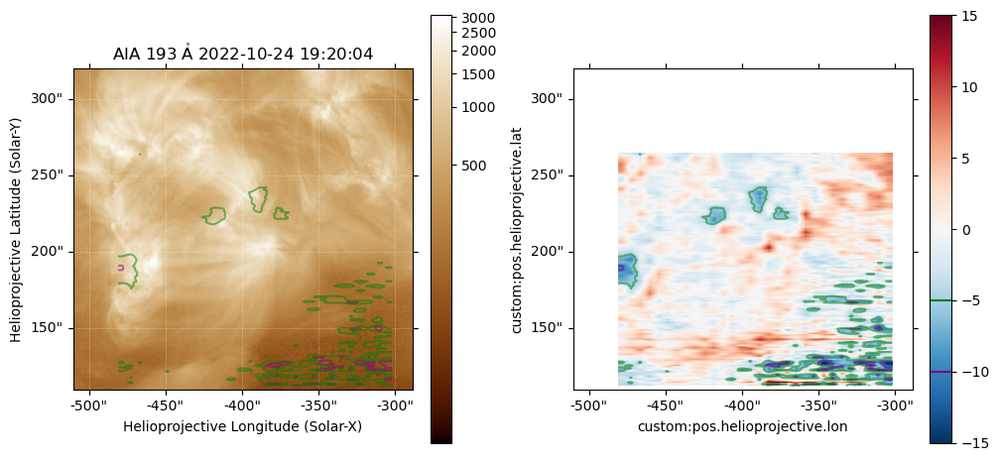

In [135]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_map_crop)
im1 = aia_193_map_crop.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_193_map_crop)
im2 = ax2.imshow(eis_hhflare_195_velmap_derot.data,origin="lower",cmap=eis_195_velmap_derot.plot_settings['cmap'],norm=eis_195_velmap_derot.plot_settings['norm'])
clb2 = plt.colorbar(im2,ax=ax2)
clb2.ax.axhline(-5,color="green")
clb2.ax.axhline(-10,color="purple")

eis_vel_levels = [-10,-5]
for ax_ in (ax1,ax2):
    eis_hhflare_195_velmap_derot.draw_contours(eis_vel_levels,colors=["purple","green"], axes=ax_, alpha=0.5)
    ax_.set_xlim(150,520)
    ax_.set_ylim(350,700)

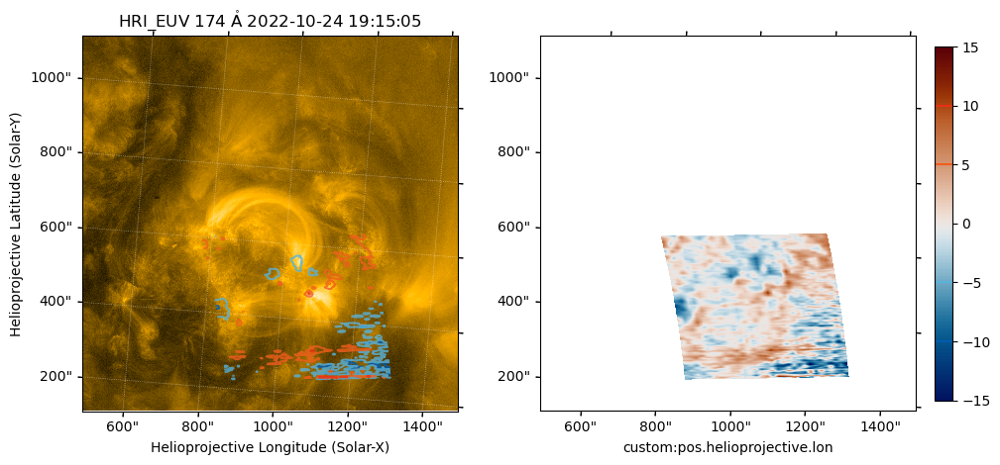

In [136]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hri_174_map_shifted_toaia)
im1 = hri_174_map_shifted_toaia.plot()

eis_hhflare_195_velmap_derot_repro_hrifov.draw_contours(levels=[-10,-5,5,10],colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],axes=ax1,alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = ax2.imshow(eis_hhflare_195_velmap_derot_repro_hrifov.data,vmin=-15,vmax=15,cmap=cmcm.vik,origin="lower")
clb = plt.colorbar(im2,ax=ax2,shrink=0.8)
for level_, color_ in zip([-10,-5,5,10],["#005CAF","#58B2DC","#F05E1C","#E83015"]):
    clb.ax.axhline(level_,color=color_)

# bounds = ax1.axis()
# hri_174_map_shifted_toaia.draw_quadrangle([400,300]*u.pix,top_right=[800,800]*u.pix, 
#                                     axes=ax1, color="w", lw=1.5)
# hri_174_map_shifted_toaia.draw_quadrangle([1500,0]*u.pix,top_right=[2029,800]*u.pix, 
#                                     axes=ax1, color="w", lw=1.5)
# ax1.axis(bounds)
ax2.set_ylabel(" ")

In [137]:
def derotate_iris(iris_map, aia_map,algorithm="adaptive"):
    out_frame = aia_map.coordinate_frame
    out_center = SkyCoord(iris_map.center.Tx, iris_map.center.Ty, frame=out_frame)
    header = sunpy.map.make_fitswcs_header(iris_map.data.shape,
                                        out_center,
                                        scale=u.Quantity(iris_map.scale),
                                        rotation_matrix=aia_map.rotation_matrix) 
    # correct the tiny rotation matrix difference between FSI and HRI, which simply the coalignment
    out_wcs = WCS(header)

    with propagate_with_solar_surface():
        iris_map_derot = iris_map.reproject_to(out_wcs,algorithm=algorithm)

    return iris_map_derot


In [138]:
iris_1400_sji_map_rotate = derotate_iris(iris_1400_sji_map, aia_1700_map_crop)

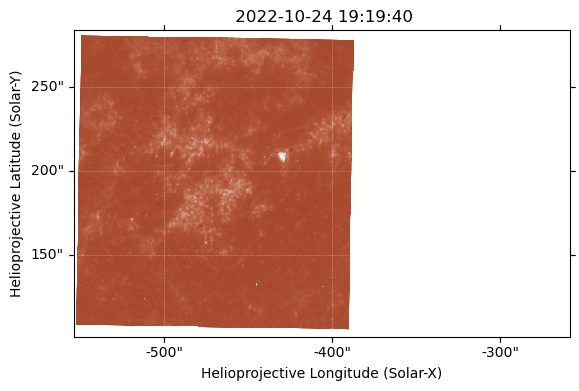

In [139]:
iris_1400_sji_map_rotate.plot()

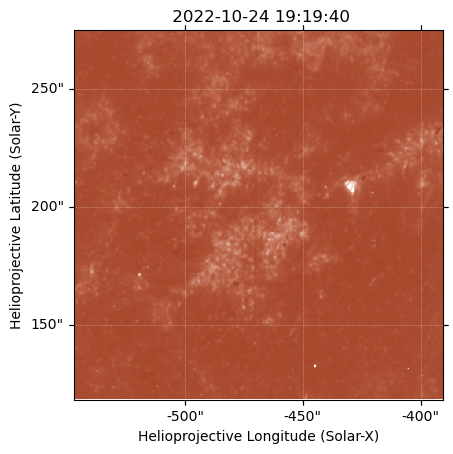

In [140]:
iris_1400_sji_map_rotate_crop = iris_1400_sji_map_rotate.submap([20,50]*u.pix,top_right=[490,520]*u.pix)
iris_1400_sji_map_rotate_crop.plot()

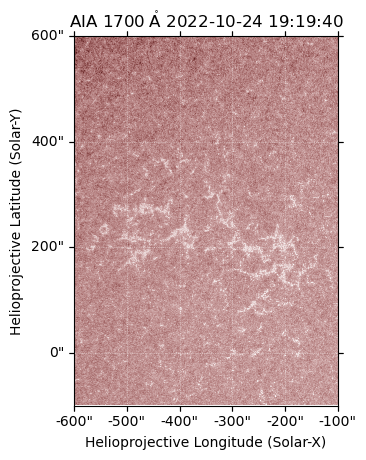

In [141]:
aia_1700_map_crop.plot()

In [142]:
iris_1400_resample_nx = (iris_1400_sji_map_rotate_crop.scale.axis1 * iris_1400_sji_map_rotate_crop.dimensions.x).to(u.arcsec) / aia_1700_map_crop.scale.axis1
iris_1400_resample_ny = (iris_1400_sji_map_rotate_crop.scale.axis2 * iris_1400_sji_map_rotate_crop.dimensions.y).to(u.arcsec) / aia_1700_map_crop.scale.axis2
iris_1400_sji_map_rotate_crop_resample = iris_1400_sji_map_rotate_crop.resample(u.Quantity([iris_1400_resample_nx, iris_1400_resample_ny]))

In [143]:
Txshift_iris_aia, Tyshift_iris_aia = coalign_shift(aia_1700_map_crop,iris_1400_sji_map_rotate_crop_resample)
print(Txshift_iris_aia, Tyshift_iris_aia)

-6.15406 arcsec 0.018131 arcsec


In [144]:
iris_1400_sji_map_rotate_crop_shift = iris_1400_sji_map_rotate_crop.shift_reference_coord(Txshift_iris_aia,Tyshift_iris_aia)
aia_1700_map_crop_iris_1400_fov = aia_1700_map_crop.reproject_to(iris_1400_sji_map_rotate_crop_shift.wcs)

In [145]:
SunBlinker(aia_1700_map_crop_iris_1400_fov, iris_1400_sji_map_rotate_crop_shift)

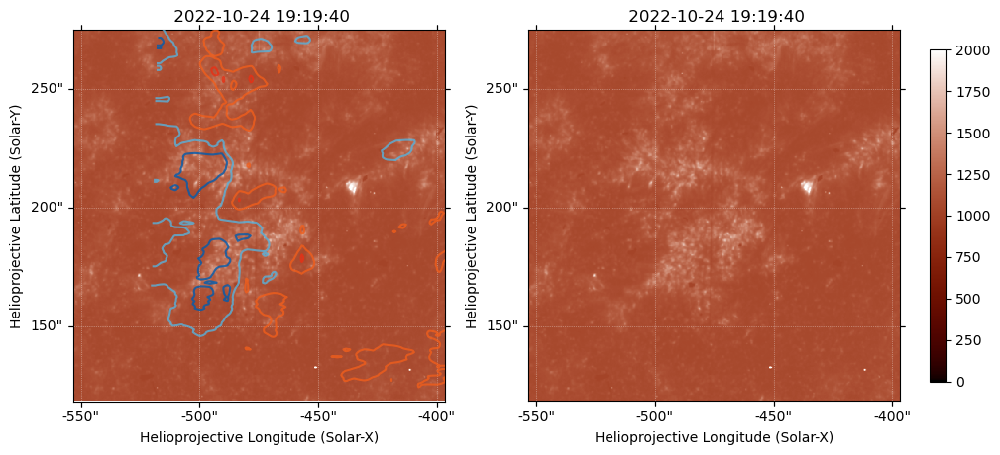

In [146]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=iris_1400_sji_map_rotate_crop_shift)
iris_1400_sji_map_rotate_crop_shift.plot(axes=ax1)


bounds = ax1.axis()
eis_195_velmap_derot.draw_contours(levels=[-10,-5,5,10],colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],axes=ax1,alpha=0.8)
ax1.axis(bounds)

ax2 = fig.add_subplot(122,projection=iris_1400_sji_map_rotate_crop_shift)
iris_1400_sji_map_rotate_crop_shift.plot(axes=ax2)
plt.colorbar(ax=ax2,shrink=0.75)

In [147]:
iris_1400_sji_map_rotate_crop_shift.save("../../src/coalign_map/20221024/iris_1400_sji_map_rotate_crop_shift.fits",overwrite=True)

 [astropy.io.fits.verify]


For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs
 [sunpy.map.mapbase]


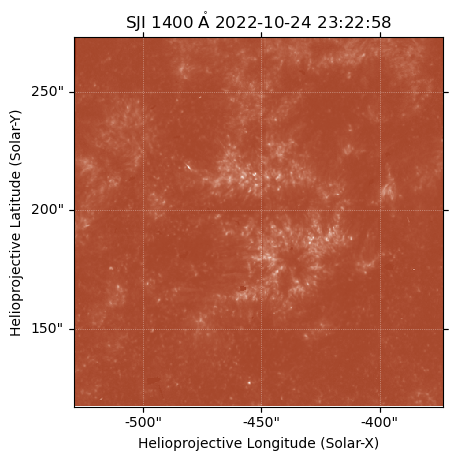

In [148]:
iris_1400_sji_2322_map_rotate = iris_1400_sji_2322_map.rotate()
iris_1400_sji_2322_map_rotate_crop = iris_1400_sji_2322_map_rotate.submap([23,52]*u.pix,top_right=[490,520]*u.pix)
iris_1400_sji_2322_map_rotate_crop.plot()

In [149]:
iris_1400_2322_resample_nx = (iris_1400_sji_2322_map_rotate_crop.scale.axis1 * iris_1400_sji_2322_map_rotate_crop.dimensions.x).to(u.arcsec) / aia_1700_map_2322_crop.scale.axis1
iris_1400_2322_resample_ny = (iris_1400_sji_2322_map_rotate_crop.scale.axis2 * iris_1400_sji_2322_map_rotate_crop.dimensions.y).to(u.arcsec) / aia_1700_map_2322_crop.scale.axis2
iris_1400_sji_2322_map_rotate_crop_resample = iris_1400_sji_2322_map_rotate_crop.resample(u.Quantity([iris_1400_2322_resample_nx, iris_1400_2322_resample_ny]))

Txshift_iris_aia_2322, Tyshift_iris_aia_2322 = coalign_shift(aia_1700_map_2322_crop,iris_1400_sji_2322_map_rotate_crop_resample)
print(Txshift_iris_aia_2322, Tyshift_iris_aia_2322)

-9.53411 arcsec 0.395789 arcsec


For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs
 [sunpy.map.mapbase]


In [150]:
iris_1400_sji_2322_map_rotate_crop_shift = iris_1400_sji_2322_map_rotate_crop.shift_reference_coord(Txshift_iris_aia_2322,Tyshift_iris_aia_2322)
aia_1700_map_2322_crop_iris_1400_2322_fov = aia_1700_map_2322_crop.reproject_to(iris_1400_sji_2322_map_rotate_crop_shift.wcs)

For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs
 [sunpy.map.mapbase]


In [267]:
iris_1400_sji_2322_map_rotate_crop_shift.save("../../src/coalign_map/20221024/iris_1400_sji_2322_0_map_rotate_crop_shift.fits",overwrite=True)

In [151]:
SunBlinker(aia_1700_map_2322_crop_iris_1400_2322_fov, iris_1400_sji_2322_map_rotate_crop_shift)

In [152]:
iris_SiIV_1394_intmap = sunpy.map.Map("../../src/IRIS/20221024/2322/fit_res/SiIV_1393_int_map.fits")
iris_SiIV_1394_intmap.meta["rsun_ref"] = aia_1700_map_2322_crop.meta["rsun_ref"]
iris_SiIV_1394_intmap_rotate = iris_SiIV_1394_intmap.rotate()
iris_SiIV_1394_intmap_rotate_shift = iris_SiIV_1394_intmap_rotate.shift_reference_coord(Txshift_iris_aia_2322,Tyshift_iris_aia_2322)
with propagate_with_solar_surface(rotation_model="rigid"):
    iris_SiIV_1394_intmap_rotate_shift_derot = iris_SiIV_1394_intmap_rotate_shift.reproject_to(aia_1700_map_crop.wcs)
iris_SiIV_1394_intmap_rotate_shift_derot.plot_settings["cmap"] = "irissji1400"
iris_SiIV_1394_intmap_rotate_shift_derot.plot_settings["norm"] = ImageNormalize(vmin=0,vmax=1e4,stretch=AsinhStretch(0.1))

For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs,dsun_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs,dsun_obs
 [sunpy.map.mapbase]
For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs,dsun_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs,dsun_obs
 [sunpy.map.mapbase]


In [153]:
SunBlinker(aia_171_map_crop, iris_SiIV_1394_intmap_rotate_shift_derot)

In [154]:
iris_SiIV_1394_velmap = sunpy.map.Map("../../src/IRIS/20221024/2322/fit_res/SiIV_1393_vel_map.fits")
iris_SiIV_1394_velmap.meta["rsun_ref"] = aia_1700_map_2322_crop.meta["rsun_ref"]
iris_SiIV_1394_velmap_rotate = iris_SiIV_1394_velmap.rotate()
iris_SiIV_1394_velmap_rotate_shift = iris_SiIV_1394_velmap_rotate.shift_reference_coord(Txshift_iris_aia_2322,Tyshift_iris_aia_2322)
with propagate_with_solar_surface(rotation_model="rigid"):
    iris_SiIV_1394_velmap_rotate_shift_derot = iris_SiIV_1394_velmap_rotate_shift.reproject_to(aia_1700_map_crop.wcs)
iris_SiIV_1394_velmap_rotate_shift_derot.plot_settings["cmap"] = "RdBu_r"
iris_SiIV_1394_velmap_rotate_shift_derot.plot_settings["norm"] = ImageNormalize(vmin=-30,vmax=30)

For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs,dsun_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs,dsun_obs
 [sunpy.map.mapbase]
For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs,dsun_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs,dsun_obs
 [sunpy.map.mapbase]


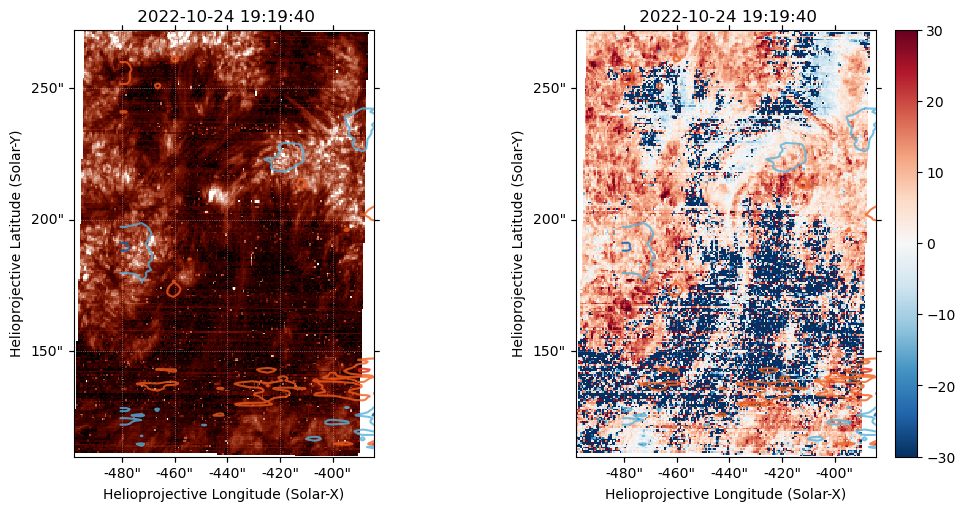

In [155]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=iris_SiIV_1394_intmap_rotate_shift_derot)
iris_SiIV_1394_intmap_rotate_shift_derot.plot(axes=ax1)

ax2 = fig.add_subplot(122,projection=iris_SiIV_1394_velmap_rotate_shift_derot)
im2 = iris_SiIV_1394_velmap_rotate_shift_derot.plot(axes=ax2)

plt.colorbar(im2,ax=ax2)

for ax_ in (ax1,ax2):
    eis_hhflare_195_velmap_derot.draw_contours(levels=[-10,-5,5,10],
        colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],axes=ax_,alpha=0.8)
    ax_.set_xlim([170,360])
    ax_.set_ylim([350,620])


In [268]:
iris_SiIV_1394_intmap_rotate_shift.save("../../src/IRIS/20221024/2322/fit_res/iris_SiIV_1394_intmap_rotate_shift.fits",overwrite=True)
iris_SiIV_1394_velmap_rotate_shift.save("../../src/IRIS/20221024/2322/fit_res/iris_SiIV_1394_velmap_rotate_shift.fits",overwrite=True)
iris_SiIV_1394_intmap_rotate_shift_derot.save("../../src/IRIS/20221024/2322/fit_res/iris_SiIV_1394_intmap_rotate_shift_derot.fits",overwrite=True)
iris_SiIV_1394_velmap_rotate_shift_derot.save("../../src/IRIS/20221024/2322/fit_res/iris_SiIV_1394_velmap_rotate_shift_derot.fits",overwrite=True)

In [156]:
iris_MgII_k_lc_intmap = sunpy.map.Map("../../src/IRIS/20221024/2322/fit_res/MgII_k_lc_int_map.fits")
iris_MgII_k_lc_intmap.meta["rsun_ref"] = aia_1700_map_2322_crop.meta["rsun_ref"]
iris_MgII_k_lc_intmap_rotate = iris_MgII_k_lc_intmap.rotate()
iris_MgII_k_lc_intmap_rotate_shift = iris_MgII_k_lc_intmap_rotate.shift_reference_coord(Txshift_iris_aia_2322,Tyshift_iris_aia_2322)
with propagate_with_solar_surface(rotation_model="rigid"):
    iris_MgII_k_lc_intmap_rotate_shift_derot = iris_MgII_k_lc_intmap_rotate_shift.reproject_to(aia_1700_map_crop.wcs)
iris_MgII_k_lc_intmap_rotate_shift_derot.plot_settings["cmap"] = "irissji2796"
iris_MgII_k_lc_intmap_rotate_shift_derot.plot_settings["norm"] = ImageNormalize(vmin=0,vmax=2e3,stretch=AsinhStretch(0.1))

For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs,dsun_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs,dsun_obs
 [sunpy.map.mapbase]
For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs,dsun_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs,dsun_obs
 [sunpy.map.mapbase]


In [157]:
iris_MgII_k_lc_velmap = sunpy.map.Map("../../src/IRIS/20221024/2322/fit_res/MgII_k_lc_vel_map.fits")
iris_MgII_k_lc_velmap.meta["rsun_ref"] = aia_1700_map_2322_crop.meta["rsun_ref"]
iris_MgII_k_lc_velmap_rotate = iris_MgII_k_lc_velmap.rotate()
iris_MgII_k_lc_velmap_rotate_shift = iris_MgII_k_lc_velmap_rotate.shift_reference_coord(Txshift_iris_aia_2322,Tyshift_iris_aia_2322)
with propagate_with_solar_surface(rotation_model="rigid"):
    iris_MgII_k_lc_velmap_rotate_shift_derot = iris_MgII_k_lc_velmap_rotate_shift.reproject_to(aia_1700_map_crop.wcs)
iris_MgII_k_lc_velmap_rotate_shift_derot.plot_settings["cmap"] = "RdBu_r"
iris_MgII_k_lc_velmap_rotate_shift_derot.plot_settings["norm"] = ImageNormalize(vmin=-15,vmax=15)

For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs,dsun_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs,dsun_obs
 [sunpy.map.mapbase]
For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs,dsun_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs,dsun_obs
 [sunpy.map.mapbase]


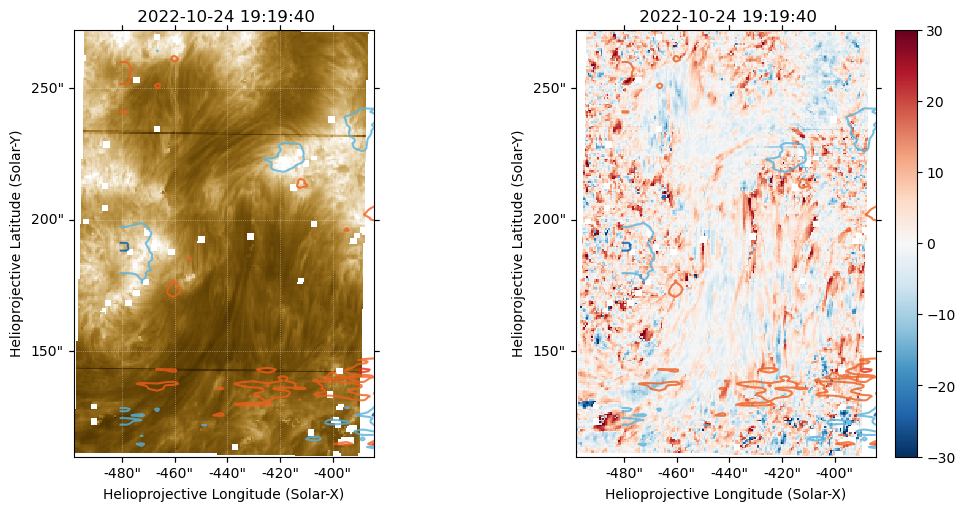

In [158]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=iris_MgII_k_lc_intmap_rotate_shift_derot)
iris_MgII_k_lc_intmap_rotate_shift_derot.plot(axes=ax1)

ax2 = fig.add_subplot(122,projection=iris_MgII_k_lc_velmap_rotate_shift_derot)
iris_MgII_k_lc_velmap_rotate_shift_derot.plot(axes=ax2)

plt.colorbar(im2,ax=ax2)

for ax_ in (ax1,ax2):
    eis_hhflare_195_velmap_derot.draw_contours(levels=[-10,-5,5,10],
        colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],axes=ax_,alpha=0.8)
    ax_.set_xlim([170,360])
    ax_.set_ylim([350,620])



In [159]:
spice_NeVIII_intmap = sunpy.map.Map("../../src/SPICE/20221024/lvl3/NeVIII_int_deconv_plowman2023.fits")
spice_NeVIII_intmap.meta["rsun_ref"] = aia_1600_map.meta["rsun_ref"]
spice_NeVIII_intmap.plot_settings['cmap'] = "sdoaia171"
spice_NeVIII_intmap.plot_settings['norm'] = ImageNormalize(vmin=0,vmax=10,stretch=AsinhStretch(0.1))

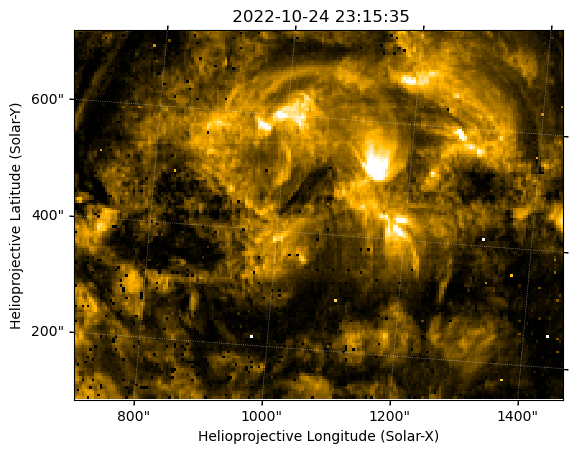

In [160]:
spice_NeVIII_intmap.plot()

In [161]:
with propagate_with_solar_surface(rotation_model="rigid"):
    spice_NeVIII_intmap_derot = spice_NeVIII_intmap.reproject_to(fsi_174_crop_shift.wcs)

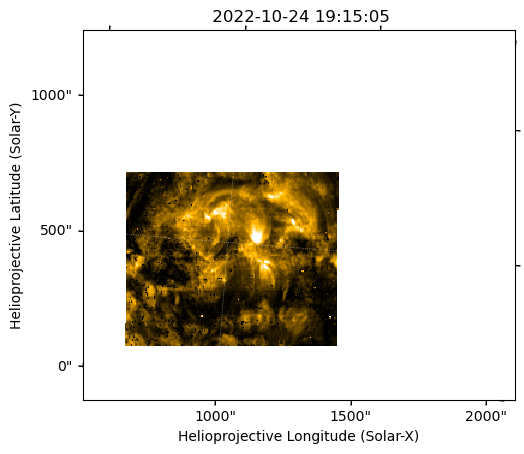

In [162]:
spice_NeVIII_intmap_derot.plot(aspect=fsi_174_crop_shift.scale.axis2/fsi_174_crop_shift.scale.axis1)

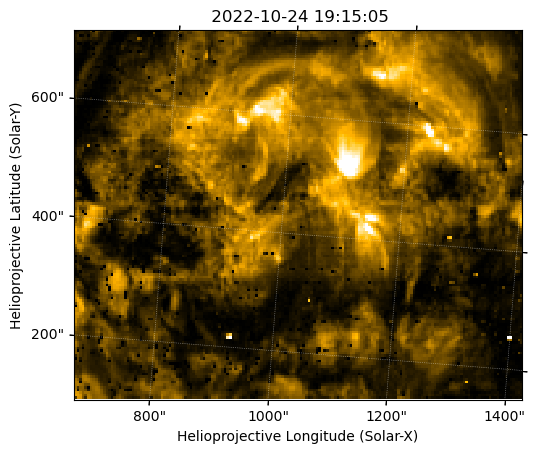

In [163]:
spice_NeVIII_intmap_derot_crop = spice_NeVIII_intmap_derot.submap([40,45]*u.pix,
                                                                  top_right=[210,185]*u.pix)
spice_NeVIII_intmap_derot_crop.plot(aspect=spice_NeVIII_intmap_derot_crop.scale.axis2/spice_NeVIII_intmap_derot_crop.scale.axis1)

In [164]:
spice_NeVIII_Txshift, spice_NeVIII_Tyshift = coalign_shift(fsi_174_crop_shift,spice_NeVIII_intmap_derot_crop)
print(spice_NeVIII_Txshift, spice_NeVIII_Tyshift)

-64.6569 arcsec 33.3423 arcsec


In [165]:
spice_NeVIII_intmap_derot_shift = spice_NeVIII_intmap_derot.shift_reference_coord(spice_NeVIII_Txshift,spice_NeVIII_Tyshift)
spice_NeVIII_intmap_derot_shift_hrifov = spice_NeVIII_intmap_derot_shift.reproject_to(hri_174_map_shifted_toaia.wcs)

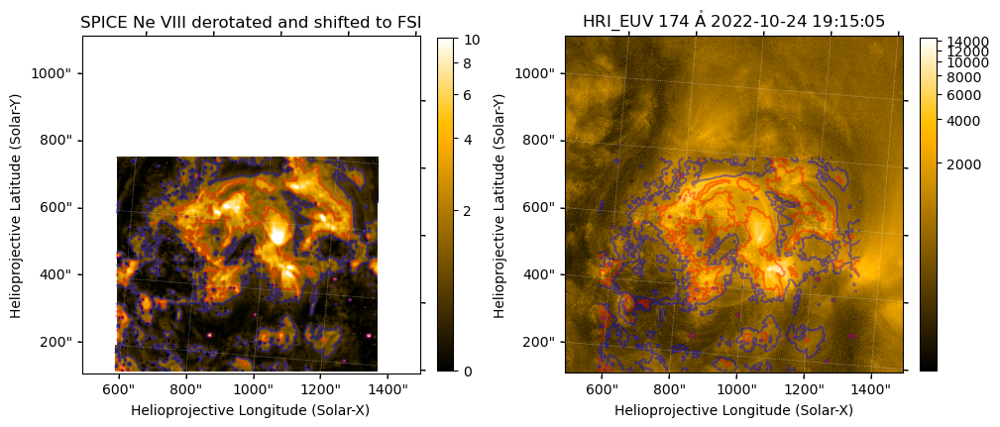

In [166]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=spice_NeVIII_intmap_derot_shift_hrifov)
im1 = spice_NeVIII_intmap_derot_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("SPICE Ne VIII derotated and shifted to FSI")

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = hri_174_map_shifted_toaia.plot()
plt.colorbar(ax=ax2,shrink=0.75)

spice_NeVIII_levels = [0.8,2]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    spice_NeVIII_intmap_derot_shift_hrifov.draw_contours(spice_NeVIII_levels,colors=["b","r"], axes=ax_, alpha=0.4)
    ax_.axis(bounds)

In [167]:
spice_NeVIII_velmap = sunpy.map.Map("../../src/SPICE/20221024/lvl3/NeVIII_vel_deconv_plowman2023.fits")
spice_NeVIII_velmap.meta["rsun_ref"] = aia_1600_map.meta["rsun_ref"]
spice_NeVIII_velmap.plot_settings['cmap'] = "RdBu_r"
spice_NeVIII_velmap.plot_settings['norm'] = ImageNormalize(vmin=-40,vmax=40)

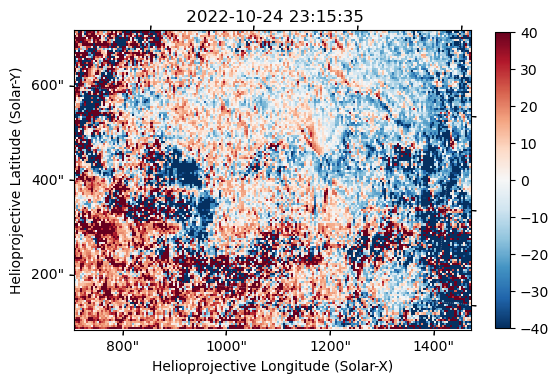

In [168]:
spice_NeVIII_velmap.plot()
plt.colorbar(shrink=0.8)

In [169]:
with propagate_with_solar_surface(rotation_model="rigid"):
    spice_NeVIII_velmap_derot = spice_NeVIII_velmap.reproject_to(fsi_174_crop_shift.wcs)

spice_NeVIII_velmap_derot_shift = spice_NeVIII_velmap_derot.shift_reference_coord(spice_NeVIII_Txshift,spice_NeVIII_Tyshift)
spice_NeVIII_velmap_derot_shift_hrifov = spice_NeVIII_velmap_derot_shift.reproject_to(hri_174_map_shifted_toaia.wcs)

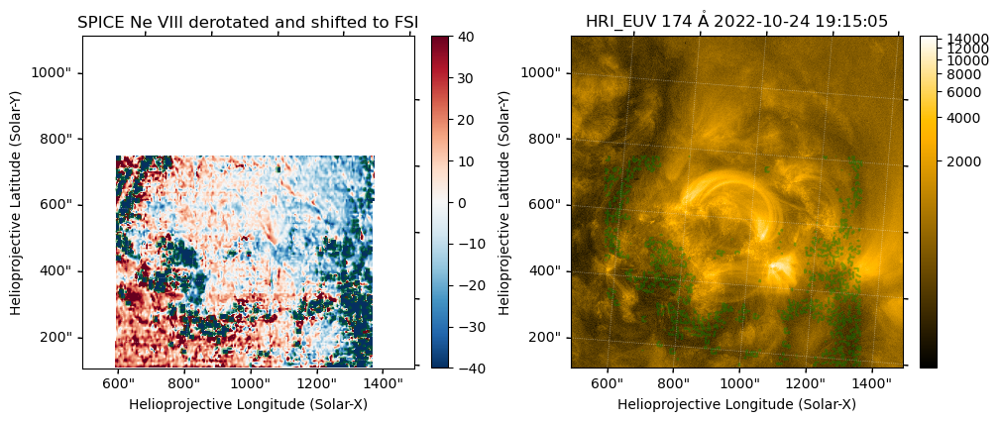

In [170]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=spice_NeVIII_velmap_derot_shift_hrifov)
im1 = spice_NeVIII_velmap_derot_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("SPICE Ne VIII derotated and shifted to FSI")

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = hri_174_map_shifted_toaia.plot()
plt.colorbar(ax=ax2,shrink=0.75)

spice_NeVIII_vel_levels = [-40]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    spice_NeVIII_velmap_derot_shift_hrifov.draw_contours(spice_NeVIII_vel_levels,colors=["green"], axes=ax_, alpha=0.4)
    ax_.axis(bounds)

In [171]:
SunBlinker(spice_NeVIII_velmap_derot_shift_hrifov, hri_174_map_shifted_toaia)

In [172]:
SunBlinker(spice_NeVIII_velmap_derot_shift_hrifov, eis_195_velmap_derot_repro_hrifov)

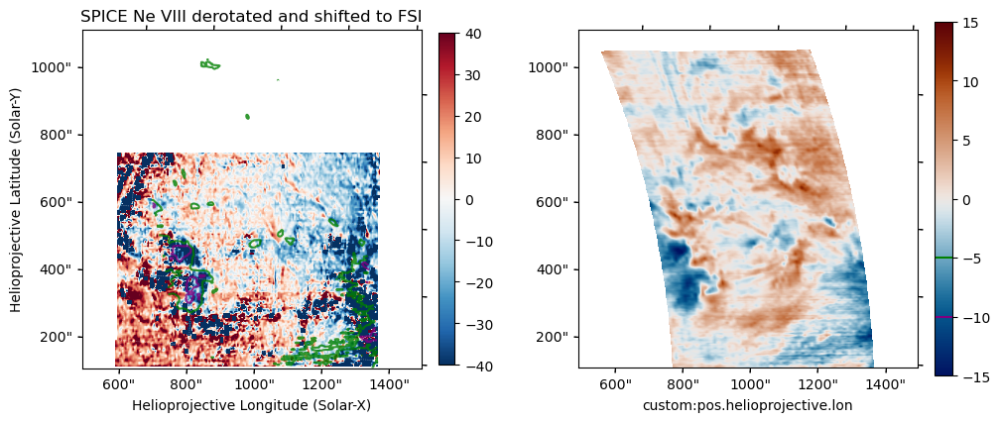

In [173]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=spice_NeVIII_velmap_derot_shift_hrifov)
im1 = spice_NeVIII_velmap_derot_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("SPICE Ne VIII derotated and shifted to FSI")

eis_195_velmap_derot_repro_hrifov.draw_contours(levels=[-10,-5],colors=["purple","green"],axes=ax1,alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = ax2.imshow(eis_195_velmap_derot_repro_hrifov.data,vmin=-15,vmax=15,cmap=cmcm.vik,origin="lower")
clb = plt.colorbar(im2,ax=ax2,shrink=0.8)

for level_, color_ in zip([-10,-5,],["purple","green"]):
    clb.ax.axhline(level_,color=color_)

bounds = ax1.axis()
# hri_174_map_shifted_toaia.draw_quadrangle([400,300]*u.pix,top_right=[800,800]*u.pix, 
#                                     axes=ax1, color="w", lw=1.5)
# hri_174_map_shifted_toaia.draw_quadrangle([1500,0]*u.pix,top_right=[2029,800]*u.pix, 
#                                     axes=ax1, color="w", lw=1.5)
ax1.axis(bounds)
ax2.set_ylabel(" ")

In [260]:
spice_NeVIII_intmap_derot_shift.save("../../src/coalign_map/20221024/spice_NeVIII_intmap_derot_shift.fits",overwrite=True)
spice_NeVIII_velmap_derot_shift.save("../../src/coalign_map/20221024/spice_NeVIII_velmap_derot_shift.fits",overwrite=True)
spice_NeVIII_velmap_derot_shift_hrifov.save("../../src/coalign_map/20221024/spice_NeVIII_velmap_derot_shift_hrifov.fits",overwrite=True)

In [175]:
eis_auto_fit_184_velmap = sunpy.map.Map("../../src/EIS/DHB_007_v2/20221025T0023/sunpymaps/eis_auto_fit_184_velmap.fits")
eis_auto_fit_184_velmap.meta["rsun_ref"] = aia_193_map_crop.meta["rsun_ref"]
eis_auto_fit_184_velmap.plot_settings['cmap'] = "RdBu_r"
eis_auto_fit_184_velmap.plot_settings['norm'] = ImageNormalize(vmin=-15,vmax=15)

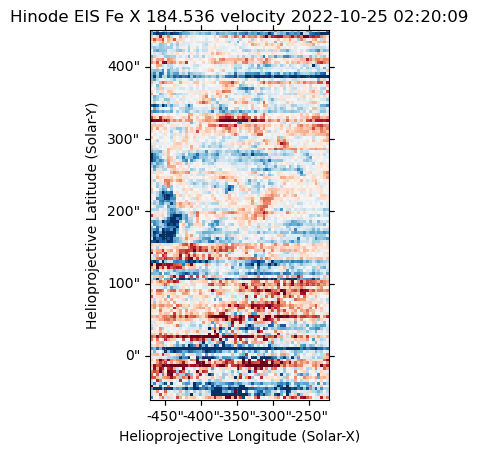

In [176]:
eis_auto_fit_184_velmap.plot()

In [177]:
eis_auto_fit_184_velmap_shift = eis_auto_fit_184_velmap.shift_reference_coord(eis_to_aia_Txshift, eis_to_aia_Tyshift)
with propagate_with_solar_surface(rotation_model="rigid"):
    eis_auto_fit_184_velmap_shift_derot = eis_auto_fit_184_velmap_shift.reproject_to(aia_193_map_crop.wcs)

eis_auto_fit_184_velmap_shift_derot_repro = eis_auto_fit_184_velmap_shift_derot.reproject_to(fsi_304_crop_shift.wcs)
eis_auto_fit_184_velmap_shift_derot_repro_hrifov = eis_auto_fit_184_velmap_shift_derot.reproject_to(hri_174_map_shifted_toaia.wcs)

/home/yjzhu/.local/lib/python3.11/site-packages/astropy/visualization/wcsaxes/patches.py:196: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  super().__init__(vertices, **kwargs)


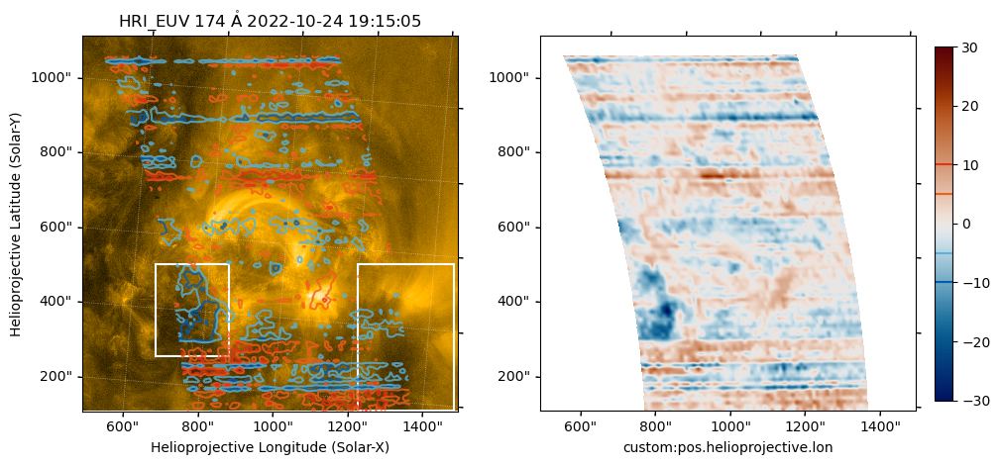

In [178]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hri_174_map_shifted_toaia)
im1 = hri_174_map_shifted_toaia.plot()

eis_auto_fit_184_velmap_shift_derot_repro_hrifov.draw_contours(levels=[-10,-5,5,10],colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],axes=ax1,alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = ax2.imshow(eis_auto_fit_184_velmap_shift_derot_repro_hrifov.data,vmin=-30,vmax=30,cmap=cmcm.vik,origin="lower")
clb = plt.colorbar(im2,ax=ax2,shrink=0.8)
for level_, color_ in zip([-10,-5,5,10],["#005CAF","#58B2DC","#F05E1C","#E83015"]):
    clb.ax.axhline(level_,color=color_)

bounds = ax1.axis()
hri_174_map_shifted_toaia.draw_quadrangle([400,300]*u.pix,top_right=[800,800]*u.pix, 
                                    axes=ax1, color="w", lw=1.5)
hri_174_map_shifted_toaia.draw_quadrangle([1500,0]*u.pix,top_right=[2029,800]*u.pix, 
                                    axes=ax1, color="w", lw=1.5)
ax1.axis(bounds)
ax2.set_ylabel(" ")

In [179]:
seed_pixels = np.where(eis_auto_fit_184_velmap_shift_derot_repro_hrifov.data < - 30)
seed_pixels_skycoord = eis_auto_fit_184_velmap_shift_derot_repro_hrifov.pixel_to_world(seed_pixels[1]*u.pix,seed_pixels[0]*u.pix)

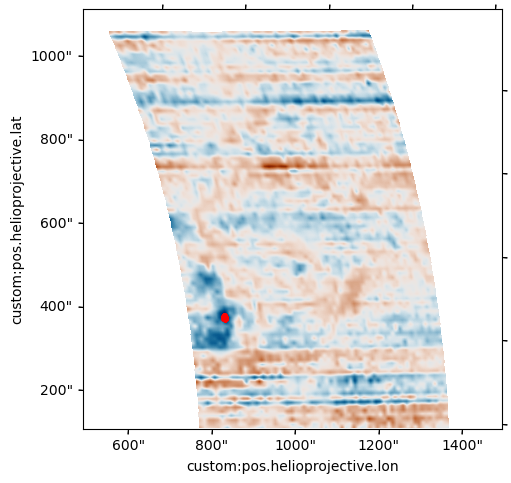

In [180]:
fig = plt.figure(figsize=(5,5),constrained_layout=True)
ax1 = fig.add_subplot(111,projection=hri_174_map_shifted_toaia)
im1 = ax1.imshow(eis_auto_fit_184_velmap_shift_derot_repro_hrifov.data,vmin=-30,vmax=30,cmap=cmcm.vik,origin="lower")

# ax1.scatter(seed_pixels[1],seed_pixels[0],color="r",s=1)
ax1.plot_coord(seed_pixels_skycoord,marker="o",markersize=2,linestyle="None",color="r")

In [181]:
vel_seed_FeX_184 = np.nanmean(eis_auto_fit_184_velmap_shift_derot_repro_hrifov.data[seed_pixels])
vel_seed_NeVIII_770 = np.nanmean(spice_NeVIII_velmap_derot_shift_hrifov.data[seed_pixels])

In [182]:
print(vel_seed_FeX_184, vel_seed_NeVIII_770)

-31.641691472228146 -37.67602884553157


In [183]:
hinode_observer = eis_195_intmap_shift.observer_coordinate
spice_observer = spice_NeVIII_intmap.observer_coordinate
hinode_observer_spice_frame = hinode_observer.transform_to(spice_observer.frame)
with propagate_with_solar_surface(rotation_model="rigid"):
    seed_pixel_coord0_spice_frame = seed_pixels_skycoord[0].transform_to(spice_observer.frame)

In [184]:
# return unit vector pointing from coord1 to coord2
def get_unit_vector(coord1,coord2):
    xyz = coord2.cartesian.xyz - coord1.cartesian.xyz
    return xyz/np.linalg.norm(xyz)

In [185]:
seed_pixel_coord0_spice_frame.cartesian.xyz/np.linalg.norm(seed_pixel_coord0_spice_frame.cartesian.xyz)

<Quantity [ 0.8417969 , -0.47124256,  0.26326493]>

In [186]:
hinode_unit_vec = get_unit_vector(seed_pixel_coord0_spice_frame,hinode_observer_spice_frame).value
hinode_unit_vec

array([0.99615627, 0.00444171, 0.08748119])

In [187]:
spice_unit_vec = get_unit_vector(seed_pixel_coord0_spice_frame,spice_observer).value
spice_unit_vec

array([ 0.62766931, -0.77051523,  0.11107442])

In [188]:
epipolar_plane_normvec = np.cross(hinode_unit_vec,spice_unit_vec)

In [189]:
angle_hinode_spice = np.arccos(np.dot(hinode_unit_vec,spice_unit_vec))*u.rad

In [190]:
matrix_A = np.array([hinode_unit_vec,spice_unit_vec,epipolar_plane_normvec])
vector_B = np.array([np.abs(vel_seed_FeX_184),np.abs(vel_seed_NeVIII_770),0])

vec_ep = np.linalg.solve(matrix_A,vector_B)

In [191]:
vec_ep

array([ 31.47726344, -22.61961373,   4.41109573])

In [192]:
vec_eq_mag = np.linalg.norm(vec_ep)

In [193]:
fake_vec_eq_xyz = seed_pixel_coord0_spice_frame.cartesian.xyz + vec_ep*0.005*const.R_sun

In [194]:
fake_vec_eq_coord = SkyCoord(fake_vec_eq_xyz[0],fake_vec_eq_xyz[1],fake_vec_eq_xyz[2],frame=spice_observer.frame,
                             representation_type="cartesian").transform_to("heliographic_stonyhurst")

In [195]:
with propagate_with_solar_surface(rotation_model="rigid"):
    fake_vec_arrow_to_plot = astropy.coordinates.concatenate((fake_vec_eq_coord.transform_to(hri_174_map_shifted_toaia.coordinate_frame),
                                                            seed_pixel_coord0_spice_frame.transform_to(hri_174_map_shifted_toaia.coordinate_frame)))

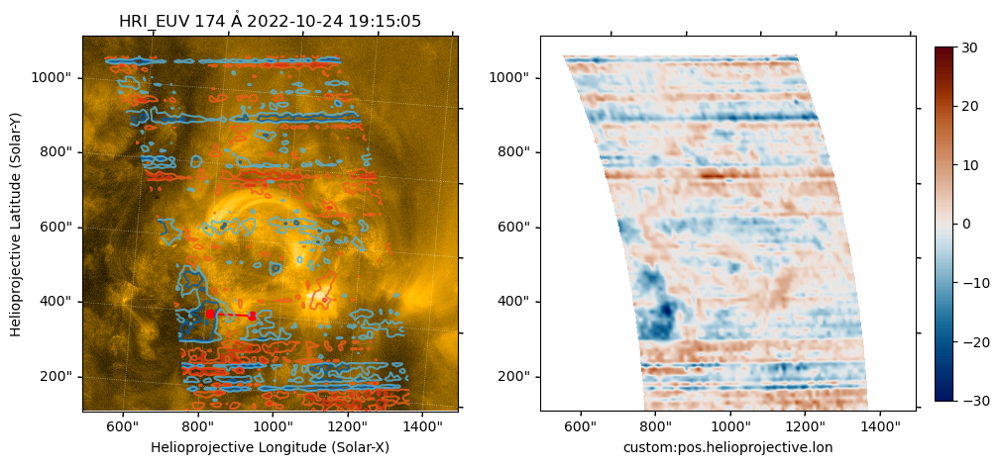

In [196]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hri_174_map_shifted_toaia)
im1 = hri_174_map_shifted_toaia.plot()
ax1.plot_coord(fake_vec_arrow_to_plot,marker="o",linestyle="-",color="r")

eis_auto_fit_184_velmap_shift_derot_repro_hrifov.draw_contours(levels=[-10,-5,5,10],colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],axes=ax1,alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = ax2.imshow(eis_auto_fit_184_velmap_shift_derot_repro_hrifov.data,vmin=-30,vmax=30,cmap=cmcm.vik,origin="lower")
clb = plt.colorbar(im2,ax=ax2,shrink=0.8)
# for level_, color_ in zip([-10,-5,5,10],["#005CAF","#58B2DC","#F05E1C","#E83015"]):
#     clb.ax.axhline(level_,color=color_)


ax2.set_ylabel(" ")

In [197]:
def coord_to_heexy(coord,hee_frame):
    coord = coord.transform_to(hee_frame)
    coord.representation_type = 'cartesian'
    return coord.y.to_value('AU'), coord.x.to_value('AU')

In [198]:
def get_first_orbit(coord,hee_frame):
    lon = coord.transform_to(hee_frame).spherical.lon
    shifted = astropy.coordinates.Longitude(lon - lon[0])
    ends = np.flatnonzero(np.diff(shifted) < 0)
    if ends.size > 0:
        return coord[:ends[0]+1]
    return coord

In [199]:
planets = ['Earth']
times = spice_observer.obstime + np.arange(700) * u.day
planet_coords = {planet: get_first_orbit(get_body_heliographic_stonyhurst(planet, times),spice_observer.frame)
                 for planet in planets}

In [200]:
missions = ['Parker Solar Probe', 'Solar Orbiter',]
mission_labels = {'Parker Solar Probe': 'PSP', 'Solar Orbiter': 'SO'}
mission_coords = {mission: get_first_orbit(get_horizons_coord(mission, {'start': spice_observer.obstime,
                                                                        'stop': spice_observer.obstime + 1.2 * u.yr,
                                                                        'step': '1d'}),spice_observer.frame)
                  for mission in missions}

INFO: Obtained JPL HORIZONS location for Parker Solar Probe (spacecraft) [sunpy.coordinates.ephemeris]
INFO: Obtained JPL HORIZONS location for Solar Orbiter (spacecraft) (-144 [sunpy.coordinates.ephemeris]


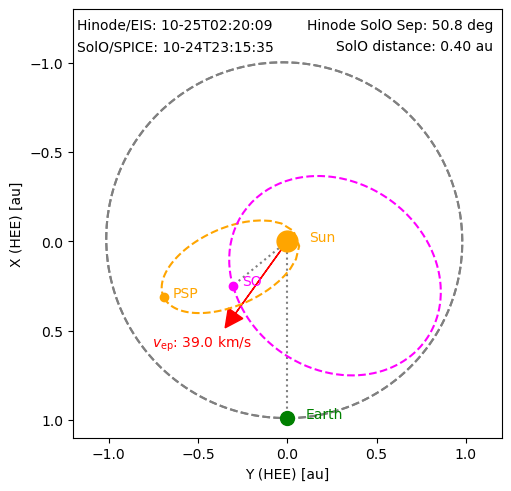

In [201]:
fig, ax = plt.subplots(figsize=(5,5),constrained_layout=True)

ax.set_xlim(-1.2, 1.2)
ax.set_ylim(1.1, -1.3)
ax.set_aspect('equal')
ax.plot([0, 0], [0, 1], linestyle='dotted', color='gray')

for planet, coord in planet_coords.items():
    ax.plot(*coord_to_heexy(coord,spice_observer.frame), linestyle='dashed', color='gray')

    if planet == 'Earth':
        color, markersize, offset = 'lime', 10, 0.1
    else:
        color, markersize, offset = 'gray', None, 0.05

for mission, coord in mission_coords.items():
    color = 'magenta' if mission == 'Solar Orbiter' else 'orange'

    ax.plot(*coord_to_heexy(coord,spice_observer.frame), linestyle='dashed', color=color)

    x, y = coord_to_heexy(coord[0],spice_observer.frame)
    if mission == 'Solar Orbiter':
        ax.plot([0, 1*x], [0, 1*y], linestyle='dotted', color='gray')
    ax.plot(x, y, 'o', color=color)

    ax.text(x + 0.05, y, mission_labels[mission], color=color)

for planet, coord in planet_coords.items():
    ax.plot(*coord_to_heexy(coord,spice_observer.frame), linestyle='dashed', color='gray')

    if planet == 'Earth':
        color, markersize, offset = 'green', 10, 0.1
    else:
        color, markersize, offset = 'gray', None, 0.05

    x, y = coord_to_heexy(coord[0],spice_observer.frame)
    ax.plot(x, y, 'o', markersize=markersize, color=color)
    ax.text(x + offset, y, planet, color=color)

ax.plot(0, 0, 'o', markersize=15, color='orange')
ax.text(0.12, 0, 'Sun', color='orange')

ax.set_xlabel('Y (HEE) [au]')
ax.set_ylabel('X (HEE) [au]')

ax.text(0.98,0.98,f"Hinode SolO Sep: {angle_hinode_spice.to(u.deg).value:.1f} deg",transform=ax.transAxes,ha="right",va="top")
ax.text(0.98,0.93,f"SolO distance: {spice_observer.radius.to(u.au).value:.2f} au",transform=ax.transAxes,ha="right",va="top")
ax.text(0.3,0.22,r"$v_{{\rm ep}}$: {:.1f} km/s".format(np.linalg.norm(vec_ep)),transform=ax.transAxes,ha="center",va="center",
        color="red")

ax.text(0.01,0.98,f"Hinode/EIS: {hinode_observer.obstime.isot[5:-4]}",transform=ax.transAxes,ha="left",va="top")
ax.text(0.01,0.93,f"SolO/SPICE: {spice_observer.obstime.isot[5:-4]}",transform=ax.transAxes,ha="left",va="top")

ax.arrow(0, 0, vec_ep[1]/np.linalg.norm(vec_ep)/2, vec_ep[0]/np.linalg.norm(vec_ep)/2, head_width=0.1, head_length=0.1, fc='r', ec='r')

plt.savefig("../../figs/test_figs/epipolar_velocity.png",dpi=300,bbox_inches="tight")

In [202]:
hri_174_map_shifted_toaia_all_coord = sunpy.map.all_coordinates_from_map(hri_174_map_shifted_toaia)

In [203]:
hri_174_map_shifted_toaia_all_coord = hri_174_map_shifted_toaia_all_coord.make_3d()

In [204]:
hri_174_map_shifted_toaia_all_coord_hee = hri_174_map_shifted_toaia_all_coord.transform_to(hri_174_map_shifted_toaia.observer_coordinate)

In [205]:
with propagate_with_solar_surface(rotation_model="rigid"):
    hri_174_map_shifted_toaia_all_coord_hee_spice = hri_174_map_shifted_toaia_all_coord_hee.transform_to(spice_observer.frame)

In [206]:
hri_174_map_shifted_toaia_3d_grid = pv.StructuredGrid(hri_174_map_shifted_toaia_all_coord_hee_spice.cartesian.x.to_value("AU"),
                                                      hri_174_map_shifted_toaia_all_coord_hee_spice.cartesian.y.to_value("AU"),
                                                     hri_174_map_shifted_toaia_all_coord_hee_spice.cartesian.z.to_value("AU"))

In [207]:
seed_pixel_coord0_spice_frame

<SkyCoord (HeliographicStonyhurst: obstime=2022-10-24T23:15:35.745, rsun=696000.0 km): (lon, lat, radius) in (deg, deg, m)
    (-29.24034318, 15.26388037, 6.96e+08)>

In [208]:
seed_pixel_coord0_spice_frame.cartesian.xyz.to_value("AU")

array([ 0.00391644, -0.00219244,  0.00122483])

In [209]:
# pv_plotter = pv.Plotter(notebook=True)

# hri_174_map_shifted_toaia_3d_norm = ImageNormalize(vmin=0,vmax=1.5e4,stretch=AsinhStretch(0.05))
# pv_plotter.add_mesh(hri_174_map_shifted_toaia_3d_grid,scalars=hri_174_map_shifted_toaia_3d_norm(hri_174_map_shifted_toaia.data), cmap="solar orbiterhri_euv174")
# pv_plotter.add_arrows(seed_pixel_coord0_spice_frame.cartesian.xyz.to_value("AU"),vec_ep, mag=1e-5,color="lime")
# pv_plotter.add_axes(line_width=5, labels_off=False)
# pv_plotter.show()
# pv_plotter.export_vtksz("../../figs/test_figs/hri_174_map_shifted_toaia_3d.vtksz")

# del pv_plotter


In [210]:
with fits.open("../../src/CHASE/20221024/RSM20221024T191230_0022_HA.fits") as hdul:
    hdul.info()
    chase_header = deepcopy(hdul[1].header)
    chase_halpha_core_data = hdul[1].data[68,:,:]
    chase_halpha_blue_wing_data = hdul[1].data[45,:,:]
    chase_SiI_core_data = hdul[1].data[3,:,:]
    average_halpha_profile = np.nanmean(hdul[1].data[:,:,:],axis=(1,2))

Filename: ../../src/CHASE/20221024/RSM20221024T191230_0022_HA.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       4   ()      
  1  COMPRESSED_IMAGE    1 CompImageHDU     48   (2304, 2313, 118)   int16   


In [211]:
chase_header

XTENSION= 'IMAGE   '           / binary table extension                         
BITPIX  =                   16 / data type of original image                    
NAXIS   =                    3 / Number of data axes                            
NAXIS1  =                 2304 / Length of data axis 1 (slit dimension)         
NAXIS2  =                 2313 / Length of data axis 2 (scanning steps)         
NAXIS3  =                  118 / Length of data axis 3 (wavelength dimension)   
PCOUNT  =                    0 / number of group parameters                     
GCOUNT  =                    1 / number of groups                               
TELESCOP= 'CHASE-HIS'          / Telescop Name                                  
BIN     =                    2 / Binning mode                                   
DATE_OBS= '2022-10-24T19:12:30' / Observation time                              
CRPIX1  =               1151.5 / X coordinate of solar center in pixel          
CUNIT1  = 'arcsec  '        

In [212]:
chase_fits_header = sunpy.map.make_fitswcs_header(chase_halpha_core_data.shape,
                                                  SkyCoord(chase_header["CRVAL1"]*u.arcsec,chase_header["CRVAL2"]*u.arcsec,
                                                           obstime=chase_header["DATE_OBS"],observer="Earth",frame="helioprojective",
                                                           rsun=aia_1600_map.reference_coordinate.rsun),
                                                  reference_pixel=[chase_header["CRPIX1"],chase_header["CRPIX2"]]*u.pix,
                                                  scale=u.Quantity([0.5218*2,0.5218*2],u.arcsec/u.pix),
                                                  rotation_angle=-chase_header["INST_ROT"]*u.deg,
                                                  telescope="CHASE",instrument="RSM")

In [213]:
chase_wavelength = (np.arange(chase_header["NAXIS3"]) + 1 - (chase_header["CRPIX3"] + 1))*chase_header["CDELT3"] + chase_header["CRVAL3"]
# it seems that the crpix3 is 0, which is not consistent with the FITS index starting from 1
# so I will add 1 to the crpix3

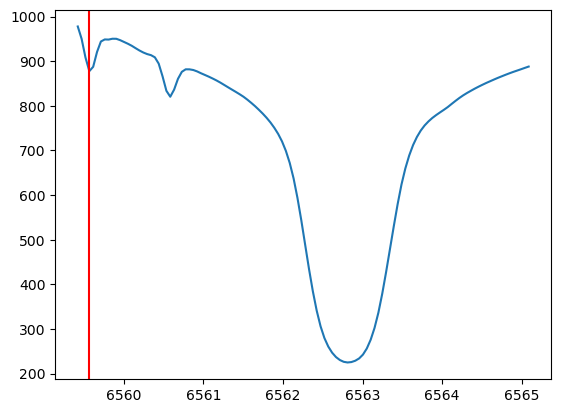

In [214]:
plt.plot(chase_wavelength,average_halpha_profile)
plt.axvline(chase_wavelength[3],color="r")


(<matplotlib.patches.Circle at 0x7f85813ff510>, None)

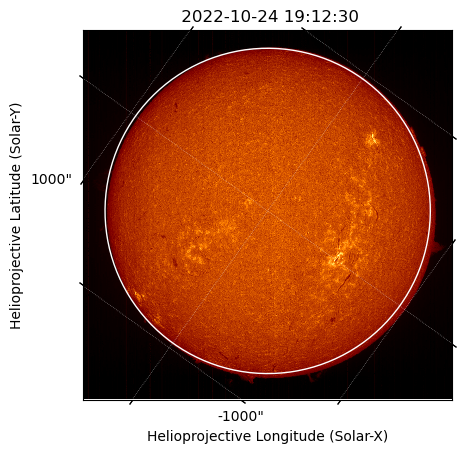

In [215]:
chase_halpha_core_map = sunpy.map.Map(np.nan_to_num(chase_halpha_core_data,nan=0).astype(np.float32),chase_fits_header)
chase_halpha_core_map = chase_halpha_core_map.submap([100,100]*u.pix,top_right=[2200,2200]*u.pix)
chase_halpha_core_map.plot_settings['cmap'] = "afmhot"
chase_halpha_core_map.plot()
chase_halpha_core_map.draw_limb()


(<matplotlib.patches.Circle at 0x7f857ce9f210>, None)

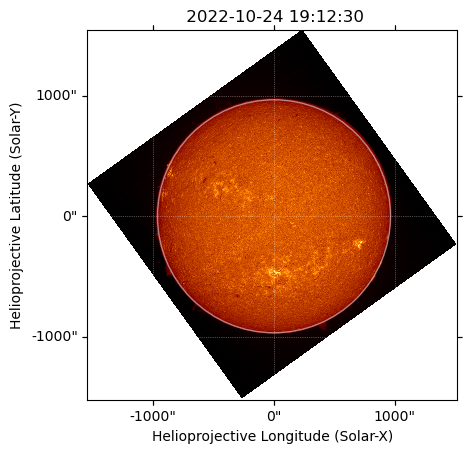

In [216]:
chase_halpha_core_map_north = chase_halpha_core_map.rotate().shift_reference_coord(5*u.arcsec,25*u.arcsec)
chase_halpha_core_map_north.plot()
chase_halpha_core_map_north.draw_limb(alpha=0.5)

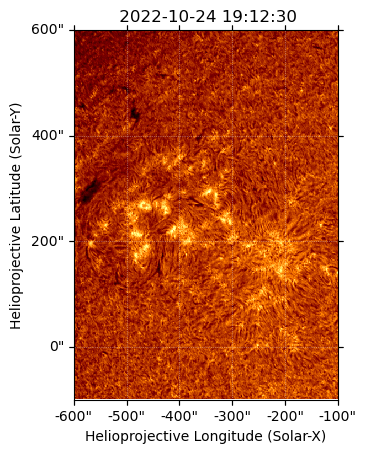

In [217]:
chase_halpha_core_map_crop = chase_halpha_core_map_north.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=chase_halpha_core_map_north.coordinate_frame),
                                                                top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=chase_halpha_core_map_north.coordinate_frame))
chase_halpha_core_map_crop.plot()

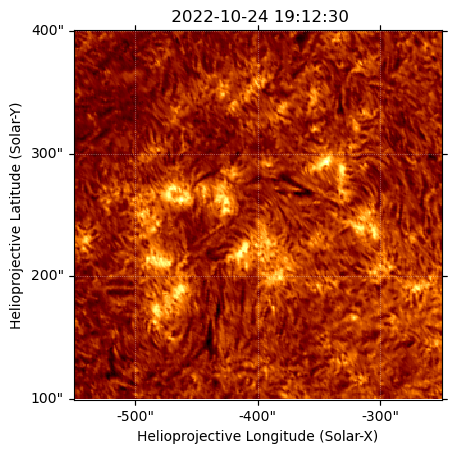

In [218]:
chase_halpha_core_map_align = chase_halpha_core_map_crop.submap(SkyCoord(-550*u.arcsec,100*u.arcsec,frame=chase_halpha_core_map_crop.coordinate_frame),
                                                                top_right=SkyCoord(-250*u.arcsec,400*u.arcsec,frame=chase_halpha_core_map_crop.coordinate_frame))
chase_halpha_core_map_align.plot()

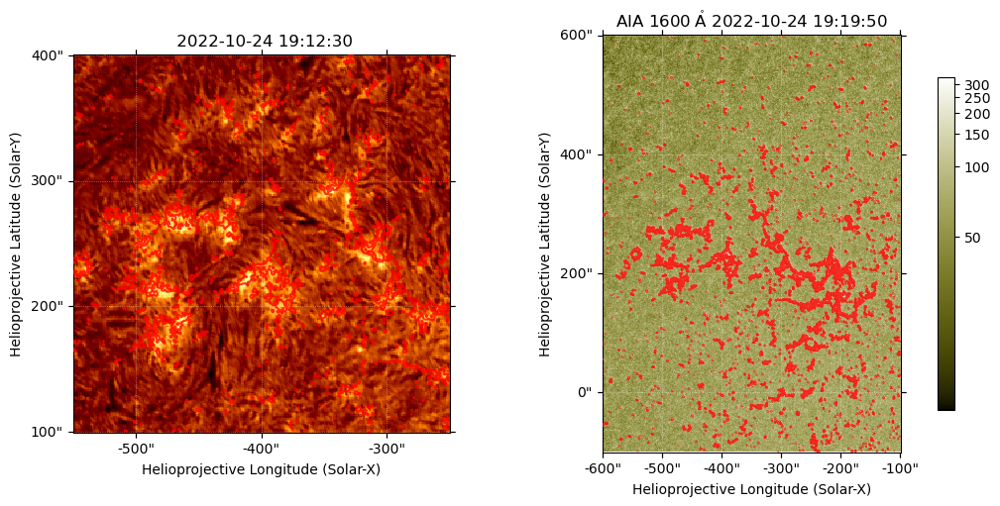

In [219]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=chase_halpha_core_map_align)
im1 = chase_halpha_core_map_align.plot()

ax2 = fig.add_subplot(122,projection=aia_1600_map_crop)
im2 = aia_1600_map_crop.plot()
plt.colorbar(im2,ax=ax2,shrink=0.8)

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_1600_map_crop.draw_contours(levels=[120]*aia_1600_map_crop.unit,colors=["r"],axes=ax_,alpha=0.8)
    ax_.axis(bounds)

In [220]:
aia_1600_resample_nx = (aia_1600_map_crop.scale.axis1 * aia_1600_map_crop.dimensions.x).to(u.arcsec) / chase_halpha_core_map_align.scale.axis1
aia_1600_resample_ny = (aia_1600_map_crop.scale.axis2 * aia_1600_map_crop.dimensions.y).to(u.arcsec) / chase_halpha_core_map_align.scale.axis2
aia_1600_map_crop_resample = aia_1600_map_crop.resample(u.Quantity([aia_1600_resample_nx, aia_1600_resample_ny]))
Txshift_chase_aia, Tyshift_chase_aia = coalign_shift(aia_1600_map_crop_resample,chase_halpha_core_map_align)
print(Txshift_chase_aia, Tyshift_chase_aia)

2.69367 arcsec 4.25398 arcsec


In [221]:
chase_halpha_core_map_align_shift = chase_halpha_core_map_align.shift_reference_coord(Txshift_chase_aia,Tyshift_chase_aia)
aia_1600_map_crop_chase_halpha_fov = aia_1600_map_crop.reproject_to(chase_halpha_core_map_align_shift.wcs)

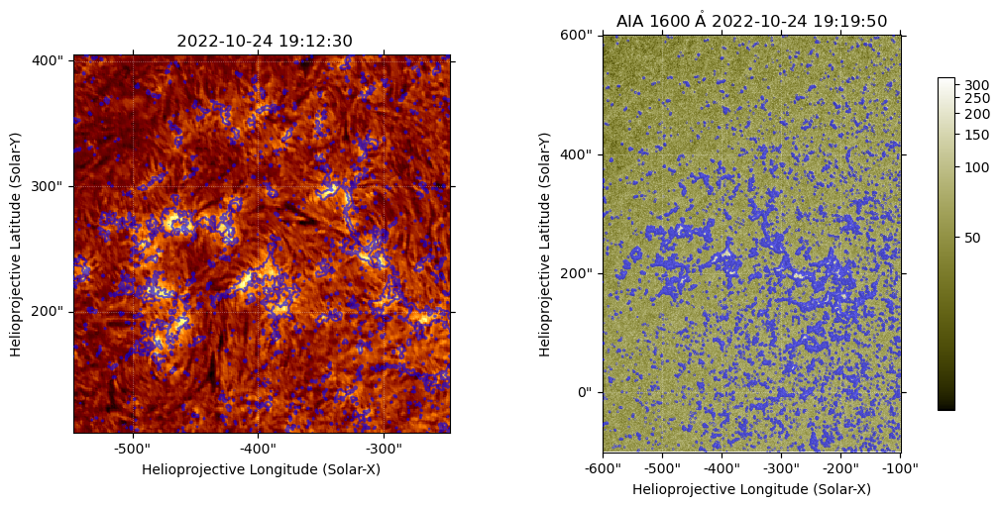

In [222]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=chase_halpha_core_map_align_shift)
im1 = chase_halpha_core_map_align_shift.plot()

ax2 = fig.add_subplot(122,projection=aia_1600_map_crop)
im2 = aia_1600_map_crop.plot()
plt.colorbar(im2,ax=ax2,shrink=0.8)

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_1600_map_crop.draw_contours(levels=[100]*aia_1600_map_crop.unit,colors=["b"],axes=ax_,alpha=0.6)
    ax_.axis(bounds)

In [223]:
SunBlinker(aia_1600_map_crop_chase_halpha_fov, chase_halpha_core_map_align_shift)

In [224]:
chase_halpha_line_width_map = sunpy.map.Map("../../src/CHASE/20221024/RSM20221024T191230_0022_HA_linewidth.fits")
chase_halpha_line_width_map.meta["rsun_ref"] = aia_1600_map.meta["rsun_ref"]
chase_halpha_line_width_map.plot_settings['cmap'] = "plasma"
chase_halpha_line_width_map.plot_settings['norm'] = ImageNormalize(vmin=0.9,vmax=1.35)

In [225]:
chase_halpha_line_width_map_north = chase_halpha_line_width_map.rotate().shift_reference_coord(5*u.arcsec,25*u.arcsec)
chase_halpha_line_width_map_crop = chase_halpha_line_width_map_north.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=chase_halpha_line_width_map_north.coordinate_frame),
                                                                top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=chase_halpha_line_width_map_north.coordinate_frame))
chase_halpha_line_width_map_crop_shift = chase_halpha_line_width_map_crop.shift_reference_coord(Txshift_chase_aia,Tyshift_chase_aia)
chase_halpha_line_width_map_align = chase_halpha_line_width_map_crop_shift.submap(SkyCoord(-550*u.arcsec,100*u.arcsec,frame=chase_halpha_line_width_map_crop_shift.coordinate_frame),
                                                                top_right=SkyCoord(-250*u.arcsec,400*u.arcsec,frame=chase_halpha_line_width_map_crop_shift.coordinate_frame))
chase_halpha_line_width_map_align_shift = chase_halpha_line_width_map_align.shift_reference_coord(Txshift_chase_aia,Tyshift_chase_aia)
                                                                                 

/home/yjzhu/.local/lib/python3.11/site-packages/astropy/visualization/wcsaxes/patches.py:196: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  super().__init__(vertices, **kwargs)


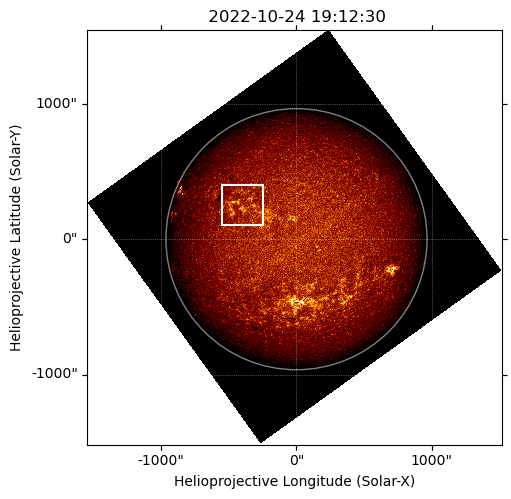

In [226]:
fig = plt.figure(figsize=(5,5),constrained_layout=True)

ax = fig.add_subplot(111,projection=chase_halpha_core_map_north)
chase_halpha_core_map_north.plot(axes=ax)
chase_halpha_core_map_north.draw_limb(alpha=0.5,axes=ax)
chase_halpha_line_width_map_align_shift.draw_quadrangle(chase_halpha_line_width_map_align_shift.bottom_left_coord,
                                                        top_right=chase_halpha_line_width_map_align_shift.top_right_coord,axes=ax,
                                                        color="w",lw=1.5)

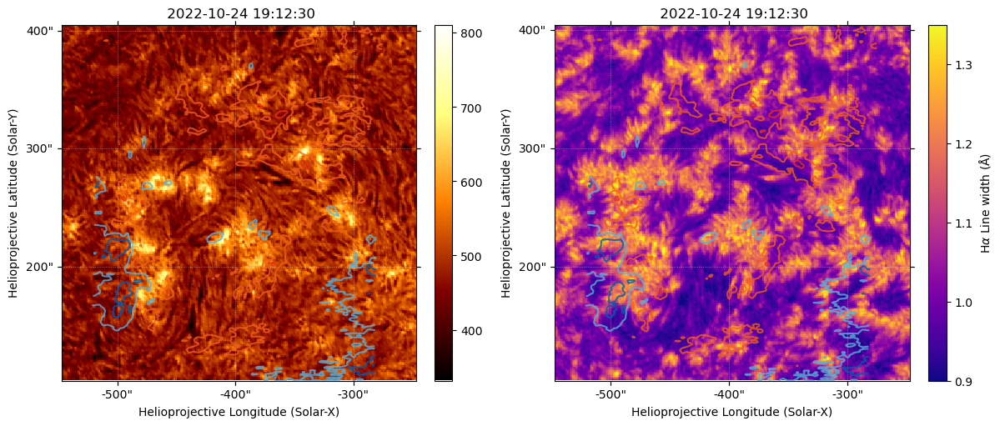

In [227]:
fig = plt.figure(figsize=(12,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=chase_halpha_core_map_align_shift)
im1 = chase_halpha_core_map_align_shift.plot()
clb1 = plt.colorbar(im1,ax=ax1,shrink=1)

ax2 = fig.add_subplot(122,projection=chase_halpha_line_width_map_align_shift)
im2 = chase_halpha_line_width_map_align_shift.plot()
clb2 = plt.colorbar(im2,ax=ax2,shrink=1)
clb2.set_label(r"H$\alpha$ Line width (Å)")

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    with propagate_with_solar_surface(rotation_model="rigid"):
        eis_195_velmap_derot.draw_contours(levels=[-10,-5,5,10],colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],axes=ax_,alpha=0.8)
    ax_.axis(bounds)

# plt.savefig("../../figs/test_figs/chase_halpha_core_line_width.png",dpi=300,bbox_inches="tight")

In [263]:
chase_halpha_core_map_align_shift.save("../../src/coalign_map/20221024/chase_halpha_core_map_align_shift.fits",overwrite=True)
chase_halpha_line_width_map_align_shift.save("../../src/coalign_map/20221024/chase_halpha_line_width_map_align_shift.fits",overwrite=True)

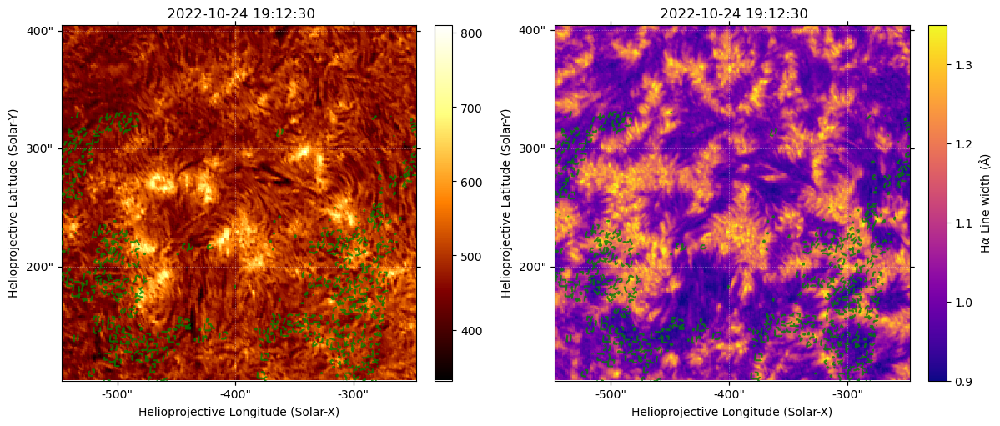

In [228]:
fig = plt.figure(figsize=(12,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=chase_halpha_core_map_align_shift)
im1 = chase_halpha_core_map_align_shift.plot()
clb1 = plt.colorbar(im1,ax=ax1,shrink=1)

ax2 = fig.add_subplot(122,projection=chase_halpha_line_width_map_align_shift)
im2 = chase_halpha_line_width_map_align_shift.plot()
clb2 = plt.colorbar(im2,ax=ax2,shrink=1)
clb2.set_label(r"H$\alpha$ Line width (Å)")

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    spice_NeVIII_velmap_derot_shift_hrifov.draw_contours(levels=[-40],colors=["green"],axes=ax_,alpha=0.8)
    ax_.axis(bounds)

In [229]:
dkist_fitv_tom = np.load('../../src/DKIST/BKEWK/inverted/bkewk_fitv_repeats_v3.npy')

# rewrap the azimuths of the fits from Tom Schad
fitv_wrap = np.copy(dkist_fitv_tom)
azit = np.copy(fitv_wrap[2,:,:])
azit[(azit > 179)] = azit[(azit > 179)] - 180
azit[(azit < 0)] = 180 + azit[(azit < 0)]
fitv_wrap[2,:,:] = azit
dkist_fitv_tom = fitv_wrap


In [230]:
dkist_fitv_tom_btot = dkist_fitv_tom[0,:,:]
dkist_fitv_tom_theta = dkist_fitv_tom[1,:,:]
dkist_fitv_tom_azimuth = dkist_fitv_tom[2,:,:]
dkist_fitv_tom_cont_int = dkist_fitv_tom[9,:,:]
dkist_fitv_tom_DoppVel = (dkist_fitv_tom[3,:,:]) - (dkist_fitv_tom[11,:,:] - 6302.003953369682 ) / 6302.003953369682*3e5
dkist_fitv_tom_DoppVel = dkist_fitv_tom_DoppVel - np.median(dkist_fitv_tom_DoppVel)


In [231]:
extent_visp_tom = [-422.5, -385.65654869, 165, 241.139]

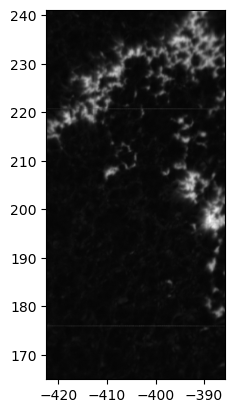

In [232]:
plt.imshow(dkist_fitv_tom_btot.T,origin="lower",cmap="grey",extent=extent_visp_tom)

In [233]:
dkist_fitv_tom_btot.shape

(688, 2555)

In [234]:
dkist_visp_wcs_tom = sunpy.map.make_fitswcs_header(dkist_fitv_tom_btot.T.shape,
                                                    SkyCoord(np.mean(extent_visp_tom[:2])*u.arcsec,
                                                             np.mean(extent_visp_tom[2:])*u.arcsec,
                                                             frame="helioprojective",obstime="2022-10-24T19:15:36",observer="Earth",
                                                             rsun=aia_1600_map.reference_coordinate.rsun),
                                                    scale=[np.diff(extent_visp_tom[:2])[0]/dkist_fitv_tom_btot.shape[0],
                                                           np.diff(extent_visp_tom[2:])[0]/dkist_fitv_tom_btot.shape[1]]*u.arcsec/u.pix,
                                                           telescope="DKIST",instrument="ViSP")

dkist_fitv_tom_btot_map = sunpy.map.Map(dkist_fitv_tom_btot.T,WCS(dkist_visp_wcs_tom))
dkist_fitv_tom_cont_int_map = sunpy.map.Map(dkist_fitv_tom_cont_int.T,WCS(dkist_visp_wcs_tom))

dkist_fitv_tom_btot_map.plot_settings['aspect'] = dkist_fitv_tom_btot_map.scale.axis2/dkist_fitv_tom_btot_map.scale.axis1
dkist_fitv_tom_cont_int_map.plot_settings['aspect'] = dkist_fitv_tom_cont_int_map.scale.axis2/dkist_fitv_tom_cont_int_map.scale.axis1
dkist_fitv_tom_btot_map.scale.axis2.to(u.arcsec/u.pix)

<Quantity 0.0298 arcsec / pix>

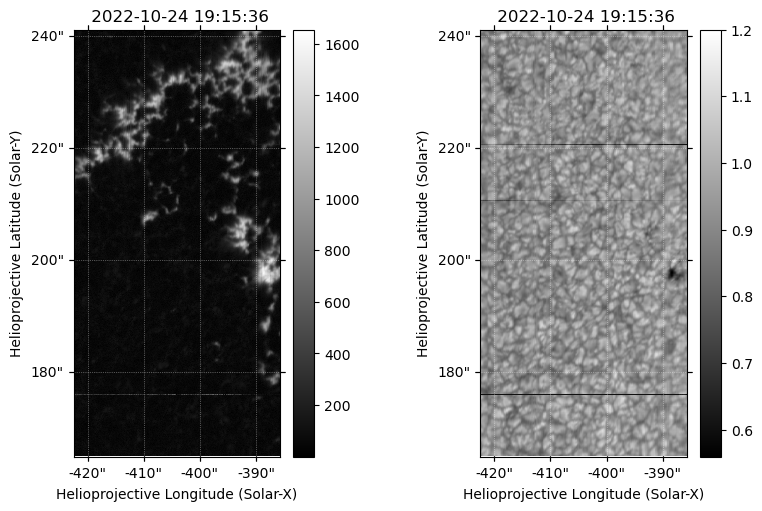

In [235]:
fig = plt.figure(figsize=(8,5),constrained_layout=True)

ax1 = plt.subplot(121,projection=dkist_fitv_tom_btot_map)
im1 = dkist_fitv_tom_btot_map.plot()
plt.colorbar(im1,shrink=1)

ax2 = plt.subplot(122,projection=dkist_fitv_tom_cont_int_map)
im2 = dkist_fitv_tom_cont_int_map.plot()
plt.colorbar(im2,shrink=1)

In [236]:
visp_resample_nx = (dkist_fitv_tom_btot_map.scale.axis1 * dkist_fitv_tom_btot_map.dimensions.x).to(u.arcsec) / aia_1600_map_crop_resample.scale.axis1
visp_resample_ny = (dkist_fitv_tom_btot_map.scale.axis2 * dkist_fitv_tom_btot_map.dimensions.y).to(u.arcsec) / aia_1600_map_crop_resample.scale.axis2
dkist_fitv_tom_btot_map_resample = dkist_fitv_tom_btot_map.resample(u.Quantity([visp_resample_nx, visp_resample_ny]))

Txshift_visp_aia, Tyshift_visp_aia = coalign_shift(aia_1600_map_crop_resample,dkist_fitv_tom_btot_map_resample)
print(Txshift_visp_aia, Tyshift_visp_aia)

0.946923 arcsec -0.0639565 arcsec


In [237]:
dkist_fitv_tom_btot_map_shift = dkist_fitv_tom_btot_map.shift_reference_coord(Txshift_visp_aia,Tyshift_visp_aia)
dkist_fitv_tom_cont_int_map_shift = dkist_fitv_tom_cont_int_map.shift_reference_coord(Txshift_visp_aia,Tyshift_visp_aia)

In [238]:
aia_1600_crop_to_visp = aia_1600_map_crop.submap(dkist_fitv_tom_btot_map_shift.bottom_left_coord,
                                                 top_right=dkist_fitv_tom_btot_map_shift.top_right_coord)

aia_193_crop_to_visp = aia_193_map_crop.submap(dkist_fitv_tom_btot_map_shift.bottom_left_coord,
                                                    top_right=dkist_fitv_tom_btot_map_shift.top_right_coord)

aia_171_crop_to_visp = aia_171_map_crop.submap(dkist_fitv_tom_btot_map_shift.bottom_left_coord,
                                                    top_right=dkist_fitv_tom_btot_map_shift.top_right_coord)

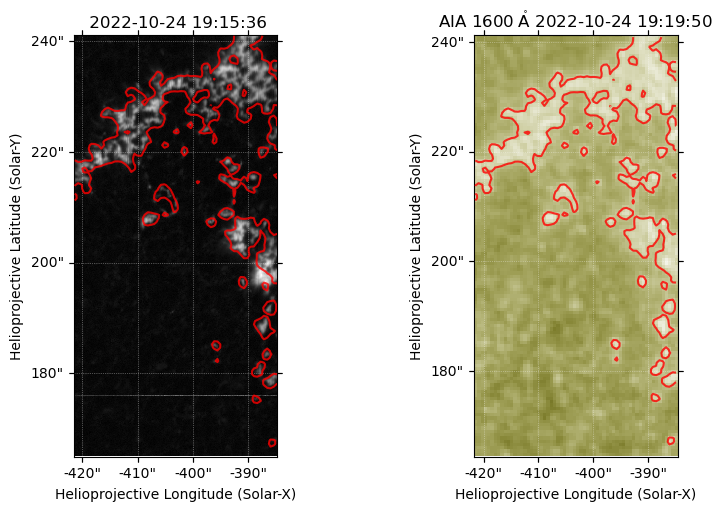

In [239]:
fig = plt.figure(figsize=(8,5),constrained_layout=True)

ax1 = plt.subplot(121,projection=dkist_fitv_tom_btot_map_shift)
im1 = dkist_fitv_tom_btot_map_shift.plot()

ax2 = plt.subplot(122,projection=aia_1600_crop_to_visp)
im2 = aia_1600_crop_to_visp.plot()

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_1600_crop_to_visp.draw_contours(levels=[120]*aia_1600_crop_to_visp.unit,colors=["r"],axes=ax_,alpha=0.8)
    ax_.axis(bounds)

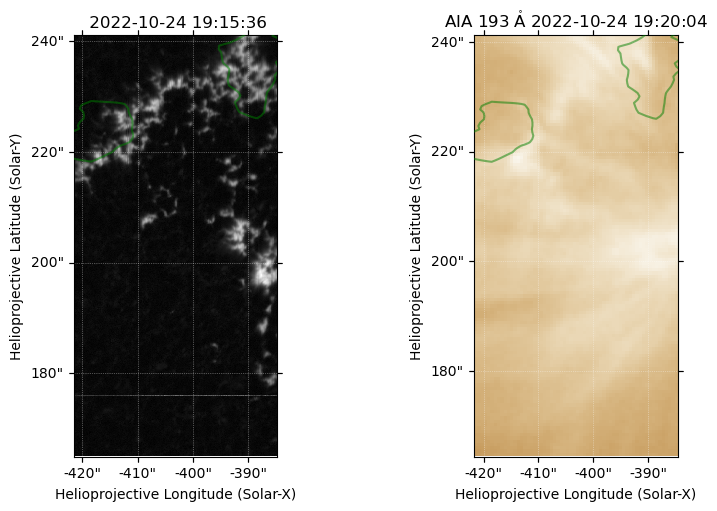

In [240]:
fig = plt.figure(figsize=(8,5),constrained_layout=True)

ax1 = plt.subplot(121,projection=dkist_fitv_tom_btot_map_shift)
im1 = dkist_fitv_tom_btot_map_shift.plot()

ax2 = plt.subplot(122,projection=aia_193_crop_to_visp)
im2 = aia_193_crop_to_visp.plot()

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    eis_hhflare_195_velmap_derot.draw_contours([-10,-5],colors=["purple","green"], axes=ax_, alpha=0.5)
    ax_.axis(bounds)

In [241]:
dkist_fitv_tom_theta_map_shifted = sunpy.map.Map(dkist_fitv_tom_theta.T,WCS(dkist_visp_wcs_tom)).shift_reference_coord(Txshift_visp_aia,Tyshift_visp_aia)
dkist_fitv_tom_azimuth_map_shifted = sunpy.map.Map(dkist_fitv_tom_azimuth.T,WCS(dkist_visp_wcs_tom)).shift_reference_coord(Txshift_visp_aia,Tyshift_visp_aia)
dkist_fitv_tom_DoppVel_map_shifted = sunpy.map.Map(dkist_fitv_tom_DoppVel.T,WCS(dkist_visp_wcs_tom)).shift_reference_coord(Txshift_visp_aia,Tyshift_visp_aia)

In [242]:
dkist_fitv_tom_btot_map_shift.plot_settings['cmap'] = "plasma"
dkist_fitv_tom_btot_map_shift.plot_settings['norm'] = ImageNormalize(vmin=0,vmax=2e3,stretch=PowerStretch(0.5))
dkist_fitv_tom_theta_map_shifted.plot_settings['cmap'] = "twilight_shifted"
dkist_fitv_tom_theta_map_shifted.plot_settings['norm'] = ImageNormalize(vmin=0,vmax=180,stretch=PowerStretch(0.9))
dkist_fitv_tom_theta_map_shifted.plot_settings['aspect'] = dkist_fitv_tom_theta_map_shifted.scale.axis2/dkist_fitv_tom_theta_map_shifted.scale.axis1
dkist_fitv_tom_azimuth_map_shifted.plot_settings['cmap'] = "twilight"
dkist_fitv_tom_azimuth_map_shifted.plot_settings['norm'] = ImageNormalize(vmin=0,vmax=180,stretch=LinearStretch())
dkist_fitv_tom_azimuth_map_shifted.plot_settings['aspect'] = dkist_fitv_tom_azimuth_map_shifted.scale.axis2/dkist_fitv_tom_azimuth_map_shifted.scale.axis1
dkist_fitv_tom_DoppVel_map_shifted.plot_settings['cmap'] = "RdBu"
dkist_fitv_tom_DoppVel_map_shifted.plot_settings['norm'] = ImageNormalize(vmin=-2.5,vmax=2.5,stretch=LinearStretch())
dkist_fitv_tom_DoppVel_map_shifted.plot_settings['aspect'] = dkist_fitv_tom_DoppVel_map_shifted.scale.axis2/dkist_fitv_tom_DoppVel_map_shifted.scale.axis1
dkist_fitv_tom_cont_int_map_shift.plot_settings["cmap"] = "irissji2796"
dkist_fitv_tom_cont_int_map_shift.plot_settings['norm'] = ImageNormalize(vmin=0.6,vmax=1.05,stretch=LinearStretch())

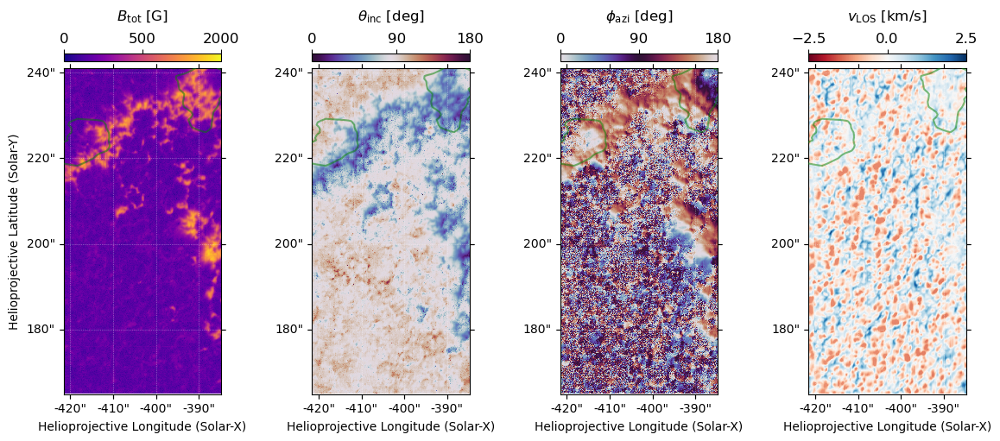

In [243]:
fig = plt.figure(figsize=(11.5,5),constrained_layout=True)

ax1 = plt.subplot(141,projection=dkist_fitv_tom_btot_map_shift)
im1 = dkist_fitv_tom_btot_map_shift.plot()
clb1, clb_ax1 = plot_colorbar(im1,ax1,width="100%",height="8%",fontsize=12,
              bbox_to_anchor=(0,1.02,1,0.3),
              orientation="horizontal")

clb_ax1.tick_params(top=True,labeltop=True,labelbottom=False,bottom=False,labelsize=12)
clb_ax1.set_xticks([0,500,2000])

ax1.set_title(r"$B_{\rm tot}$ [G]",fontsize=12,pad=40)

ax2 = plt.subplot(142,projection=dkist_fitv_tom_theta_map_shifted)
im2 = dkist_fitv_tom_theta_map_shifted.plot()
clb2, clb_ax2 = plot_colorbar(im2,ax2,width="100%",height="8%",fontsize=12,
              bbox_to_anchor=(0,1.02,1,0.3),
              orientation="horizontal")
clb_ax2.tick_params(top=True,labeltop=True,labelbottom=False,bottom=False,labelsize=12)
clb_ax2.set_xticks([0,90,180])
ax2.set_title(r"$\theta_{\rm inc}$ [deg]",fontsize=12,pad=40)

ax3 = plt.subplot(143,projection=dkist_fitv_tom_azimuth_map_shifted)
im3 = dkist_fitv_tom_azimuth_map_shifted.plot()
clb3, clb_ax3 = plot_colorbar(im3,ax3,width="100%",height="8%",fontsize=12,
              bbox_to_anchor=(0,1.02,1,0.3),
              orientation="horizontal")
clb_ax3.tick_params(top=True,labeltop=True,labelbottom=False,bottom=False,labelsize=12)
clb_ax3.set_xticks([0,90,180])
ax3.set_title(r"$\phi_{\rm azi}$ [deg]",fontsize=12,pad=40)

ax4 = plt.subplot(144,projection=dkist_fitv_tom_DoppVel_map_shifted)
im4 = dkist_fitv_tom_DoppVel_map_shifted.plot()
clb4, clb_ax4 = plot_colorbar(im4,ax4,width="100%",height="8%",fontsize=12,
              bbox_to_anchor=(0,1.02,1,0.3),
              orientation="horizontal")
clb_ax4.tick_params(top=True,labeltop=True,labelbottom=False,bottom=False,labelsize=12)
clb_ax4.set_xticks([-2.5,0,2.5])
ax4.set_title(r"$v_{\rm LOS}$ [km/s]",fontsize=12,pad=40)

for ax_ in (ax2,ax3,ax4):
    ax_.set_ylabel(' ')

for ax_ in (ax1,ax2,ax3,ax4):
    bounds = ax_.axis()
    eis_hhflare_195_velmap_derot.draw_contours([-10,-5],colors=["purple","green"], axes=ax_, alpha=0.5)
    ax_.axis(bounds)


In [244]:
with h5py.File("../../src/DKIST/BKEWK/inverted/maxp_mask.h5","r") as file:
    visp_maxp = file["maxp"][:] 
visp_maxp_mask = visp_maxp < 0.005

In [245]:
dkist_fitv_tom_azimuth_map_shifted_masked = sunpy.map.Map(dkist_fitv_tom_azimuth_map_shifted.data,dkist_fitv_tom_azimuth_map_shifted.meta,
                                                          mask=visp_maxp_mask.T)
dkist_fitv_tom_azimuth_map_shifted_masked.plot_settings['cmap'] = "twilight"
dkist_fitv_tom_azimuth_map_shifted_masked.plot_settings['norm'] = ImageNormalize(vmin=0,vmax=180,stretch=LinearStretch())
dkist_fitv_tom_azimuth_map_shifted_masked.plot_settings['aspect'] = dkist_fitv_tom_azimuth_map_shifted_masked.scale.axis2/dkist_fitv_tom_azimuth_map_shifted_masked.scale.axis1

dkist_ftiv_tom_theta_map_shifted_masked = sunpy.map.Map(dkist_fitv_tom_theta_map_shifted.data,dkist_fitv_tom_theta_map_shifted.meta,
                                                         mask=visp_maxp_mask.T)
dkist_ftiv_tom_theta_map_shifted_masked.plot_settings['cmap'] = "twilight_shifted"
dkist_ftiv_tom_theta_map_shifted_masked.plot_settings['norm'] = ImageNormalize(vmin=0,vmax=180)
dkist_ftiv_tom_theta_map_shifted_masked.plot_settings['aspect'] = dkist_ftiv_tom_theta_map_shifted_masked.scale.axis2/dkist_ftiv_tom_theta_map_shifted_masked.scale.axis1

In [246]:
dkist_cont_int_map_shift_crop_0 = dkist_fitv_tom_cont_int_map_shift.submap(SkyCoord(-400*u.arcsec,230*u.arcsec,
                                                                                    frame=dkist_fitv_tom_cont_int_map_shift.coordinate_frame),
                                                                          top_right=dkist_fitv_tom_cont_int_map_shift.top_right_coord)
dkist_btot_map_shift_crop_0 = dkist_fitv_tom_btot_map_shift.submap(SkyCoord(-400*u.arcsec,230*u.arcsec,
                                                                                    frame=dkist_fitv_tom_btot_map_shift.coordinate_frame),
                                                                          top_right=dkist_fitv_tom_btot_map_shift.top_right_coord)
dkist_azimuth_map_shift_crop_0 = dkist_fitv_tom_azimuth_map_shifted_masked.submap(SkyCoord(-400*u.arcsec,230*u.arcsec,
                                                                                    frame=dkist_fitv_tom_azimuth_map_shifted_masked.coordinate_frame),
                                                                            top_right=dkist_fitv_tom_azimuth_map_shifted_masked.top_right_coord)
dkist_theta_map_shift_crop_0 = dkist_ftiv_tom_theta_map_shifted_masked.submap(SkyCoord(-400*u.arcsec,230*u.arcsec,
                                                                                    frame=dkist_ftiv_tom_theta_map_shifted_masked.coordinate_frame),
                                                                            top_right=dkist_ftiv_tom_theta_map_shifted_masked.top_right_coord)
dkist_DoppVel_map_shift_crop_0 = dkist_fitv_tom_DoppVel_map_shifted.submap(SkyCoord(-400*u.arcsec,230*u.arcsec,
                                                                                    frame=dkist_fitv_tom_DoppVel_map_shifted.coordinate_frame),
                                                                            top_right=dkist_fitv_tom_DoppVel_map_shifted.top_right_coord)

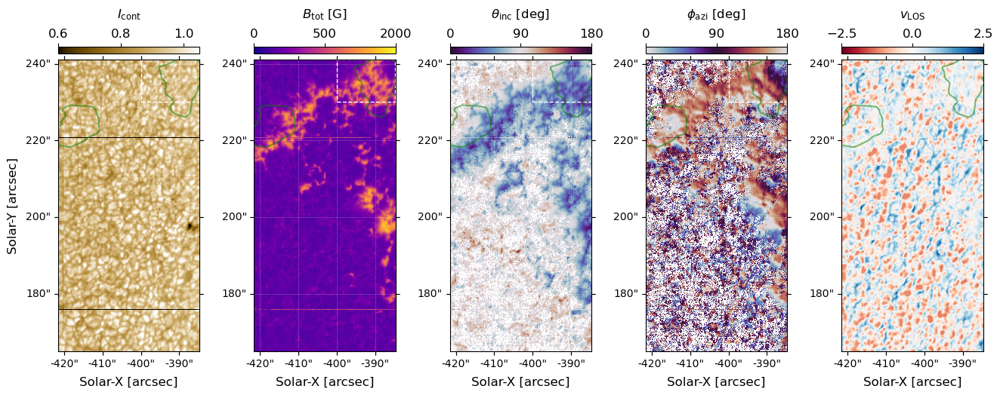

In [247]:
fig = plt.figure(figsize=(13,7),constrained_layout=True)

ax1 = plt.subplot(151,projection=dkist_fitv_tom_cont_int_map_shift)
im1 = dkist_fitv_tom_cont_int_map_shift.plot()
clb1, clb_ax1 = plot_colorbar(im1,ax1,width="100%",height="8%",fontsize=12,
              bbox_to_anchor=(0,1.02,1,0.3),
              orientation="horizontal")
clb_ax1.tick_params(top=True,labeltop=True,labelbottom=False,bottom=False,labelsize=12)
clb_ax1.set_xticks([0.6,0.8,1])
ax1.set_title(r"$I_{\rm cont}$",fontsize=12,pad=40)

ax2 = plt.subplot(152,projection=dkist_fitv_tom_btot_map_shift)
im2 = dkist_fitv_tom_btot_map_shift.plot()
clb2, clb_ax2 = plot_colorbar(im2,ax2,width="100%",height="8%",fontsize=12,
              bbox_to_anchor=(0,1.02,1,0.3),
              orientation="horizontal")
clb_ax2.tick_params(top=True,labeltop=True,labelbottom=False,bottom=False,labelsize=12)
clb_ax2.set_xticks([0,500,2000])
ax2.set_title(r"$B_{\rm tot}$ [G]",fontsize=12,pad=40)

ax3 = plt.subplot(153,projection=dkist_ftiv_tom_theta_map_shifted_masked)
im3 = dkist_ftiv_tom_theta_map_shifted_masked.plot()
clb3, clb_ax3 = plot_colorbar(im3,ax3,width="100%",height="8%",fontsize=12,
              bbox_to_anchor=(0,1.02,1,0.3),
              orientation="horizontal")
clb_ax3.tick_params(top=True,labeltop=True,labelbottom=False,bottom=False,labelsize=12)
clb_ax3.set_xticks([0,90,180])
ax3.set_title(r"$\theta_{\rm inc}$ [deg]",fontsize=12,pad=40)

ax4 = plt.subplot(154,projection=dkist_fitv_tom_azimuth_map_shifted_masked)
im4 = dkist_fitv_tom_azimuth_map_shifted_masked.plot()
clb4, clb_ax4 = plot_colorbar(im4,ax4,width="100%",height="8%",fontsize=12,
              bbox_to_anchor=(0,1.02,1,0.3),
              orientation="horizontal")
clb_ax4.tick_params(top=True,labeltop=True,labelbottom=False,bottom=False,labelsize=12)
clb_ax4.set_xticks([0,90,180])
ax4.set_title(r"$\phi_{\rm azi}$ [deg]",fontsize=12,pad=40)

ax5 = plt.subplot(155,projection=dkist_fitv_tom_DoppVel_map_shifted)
im5 = dkist_fitv_tom_DoppVel_map_shifted.plot()
clb5, clb_ax5 = plot_colorbar(im5,ax5,width="100%",height="8%",fontsize=12,
              bbox_to_anchor=(0,1.02,1,0.3),
              orientation="horizontal")
clb_ax5.tick_params(top=True,labeltop=True,labelbottom=False,bottom=False,labelsize=12)
clb_ax5.set_xticks([-2.5,0,2.5])
ax5.set_title(r"$v_{\rm LOS}$",fontsize=12,pad=40)

for ax_ in (ax2,ax3,ax4,ax5):
    ax_.set_ylabel(' ')
ax1.set_ylabel(r'Solar-Y [arcsec]',fontsize=12)

for ax_ in (ax1,ax2,ax3,ax4,ax5):
    dkist_cont_int_map_shift_crop_0.draw_quadrangle(dkist_cont_int_map_shift_crop_0.bottom_left_coord,
        top_right=dkist_cont_int_map_shift_crop_0.top_right_coord,label='ViSP crop',
        edgecolor="white",lw=1,alpha=1,axes=ax_,ls="--")
    
    bounds = ax_.axis()
    eis_hhflare_195_velmap_derot.draw_contours([-10,-5],colors=["purple","green"], axes=ax_, alpha=0.5)
    ax_.axis(bounds)
    ax_.set_xlabel(r'Solar-X [arcsec]',fontsize=12)

In [265]:
dkist_fitv_tom_cont_int_map_shift.save("../../src/coalign_map/20221024/dkist_fitv_tom_cont_int_map_shift.fits",overwrite=True)
dkist_fitv_tom_btot_map_shift.save("../../src/coalign_map/20221024/dkist_fitv_tom_btot_map_shift.fits",overwrite=True)
dkist_ftiv_tom_theta_map_shifted_masked.save("../../src/coalign_map/20221024/dkist_fitv_tom_theta_map_shifted_masked.fits",overwrite=True)
dkist_fitv_tom_azimuth_map_shifted_masked.save("../../src/coalign_map/20221024/dkist_fitv_tom_azimuth_map_shifted_masked.fits",overwrite=True)
dkist_fitv_tom_DoppVel_map_shifted.save("../../src/coalign_map/20221024/dkist_fitv_tom_DoppVel_map_shifted.fits",overwrite=True)

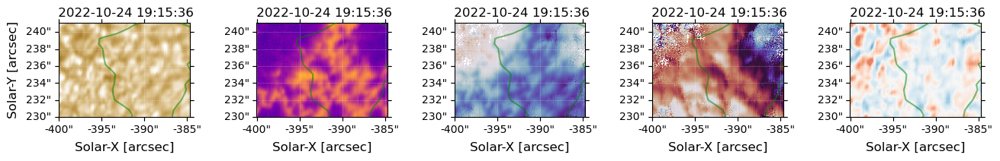

In [248]:
fig = plt.figure(figsize=(13,4),constrained_layout=True)

ax1 = plt.subplot(151,projection=dkist_cont_int_map_shift_crop_0)
im1 = dkist_cont_int_map_shift_crop_0.plot()

ax2 = plt.subplot(152,projection=dkist_btot_map_shift_crop_0)
im2 = dkist_btot_map_shift_crop_0.plot()

ax3 = plt.subplot(153,projection=dkist_theta_map_shift_crop_0)
im3 = dkist_theta_map_shift_crop_0.plot()

ax4 = plt.subplot(154,projection=dkist_azimuth_map_shift_crop_0)
im4 = dkist_azimuth_map_shift_crop_0.plot()

ax5 = plt.subplot(155,projection=dkist_DoppVel_map_shift_crop_0)
im5 = dkist_DoppVel_map_shift_crop_0.plot()

for ax_ in (ax2,ax3,ax4,ax5):
    ax_.set_ylabel(' ')
ax1.set_ylabel(r'Solar-Y [arcsec]',fontsize=12)

for ax_ in (ax1,ax2,ax3,ax4,ax5):
    bounds = ax_.axis()
    eis_hhflare_195_velmap_derot.draw_contours([-10,-5],colors=["purple","green"], axes=ax_, alpha=0.5)
    ax_.axis(bounds)
    ax_.set_xlabel(r'Solar-X [arcsec]',fontsize=12)

In [249]:
vec_sun_dkist = dkist_fitv_tom_cont_int_map_shift.center.transform_to(HeliocentricEarthEcliptic(obstime=dkist_fitv_tom_cont_int_map_shift.date)).cartesian.xyz.to(u.R_sun).value

In [250]:
vec_sun_earth = dkist_fitv_tom_cont_int_map_shift.observer_coordinate.cartesian.xyz.to(u.R_sun).value

In [251]:
vec_dkist_earth = vec_sun_earth - vec_sun_dkist

In [252]:
dkist_mu = np.dot(vec_sun_dkist,vec_dkist_earth) / (np.linalg.norm(vec_sun_dkist) * np.linalg.norm(vec_dkist_earth))
dkist_mu

0.8956253647615611

(-0.5, 2047.5, -0.5, 2047.5)

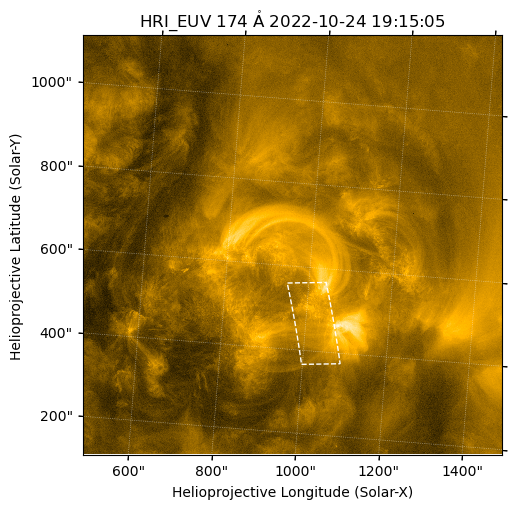

In [253]:
fig = plt.figure(figsize=(5,5),constrained_layout=True)

ax = fig.add_subplot(111,projection=hri_174_map_shifted_toaia)
im = hri_174_map_shifted_toaia.plot()

bounds = ax.axis()
dkist_fitv_tom_btot_map_shift.draw_quadrangle(dkist_fitv_tom_btot_map_shift.bottom_left_coord,
                                              top_right=dkist_fitv_tom_btot_map_shift.top_right_coord,label='ViSP crop',
        edgecolor="white",lw=1,alpha=1,axes=ax,ls="--")
ax.axis(bounds)



In [254]:
dkist_fitv_tom_btot_map_shift.data.shape

(2555, 688)

In [255]:
dkist_repro_wcs = sunpy.map.make_fitswcs_header([2800,1100],
                                                dkist_fitv_tom_btot_map_shift.center.transform_to(hri_174_map_shifted_toaia.coordinate_frame),
                                                scale=u.Quantity(dkist_fitv_tom_btot_map_shift.scale)* \
                                                dkist_fitv_tom_btot_map_shift.observer_coordinate.radius/hri_174_map_shifted_toaia.observer_coordinate.radius,
                                                telescope="DKIST",instrument="ViSP")

In [256]:
dkist_fitv_tom_btot_map_shift_repro = dkist_fitv_tom_btot_map_shift.reproject_to(WCS(dkist_repro_wcs))

In [257]:
hri_174_map_crop_to_visp = hri_174_map_shifted_toaia.rotate().submap(dkist_fitv_tom_btot_map_shift_repro.bottom_left_coord,
                                                            top_right=dkist_fitv_tom_btot_map_shift_repro.top_right_coord)
hri_174_map_repro_to_visp = hri_174_map_crop_to_visp.reproject_to(dkist_fitv_tom_btot_map_shift_repro.wcs)

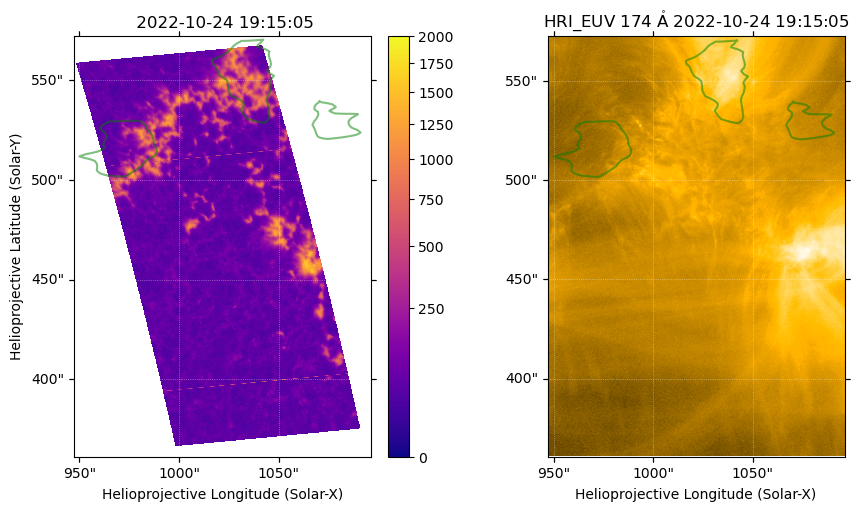

In [258]:
fig = plt.figure(figsize=(9,5),constrained_layout=True)

ax1 = plt.subplot(121,projection=dkist_fitv_tom_btot_map_shift_repro)
im1 = dkist_fitv_tom_btot_map_shift_repro.plot()
plt.colorbar(im1,shrink=1)

ax2 = plt.subplot(122,projection=hri_174_map_crop_to_visp)
im2 = hri_174_map_crop_to_visp.plot()
ax2.set_ylabel(' ')

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    eis_hhflare_195_velmap_derot.draw_contours([-10,-5],colors=["purple","green"], axes=ax_, alpha=0.5)
    ax_.axis(bounds)

In [259]:
SunBlinker(dkist_fitv_tom_btot_map_shift_repro,hri_174_map_repro_to_visp)
